In [ ]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

FOLDERNAME = 'NeRF-NTUE-project'
assert FOLDERNAME is not None, "[!] Enter the foldername."

import sys
sys.path.append('/content/drive/My Drive/{}'.format(FOLDERNAME))

In [1]:
import os
import numpy as np
import torch
from torch import nn
import matplotlib.pyplot as plt
from tqdm import trange

from model import *
from rays_util import *
from render import *

In [2]:
if not os.path.exists('tiny_nerf_data.npz'):
  !wget http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz --no-check-certificate

--2024-05-03 03:22:33--  http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Resolving cseweb.ucsd.edu (cseweb.ucsd.edu)... 132.239.8.30
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz [following]
--2024-05-03 03:22:33--  https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:443... connected.
  Unable to locally verify the issuer's authority.
HTTP request sent, awaiting response... 200 OK
Length: 12727482 (12M)
Saving to: ‘tiny_nerf_data.npz’

tiny_nerf_data.npz  100%[===================>]  12.14M  1.91MB/s    in 6.2s    

2024-05-03 03:22:39 (1.96 MB/s) - ‘tiny_nerf_data.npz’ saved [12727482/12727482]



Images shape: (106, 100, 100, 3)
Poses shape: (106, 4, 4)
Focal: 138.88887889922103
Pose
[[ 9.9999994e-01 -4.8568938e-07  9.2086310e-07  3.7121181e-06]
 [ 1.0410970e-06  4.6651685e-01 -8.8451219e-01 -3.5655830e+00]
 [ 2.8421709e-14  8.8451225e-01  4.6651685e-01  1.8805897e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  1.0000000e+00]]


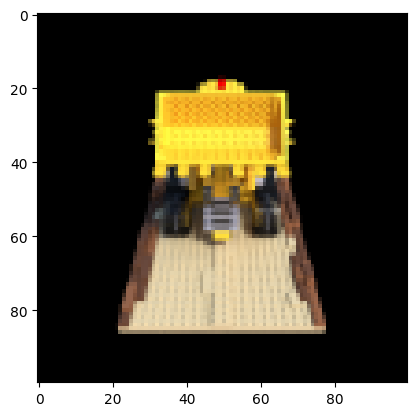

In [3]:
data = np.load('tiny_nerf_data.npz')
images = data['images']
poses = data['poses']
focal = data['focal']

print(f'Images shape: {images.shape}')
print(f'Poses shape: {poses.shape}')
print(f'Focal: {focal}')

height, width = images.shape[1:3]
near, far = 2., 6.

n_training = 100
testimg_idx = 103
testimg, testpose = images[testimg_idx], poses[testimg_idx]

plt.imshow(testimg)
print('Pose')
print(testpose)

In [4]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# To torch tensors
images = torch.from_numpy(data['images'][:n_training]).to(device)
poses = torch.from_numpy(data['poses']).to(device)
focal = torch.from_numpy(data['focal']).to(device)
testimg = torch.from_numpy(data['images'][testimg_idx]).to(device)
testpose = torch.from_numpy(data['poses'][testimg_idx]).to(device)

In [16]:
# Foe forward Passing

def chunkify(
  inputs: torch.Tensor,
  chunksize: int = 2**15
):
  """
  Divide input into chunks.
  Return: List(torch.Tensor)
  """
  return [inputs[i:i+chunksize] for i in range(0, inputs.shape[0], chunksize)]

def batchify_points(
  points: torch.Tensor,
  encoding_function: torch.Tensor,
  chunksize: int = 2**15
):
  """
  Encode and chunkify "points" to prepare for NeRF model.
  Return: List[torch.Tensor]
  """
  points = points.reshape((-1, 3))
  points = encoding_function(points)
  points = chunkify(points, chunksize=chunksize)
  return points

def batchify_viewdirs(
  points: torch.Tensor,
  rays_d: torch.Tensor,
  encoding_function: torch.Tensor,
  chunksize: int = 2**15
):
  """
  Encode and chunkify "viewdirs" to prepare for NeRF model.
  Return: List[torch.Tensor]
  """
  viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
  viewdirs_flat = viewdirs[:, None, ...].expand(points.shape).reshape((-1, 3))
  embedded_viewdirs = encoding_function(viewdirs_flat)
  viewdirs = chunkify(embedded_viewdirs, chunksize=chunksize)
  return viewdirs

In [17]:
def nerf_forward(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  encoding_fn: torch.Tensor,
  coarse_model: nn.Module,
  fine_model = None,
  stratified_sampling_kwargs: dict = None,
  N_importance: int = 0,
  hierarchical_sampling_kwargs: dict = None,
  viewdirs_encoding_fn: torch.Tensor = None,
  chunksize: int = 2**15
):
  """
  True full forward pass through all function and models
  Return: Tuple[torch.Tensor, torch.Tensor, torch.Tensor, dict]
  """

  # Set no kwargs if none are given.
  if stratified_sampling_kwargs is None:
    stratified_sampling_kwargs = {}
  if hierarchical_sampling_kwargs is None:
    hierarchical_sampling_kwargs = {}

  # Strtified sampling(stage 1) for coarse query points.
  sample_pts, z_vals = sample_stratified(rays_o, rays_d, near, far, **stratified_sampling_kwargs)

  # Prepare batches.
  batches = batchify_points(sample_pts, encoding_fn, chunksize=chunksize)
  if viewdirs_encoding_fn is not None:
    batches_viewdirs = batchify_viewdirs(sample_pts, rays_d,
                                               viewdirs_encoding_fn,
                                               chunksize=chunksize)
  else:
    batches_viewdirs = [None] * len(batches)

  # Coarse model pass.
  # Split the encoded points into "chunks", run the model on all chunks
  # and concatenate the results (avoid OOM).
  predictions = []
  for batch, batch_viewdirs in zip(batches, batches_viewdirs):
    predictions.append(coarse_model(batch, viewdirs=batch_viewdirs))
  raw = torch.cat(predictions, dim=0)
  raw = raw.reshape(list(sample_pts.shape[:2]) + [raw.shape[-1]])

  # Volume rendering
  rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals, rays_d)
  outputs = {
      'z_vals_stratified': z_vals
  }

  # Fine model pass.
  if N_importance > 0:
    # Save previous outputs to return.
    rgb_map_0, depth_map_0, acc_map_0 = rgb_map, depth_map, acc_map

    # Apply hierarchical sampling(stage 2) for fine query points.
    sample_pts, z_vals_combined, z_hierarch = sample_hierarchical(
      rays_o, rays_d, z_vals, weights, N_importance,
      **hierarchical_sampling_kwargs)

    # Prepare batches.
    batches = batchify_points(sample_pts, encoding_fn, chunksize=chunksize)
    if viewdirs_encoding_fn is not None:
      batches_viewdirs = batchify_viewdirs(sample_pts, rays_d,
                                                 viewdirs_encoding_fn,
                                                 chunksize=chunksize)
    else:
      batches_viewdirs = [None] * len(batches)

    # Forward pass new samples through fine model.
    fine_model = fine_model if fine_model is not None else coarse_model
    predictions = []
    for batch, batch_viewdirs in zip(batches, batches_viewdirs):
      predictions.append(fine_model(batch, viewdirs=batch_viewdirs))
    raw = torch.cat(predictions, dim=0)
    raw = raw.reshape(list(sample_pts.shape[:2]) + [raw.shape[-1]])

    # Volume rendering
    rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals_combined, rays_d)

    # Store outputs.
    outputs['z_vals_hierarchical'] = z_hierarch
    outputs['rgb_map_0'] = rgb_map_0
    outputs['depth_map_0'] = depth_map_0
    outputs['acc_map_0'] = acc_map_0

  # Store outputs.
  outputs['rgb_map'] = rgb_map
  outputs['depth_map'] = depth_map
  outputs['acc_map'] = acc_map
  outputs['weights'] = weights
  return outputs

In [18]:
"""
Hyperparameters
"""

# Model
d_filter = 128          # Dimensions of linear layer filters
n_layers = 2            # Number of layers in network bottleneck
skip = []               # Layers at which to apply input residual
use_fine_model = True   # If set, creates a fine model
d_filter_fine = 128     # Dimensions of linear layer filters of fine network
n_layers_fine = 6       # Number of layers in fine network bottleneck

# Stratified sampling
n_samples = 64         # Number of spatial samples per ray
perturb = True         # If set, applies noise to sample positions
inverse_depth = False  # If set, samples points linearly in inverse depth

# Hierarchical sampling
N_importance = 64   # Number of samples per ray
perturb_hierarchical = False  # If set, applies noise to sample positions

# Encoder
d_input = 3           # Number of input dimensions
n_freqs = 10          # Number of encoding functions for samples
log_sampling = True      # If set, frequencies scale in log space
use_viewdirs = True   # If set, use view direction as input
n_freqs_views = 4     # Number of encoding functions for views

# Optimizer
lr = 5e-4  # Learning rate

# Training
n_iters = 10000
batch_size = 2**14          # Number of rays per gradient step (power of 2)
one_image_per_step = True   # One image per gradient step (disables batching)
chunksize = 2**14           # Modify as needed to fit in GPU memory
center_crop = True          # Crop the center of image (one_image_per_)
center_crop_iters = 50      # Stop cropping center after this many epochs
display_rate = 25          # Display test output every X epochs

# Early Stopping
warmup_iters = 100          # Number of iterations during warmup phase
warmup_min_fitness = 10.0   # Min val PSNR to continue training at warmup_iters
n_restarts = 10             # Number of times to restart if training stalls

# Function kwargs
stratified_sampling_kwargs = {
    'n_samples': n_samples,
    'perturb': perturb,
    'inverse_depth': inverse_depth
}
hierarchical_sampling_kwargs = {
    'perturb': perturb
}

In [19]:
'''
Classes and Functions for training
'''
def crop_center(
  img: torch.Tensor,
  frac: float = 0.5
):
  """
  Crop center square from image for better result.
  Return: torch.Tensor
  """
  h_offset = round(img.shape[0] * (frac / 2))
  w_offset = round(img.shape[1] * (frac / 2))
  return img[h_offset:-h_offset, w_offset:-w_offset]

class EarlyStopping:
  """
  Early stopping helper.
  """
  def __init__(
    self,
    patience: int = 50,
    min_improve: float = 1e-4
  ):
    self.best_fitness = 0.0  # PSNR
    self.best_iter = 0
    self.min_improve = min_improve
    self.patience = patience or float('inf')  # number of epochs to wait if fitness stop improving

  def __call__(
    self,
    iter: int,
    fitness: float
  ):
    """
    Check if criterion for stopping is met.
    Return: Bool
    """
    if (fitness - self.best_fitness) > self.min_improve:
      self.best_iter = iter
      self.best_fitness = fitness
    delta = iter - self.best_iter
    stop = delta >= self.patience  # stop training
    return stop

In [20]:
def init_models():
  """
  Initialize models, encoders, and optimizer for training.
  """
  # Encoders
  encoder = PositionalEncoder(d_input, n_freqs, log_sampling=log_sampling)
  encode = lambda x: encoder(x)

  # View direction encoders
  if use_viewdirs:
    encoder_viewdirs = PositionalEncoder(d_input, n_freqs_views,
                                        log_sampling=log_sampling)
    encode_viewdirs = lambda x: encoder_viewdirs(x)
    d_viewdirs = encoder_viewdirs.d_output
    test_dir = d_viewdirs
  else:
    encode_viewdirs = None
    d_viewdirs = None

  # Models
  model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
              d_viewdirs=d_viewdirs)
  model.to(device)
  model_params = list(model.parameters())
  if use_fine_model:
    fine_model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
                      d_viewdirs=d_viewdirs)
    fine_model.to(device)
    model_params = model_params + list(fine_model.parameters())
  else:
    fine_model = None

  # Optimizer
  optimizer = torch.optim.Adam(model_params, lr=lr)

  # Early Stopping
  warmup_stopper = EarlyStopping(patience=50)

  return model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper

In [30]:
'''
test_dir = torch.tensor
model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper = init_models()
print(model)
print(fine_model)
''''

NeRF(
  (layers): ModuleList(
    (0): Linear(in_features=63, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=128, bias=True)
  )
  (sigma_out): Linear(in_features=128, out_features=1, bias=True)
  (feature_filters): Linear(in_features=128, out_features=128, bias=True)
  (views_linears): Linear(in_features=155, out_features=64, bias=True)
  (output): Linear(in_features=64, out_features=3, bias=True)
)
NeRF(
  (layers): ModuleList(
    (0): Linear(in_features=63, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=128, bias=True)
  )
  (sigma_out): Linear(in_features=128, out_features=1, bias=True)
  (feature_filters): Linear(in_features=128, out_features=128, bias=True)
  (views_linears): Linear(in_features=155, out_features=64, bias=True)
  (output): Linear(in_features=64, out_features=3, bias=True)
)


In [22]:
#Training Loop

def train():
  """
  Launch training.
  """
  # Shuffle rays across all images.
  if not one_image_per_step:
    height, width = images.shape[1:3]
    all_rays = torch.stack([torch.stack(get_rays(height, width, focal, p), dim=0)
                        for p in poses[:n_training]], dim=0)  # [100, 2, 100, 100, 3]
    rays_rgb = torch.cat([all_rays, images[:, None]], 1)  # [100, 3, 100, 100, 3]
    rays_rgb = torch.permute(rays_rgb, [0, 2, 3, 1, 4]) # [100, 100, 100, 3, 3]
    rays_rgb = rays_rgb.reshape([-1, 3, 3]) # [1000000, 3, 3]
    rays_rgb = rays_rgb.type(torch.float32)
    rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
    i_batch = 0

  train_psnrs = []
  val_psnrs = []
  iternums = []
  for i in trange(n_iters):
    model.train()

    if one_image_per_step:
      # Randomly pick an image as target.
      target_img_idx = np.random.randint(images.shape[0])
      target_img = images[target_img_idx].to(device)
      if center_crop and i < center_crop_iters:
        target_img = crop_center(target_img)
      height, width = target_img.shape[:2]
      target_pose = poses[target_img_idx].to(device)
      rays_o, rays_d = get_rays(height, width, focal, target_pose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
    else:
      # Random over all images.
      batch = rays_rgb[i_batch:i_batch + batch_size]
      batch = torch.transpose(batch, 0, 1)  # [3, 2**14, 3]
      rays_o, rays_d, target_img = batch  # [2**14, 3]
      height, width = target_img.shape[:2]
      i_batch += batch_size
      # Shuffle after one epoch
      if i_batch >= rays_rgb.shape[0]:
          rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
          i_batch = 0

    target_img = target_img.reshape([-1, 3])

    # Run one iteration and get the rendered RGB image.
    outputs = nerf_forward(rays_o, rays_d,
                           near, far, encode, model,
                           fine_model=fine_model,
                           stratified_sampling_kwargs=stratified_sampling_kwargs,
                           N_importance=N_importance,
                           hierarchical_sampling_kwargs=hierarchical_sampling_kwargs,
                           viewdirs_encoding_fn=encode_viewdirs,
                           chunksize=chunksize)

    # Check for any numerical issues.
    for k, v in outputs.items():
      if torch.isnan(v).any():
        print(f"! [Numerical Alert] {k} contains NaN.")
      if torch.isinf(v).any():
        print(f"! [Numerical Alert] {k} contains Inf.")

    # Backprop
    rgb_predicted = outputs['rgb_map']
    loss = torch.nn.functional.mse_loss(rgb_predicted, target_img)
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()
    psnr = -10. * torch.log10(loss)
    train_psnrs.append(psnr.item())

    # Evaluate testimg.
    if i % display_rate == 0:
      model.eval()
      height, width = testimg.shape[:2]
      rays_o, rays_d = get_rays(height, width, focal, testpose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
      outputs = nerf_forward(rays_o, rays_d,
                             near, far, encode, model,
                             fine_model=fine_model,
                             stratified_sampling_kwargs=stratified_sampling_kwargs,
                             N_importance=N_importance,
                             hierarchical_sampling_kwargs=hierarchical_sampling_kwargs,
                             viewdirs_encoding_fn=encode_viewdirs,
                             chunksize=chunksize)

      rgb_predicted = outputs['rgb_map']
      loss = torch.nn.functional.mse_loss(rgb_predicted, testimg.reshape(-1, 3))
      print("Loss:", loss.item())
      val_psnr = -10. * torch.log10(loss)
      val_psnrs.append(val_psnr.item())
      iternums.append(i)

      # Plot example outputs
      plt.figure(figsize=(20,4))
      plt.subplot(131)
      plt.imshow(rgb_predicted.reshape([height, width, 3]).detach().cpu().numpy())
      plt.title(f'Iteration: {i}')
      plt.subplot(132)
      plt.imshow(testimg.detach().cpu().numpy())
      plt.title('Target')
      plt.subplot(133)
      plt.plot(range(0, i + 1), train_psnrs, 'r')
      plt.plot(iternums, val_psnrs, 'b')
      plt.title('PSNR (train=red, val=blue)')
      plt.show()

    # Check PSNR for issues and stop if any are found.
    if i == warmup_iters - 1:
      if val_psnr < warmup_min_fitness:
        print(f'Val PSNR {val_psnr} below warmup_min_fitness {warmup_min_fitness}. Stopping...')
        return False, train_psnrs, val_psnrs
    elif i < warmup_iters:
      if warmup_stopper is not None and warmup_stopper(i, psnr):
        print(f'Train PSNR flatlined at {psnr} for {warmup_stopper.patience} iters. Stopping...')
        return False, train_psnrs, val_psnrs

  return True, train_psnrs, val_psnrs

  0%|          | 0/10000 [00:00<?, ?it/s]

Loss: 0.1876051425933838


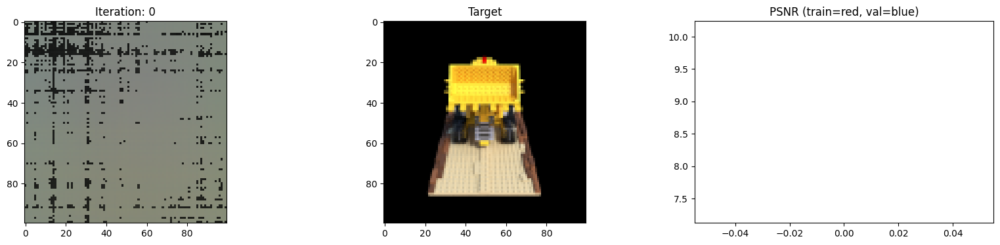

  0%|          | 25/10000 [00:05<18:46,  8.86it/s]

Loss: 0.1387619525194168


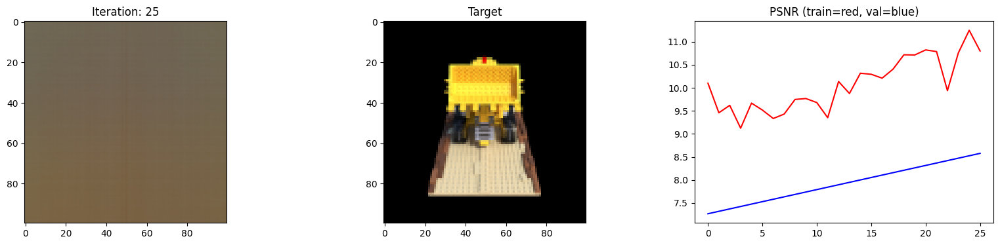

  0%|          | 50/10000 [00:10<23:27,  7.07it/s]

Loss: 0.13009954988956451


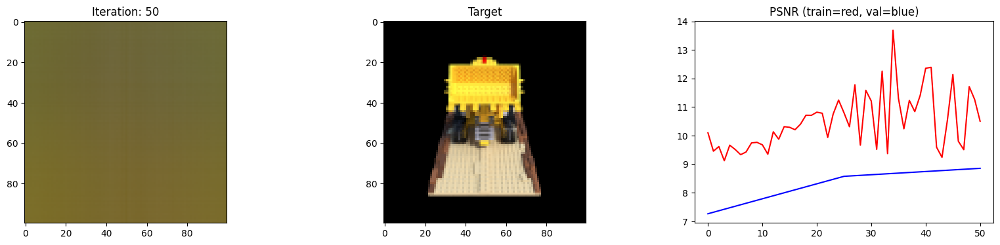

  1%|          | 75/10000 [00:23<1:13:11,  2.26it/s]

Loss: 0.09031422436237335


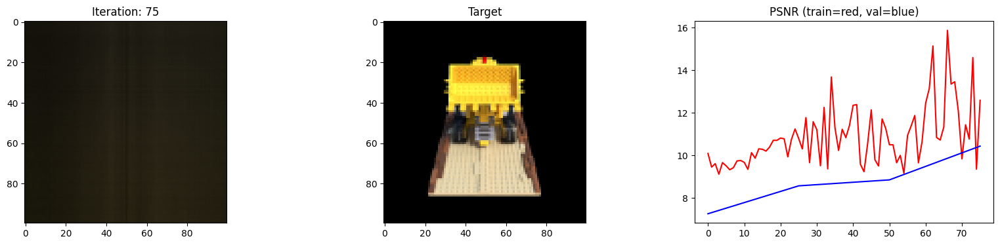

  1%|          | 100/10000 [00:34<1:12:39,  2.27it/s]

Loss: 0.08435696363449097


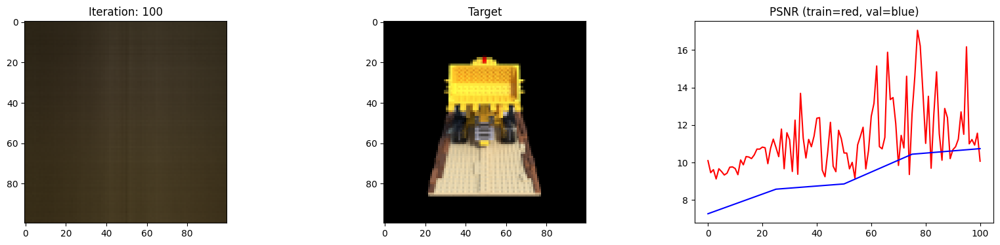

  1%|▏         | 125/10000 [00:46<1:11:41,  2.30it/s]

Loss: 0.08088050782680511


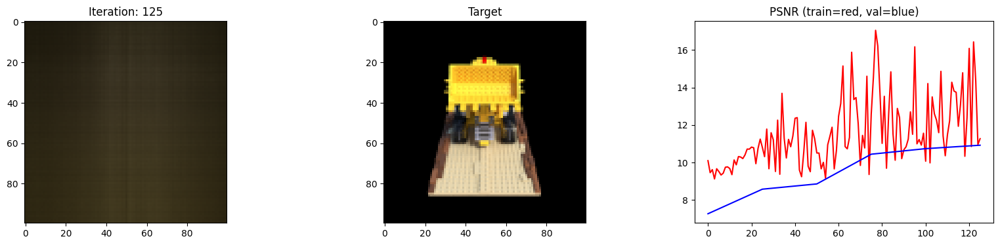

  2%|▏         | 150/10000 [00:58<1:11:12,  2.31it/s]

Loss: 0.07437264174222946


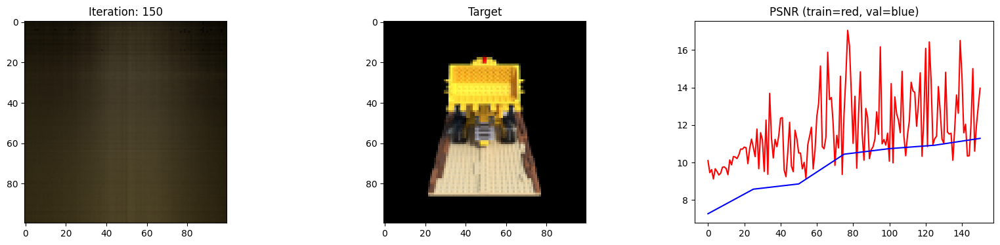

  2%|▏         | 175/10000 [01:09<1:10:44,  2.31it/s]

Loss: 0.06563098728656769


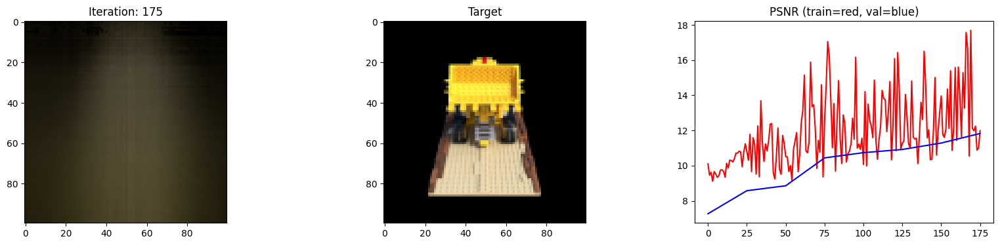

  2%|▏         | 200/10000 [01:21<1:10:22,  2.32it/s]

Loss: 0.05272623524069786


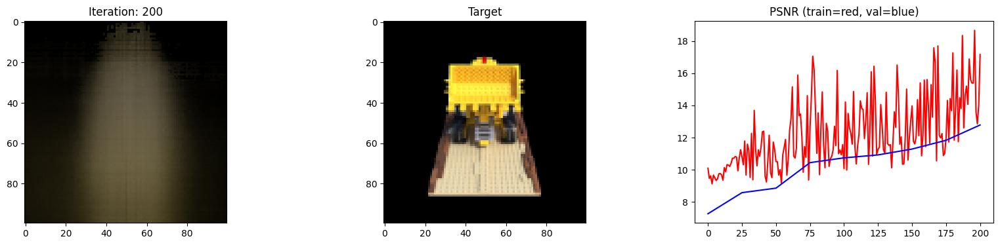

  2%|▏         | 225/10000 [01:33<1:10:38,  2.31it/s]

Loss: 0.040888890624046326


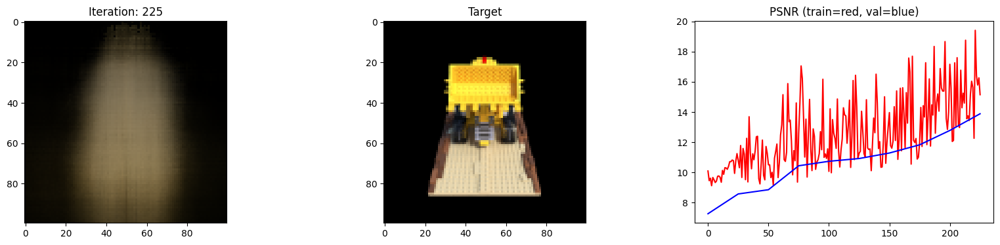

  2%|▎         | 250/10000 [01:44<1:10:48,  2.30it/s]

Loss: 0.032050978392362595


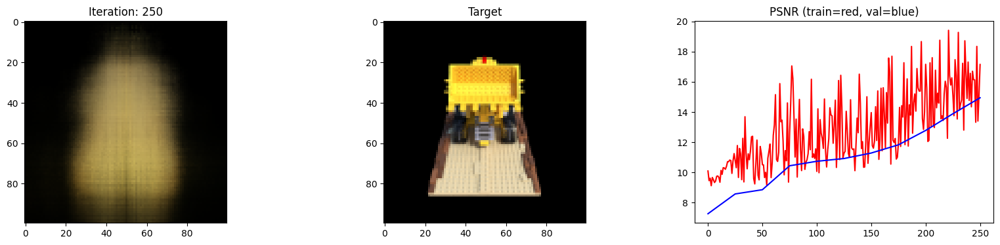

  3%|▎         | 275/10000 [01:56<1:13:20,  2.21it/s]

Loss: 0.027778515592217445


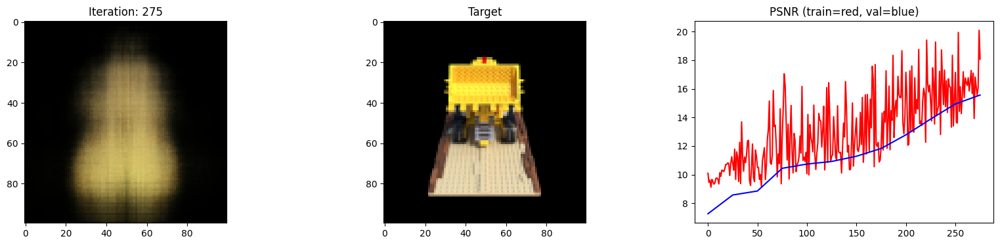

  3%|▎         | 300/10000 [02:08<1:10:12,  2.30it/s]

Loss: 0.023752883076667786


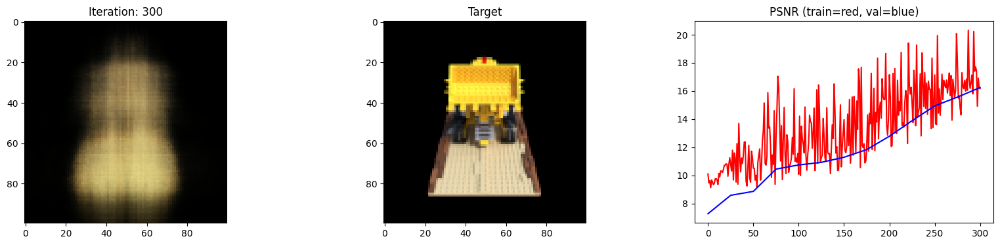

  3%|▎         | 325/10000 [02:19<1:09:53,  2.31it/s]

Loss: 0.020233923569321632


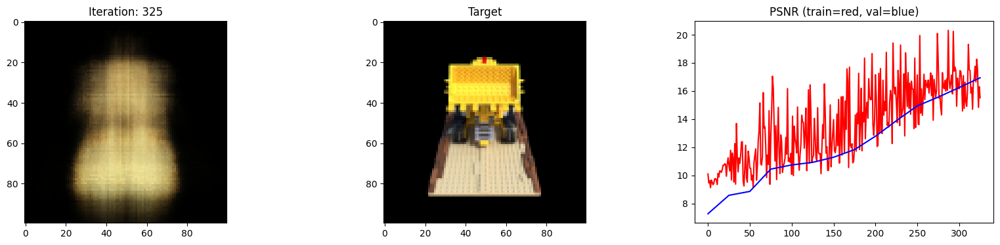

  4%|▎         | 350/10000 [02:31<1:09:50,  2.30it/s]

Loss: 0.0191813837736845


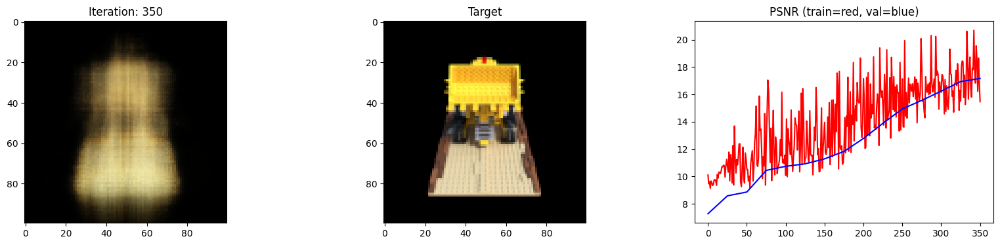

  4%|▍         | 375/10000 [02:43<1:09:45,  2.30it/s]

Loss: 0.019611503928899765


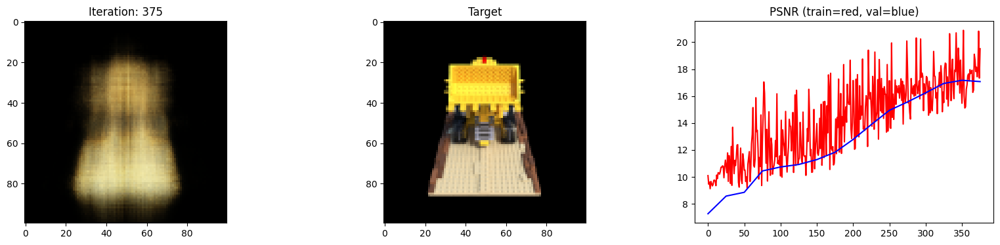

  4%|▍         | 400/10000 [02:54<1:09:27,  2.30it/s]

Loss: 0.015503882430493832


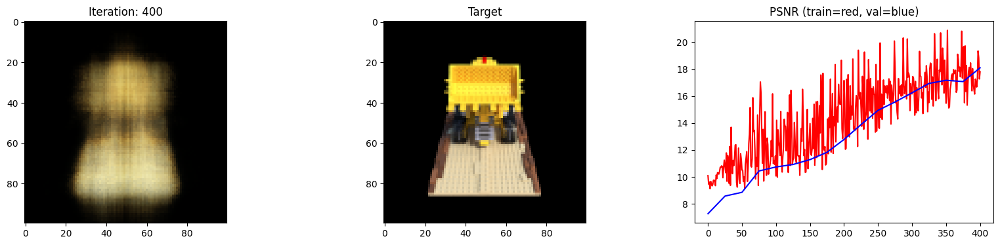

  4%|▍         | 425/10000 [03:06<1:09:17,  2.30it/s]

Loss: 0.015740714967250824


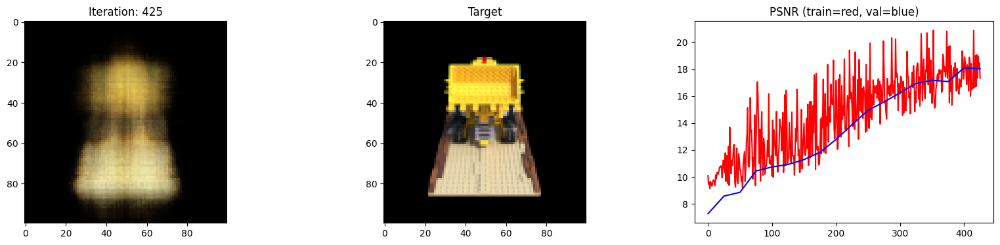

  4%|▍         | 450/10000 [03:17<1:09:09,  2.30it/s]

Loss: 0.014284100383520126


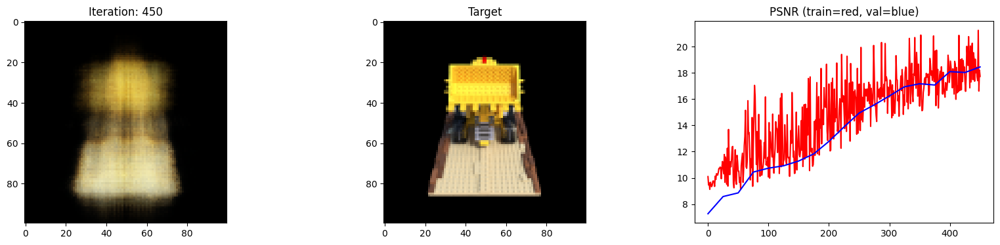

  5%|▍         | 475/10000 [03:29<1:08:51,  2.31it/s]

Loss: 0.015092380344867706


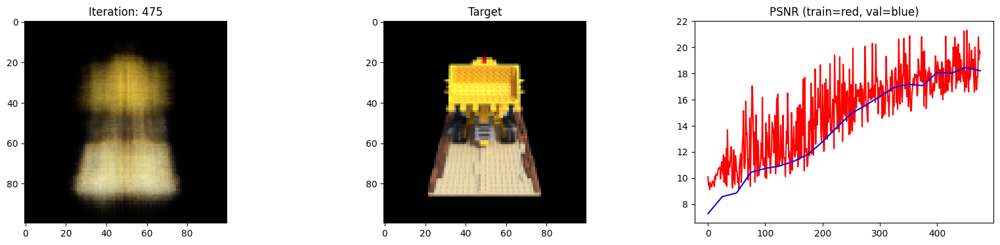

  5%|▌         | 500/10000 [03:41<1:08:48,  2.30it/s]

Loss: 0.014996156096458435


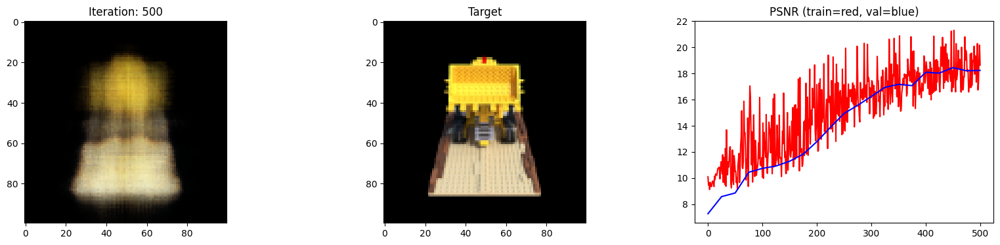

  5%|▌         | 525/10000 [03:52<1:08:39,  2.30it/s]

Loss: 0.013741865754127502


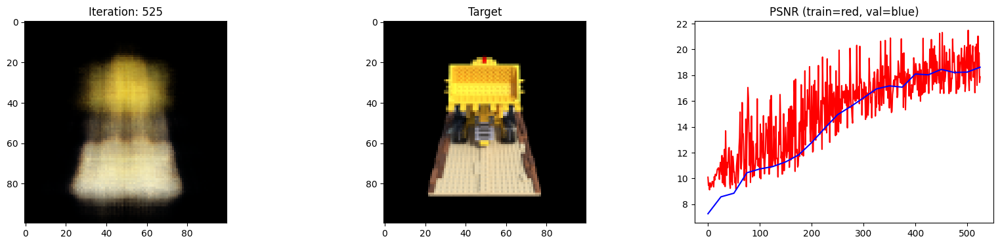

  6%|▌         | 550/10000 [04:04<1:08:15,  2.31it/s]

Loss: 0.011875953525304794


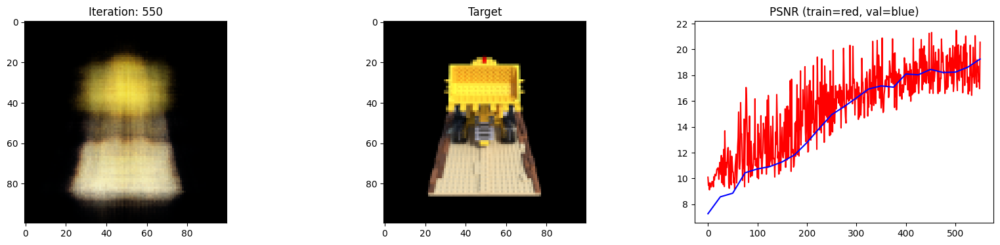

  6%|▌         | 575/10000 [04:16<1:07:56,  2.31it/s]

Loss: 0.012015863321721554


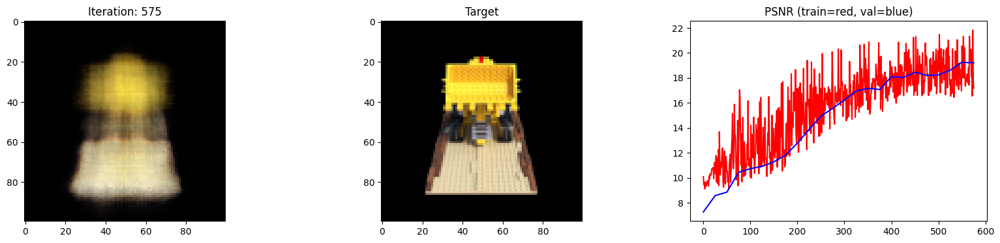

  6%|▌         | 600/10000 [04:28<1:07:50,  2.31it/s]

Loss: 0.011448065750300884


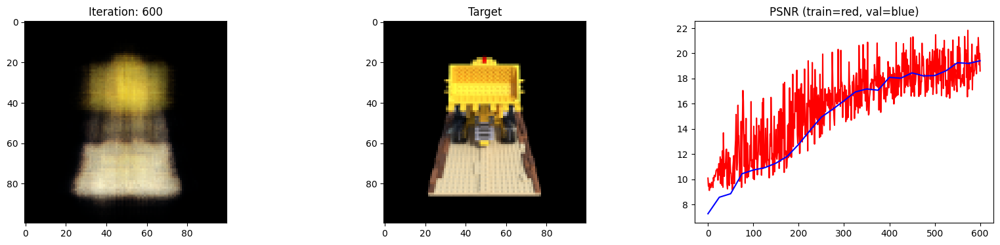

  6%|▋         | 625/10000 [04:39<1:07:28,  2.32it/s]

Loss: 0.010921073146164417


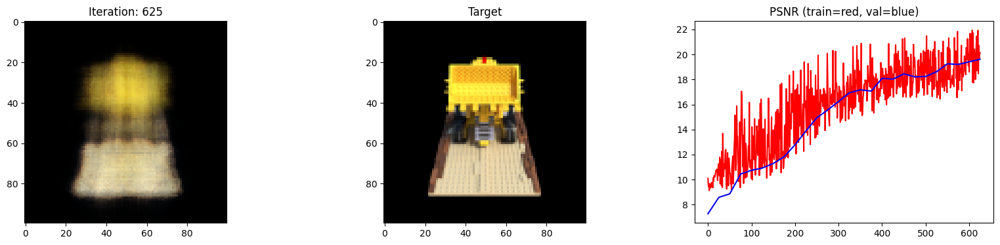

  6%|▋         | 650/10000 [04:51<1:07:14,  2.32it/s]

Loss: 0.010405849665403366


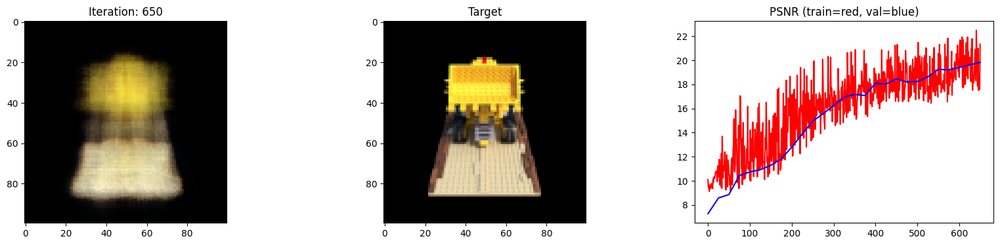

  7%|▋         | 675/10000 [05:03<1:07:20,  2.31it/s]

Loss: 0.008650586009025574


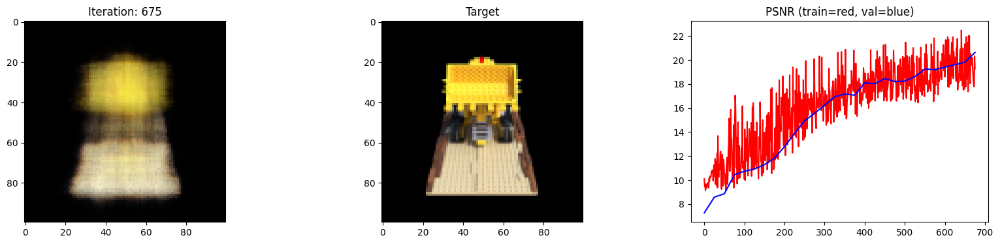

  7%|▋         | 700/10000 [05:14<1:07:04,  2.31it/s]

Loss: 0.009327691979706287


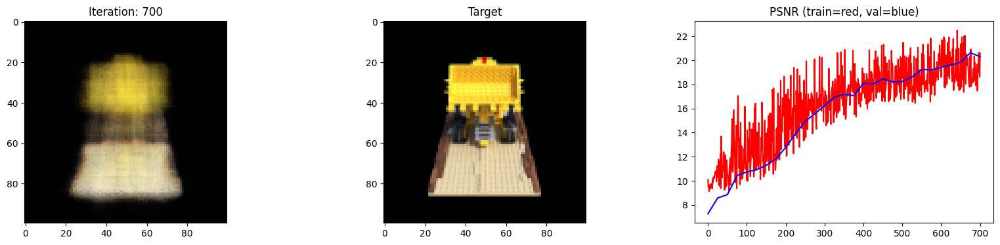

  7%|▋         | 725/10000 [05:26<1:06:50,  2.31it/s]

Loss: 0.010892334394156933


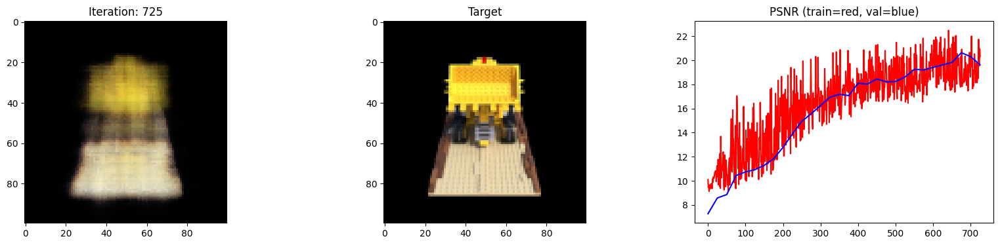

  8%|▊         | 750/10000 [05:37<1:06:35,  2.32it/s]

Loss: 0.009057572111487389


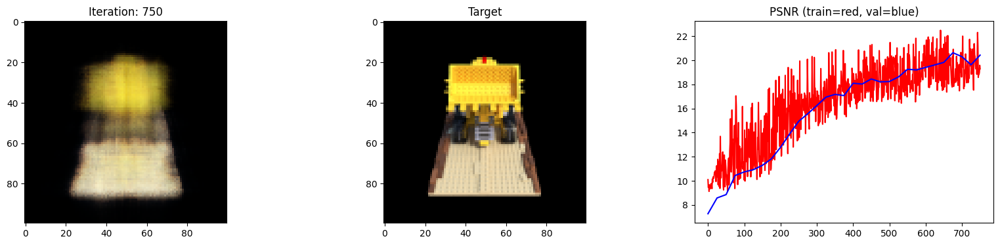

  8%|▊         | 775/10000 [05:49<1:06:23,  2.32it/s]

Loss: 0.009922320954501629


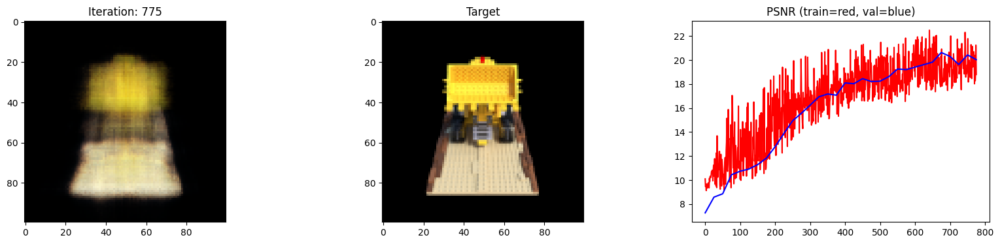

  8%|▊         | 800/10000 [06:00<1:06:17,  2.31it/s]

Loss: 0.008780053816735744


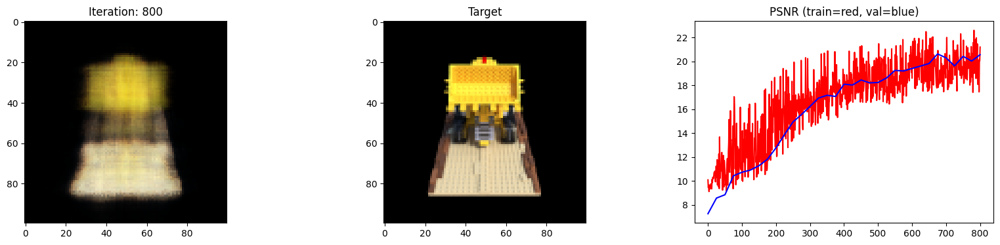

  8%|▊         | 825/10000 [06:12<1:05:51,  2.32it/s]

Loss: 0.00905140582472086


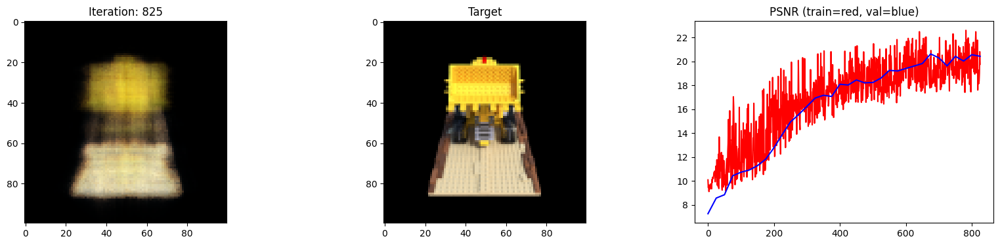

  8%|▊         | 850/10000 [06:24<1:06:04,  2.31it/s]

Loss: 0.009049664251506329


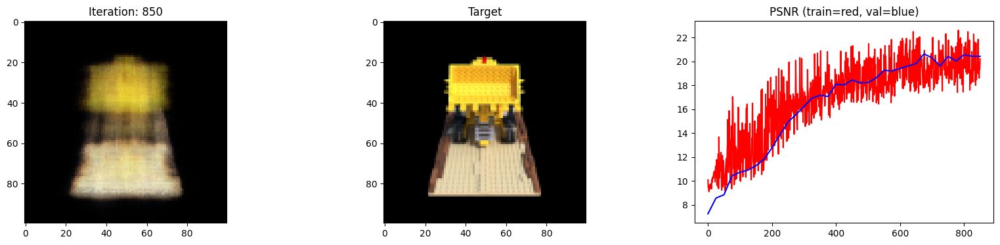

  9%|▉         | 875/10000 [06:35<1:05:46,  2.31it/s]

Loss: 0.00799599103629589


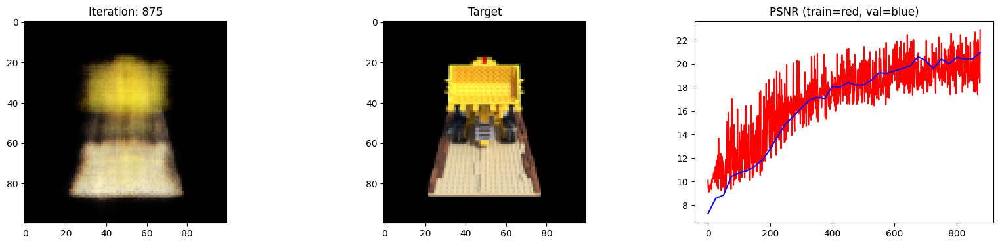

  9%|▉         | 900/10000 [06:47<1:05:37,  2.31it/s]

Loss: 0.00879964791238308


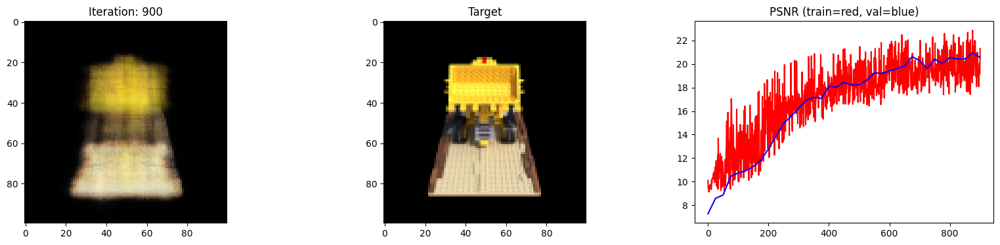

  9%|▉         | 925/10000 [06:58<1:05:23,  2.31it/s]

Loss: 0.00835487712174654


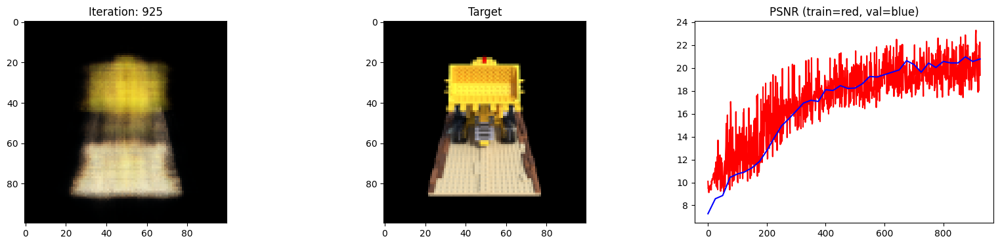

 10%|▉         | 950/10000 [07:10<1:05:37,  2.30it/s]

Loss: 0.008743730373680592


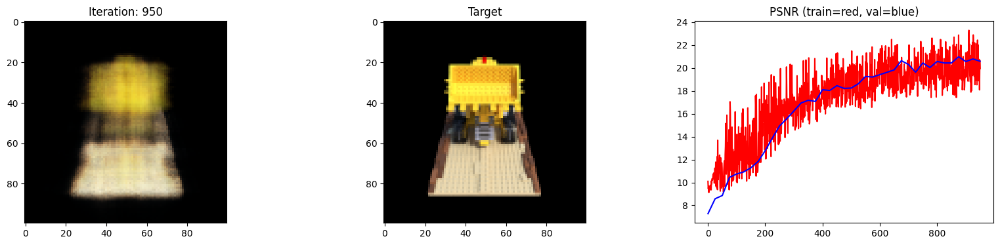

 10%|▉         | 975/10000 [07:22<1:05:13,  2.31it/s]

Loss: 0.007319488562643528


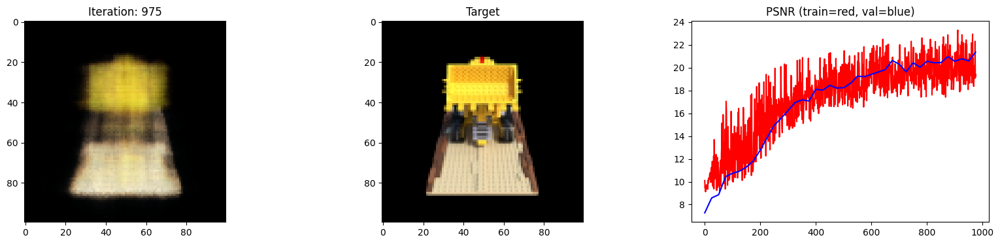

 10%|█         | 1000/10000 [07:33<1:05:07,  2.30it/s]

Loss: 0.008763439022004604


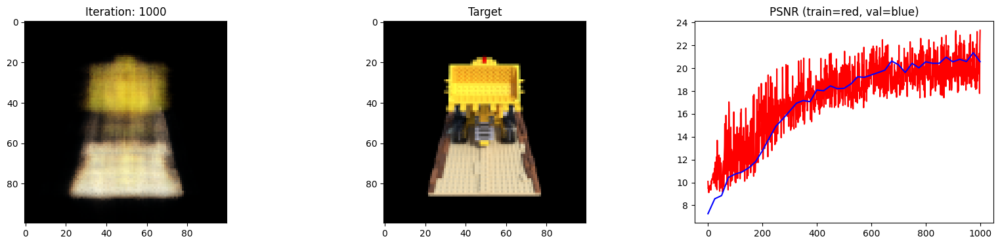

 10%|█         | 1025/10000 [07:45<1:04:33,  2.32it/s]

Loss: 0.008108600042760372


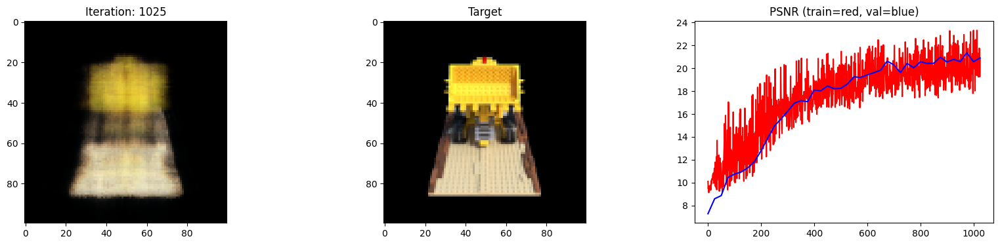

 10%|█         | 1050/10000 [07:57<1:04:33,  2.31it/s]

Loss: 0.0073306141421198845


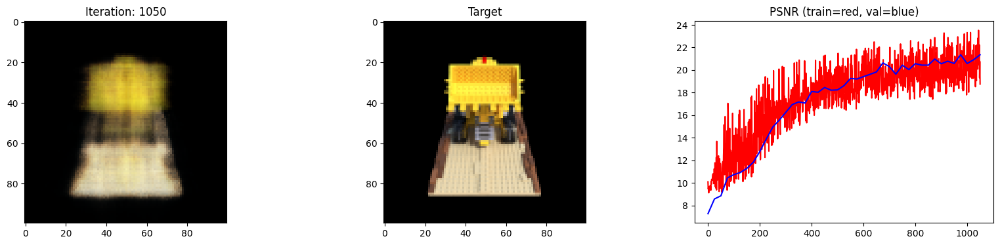

 11%|█         | 1075/10000 [08:08<1:04:11,  2.32it/s]

Loss: 0.00713553698733449


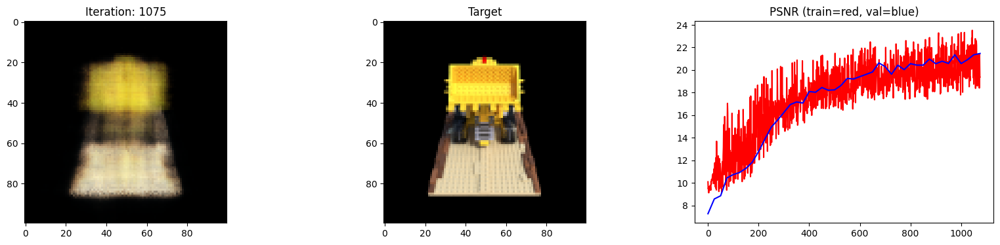

 11%|█         | 1100/10000 [08:20<1:03:59,  2.32it/s]

Loss: 0.0068656085059046745


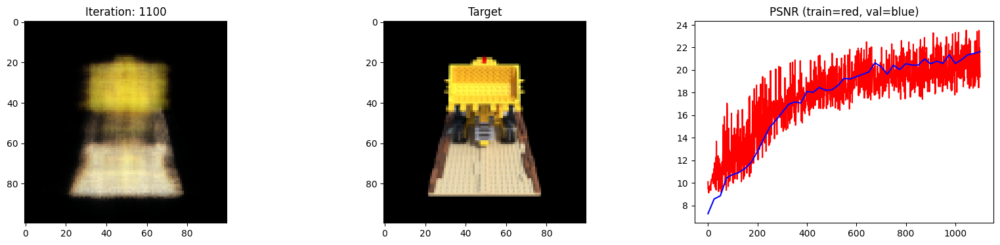

 11%|█▏        | 1125/10000 [08:32<1:03:57,  2.31it/s]

Loss: 0.008097878657281399


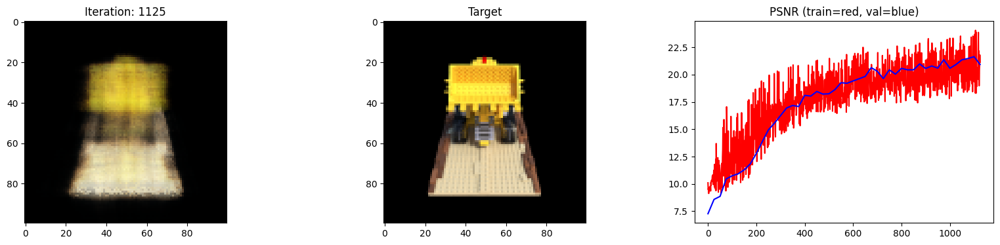

 12%|█▏        | 1150/10000 [08:44<1:03:44,  2.31it/s]

Loss: 0.006972968578338623


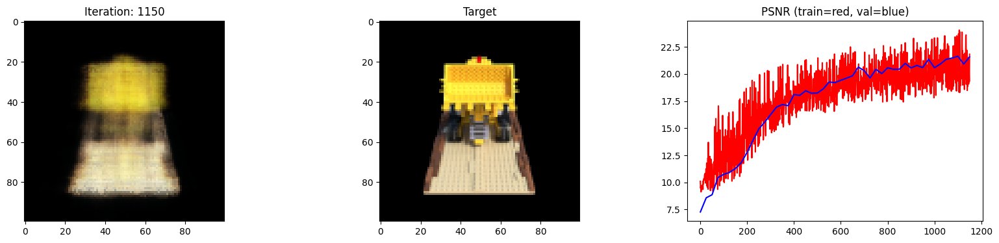

 12%|█▏        | 1175/10000 [08:55<1:03:25,  2.32it/s]

Loss: 0.00668741948902607


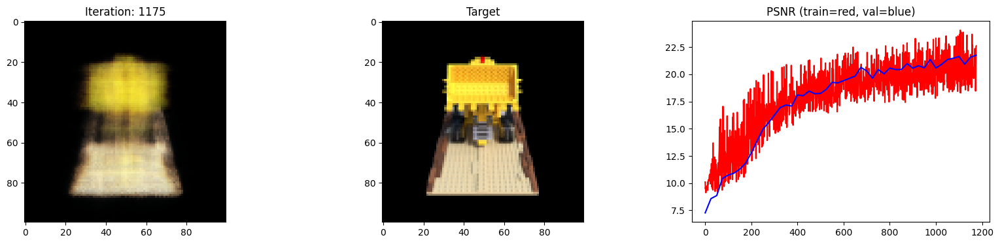

 12%|█▏        | 1200/10000 [09:07<1:03:16,  2.32it/s]

Loss: 0.007470916956663132


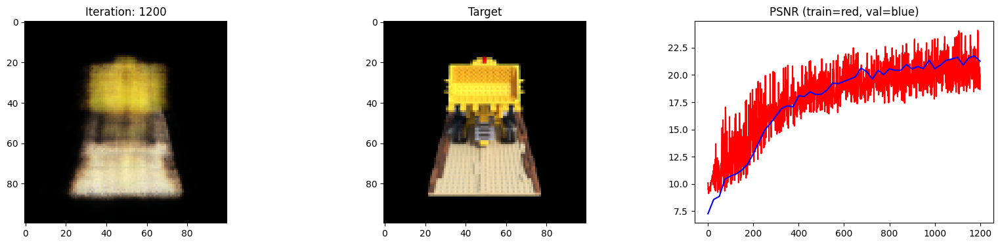

 12%|█▏        | 1225/10000 [09:18<1:03:14,  2.31it/s]

Loss: 0.009359626099467278


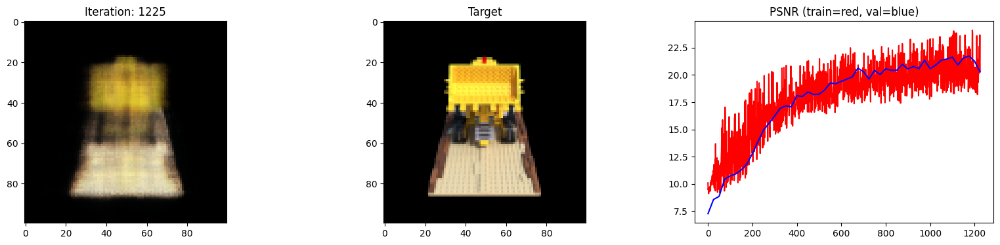

 12%|█▎        | 1250/10000 [09:30<1:03:07,  2.31it/s]

Loss: 0.006346431560814381


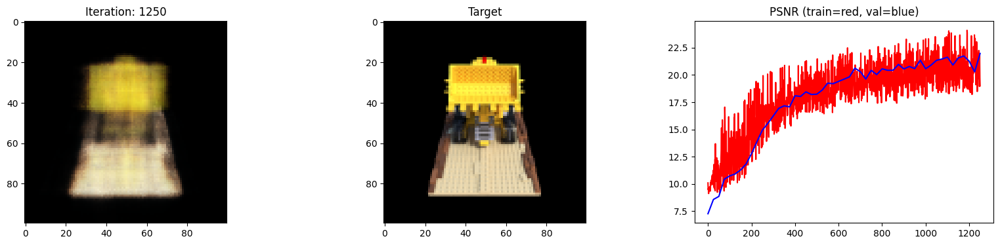

 13%|█▎        | 1275/10000 [09:42<1:02:45,  2.32it/s]

Loss: 0.00707896426320076


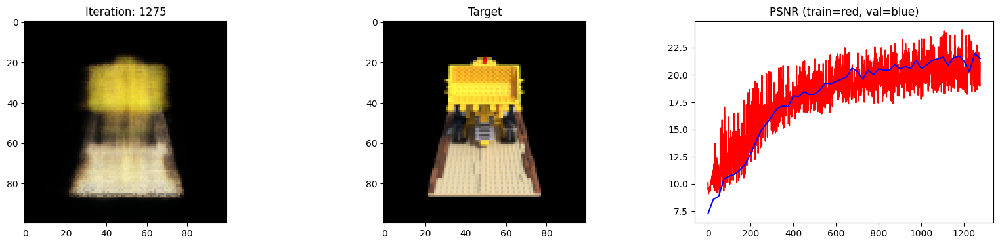

 13%|█▎        | 1300/10000 [09:53<1:02:28,  2.32it/s]

Loss: 0.006906174588948488


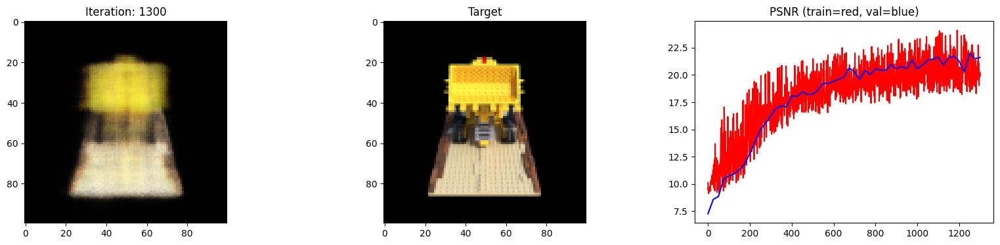

 13%|█▎        | 1325/10000 [10:05<1:02:26,  2.32it/s]

Loss: 0.005858062766492367


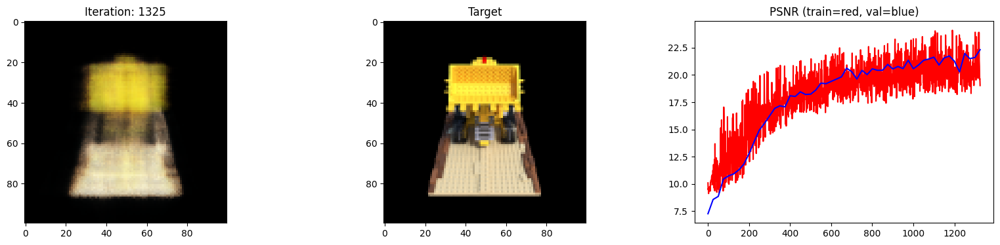

 14%|█▎        | 1350/10000 [10:16<1:02:15,  2.32it/s]

Loss: 0.007520727813243866


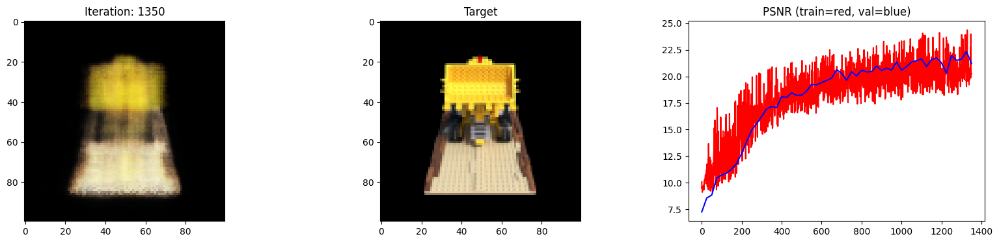

 14%|█▍        | 1375/10000 [10:28<1:02:16,  2.31it/s]

Loss: 0.006907041184604168


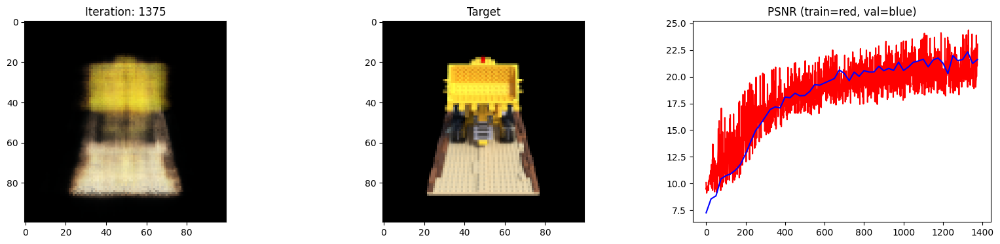

 14%|█▍        | 1400/10000 [10:40<1:02:15,  2.30it/s]

Loss: 0.006086961831897497


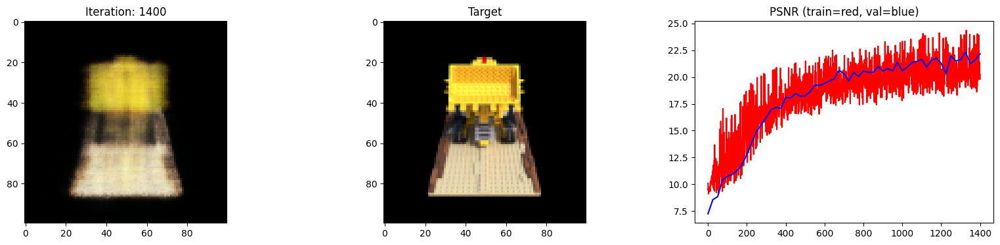

 14%|█▍        | 1425/10000 [10:51<1:01:53,  2.31it/s]

Loss: 0.006345939822494984


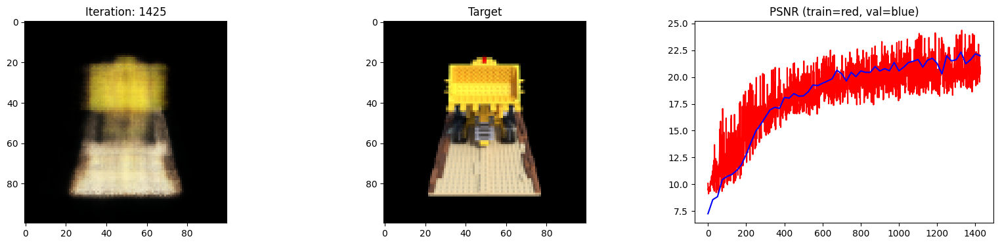

 14%|█▍        | 1450/10000 [11:03<1:01:42,  2.31it/s]

Loss: 0.006337375845760107


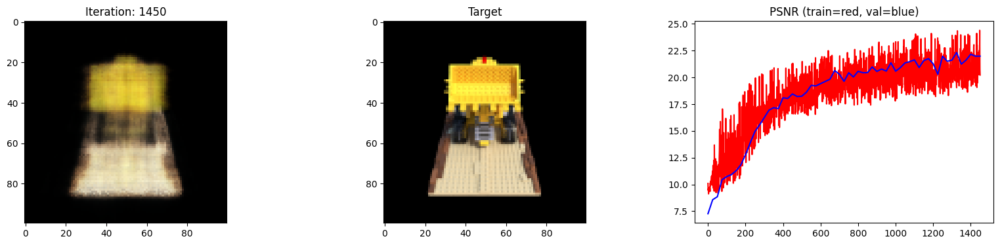

 15%|█▍        | 1475/10000 [11:15<1:01:13,  2.32it/s]

Loss: 0.00629775645211339


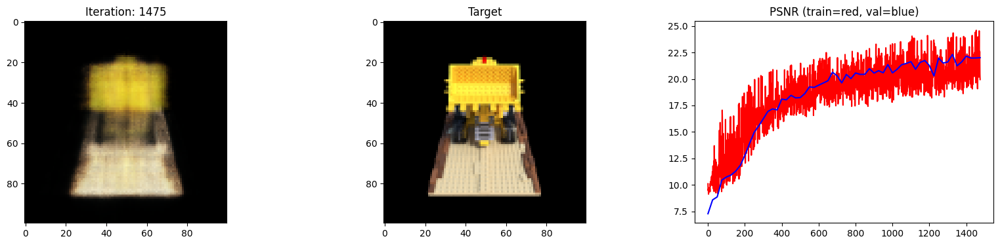

 15%|█▌        | 1500/10000 [11:26<1:01:09,  2.32it/s]

Loss: 0.006647819187492132


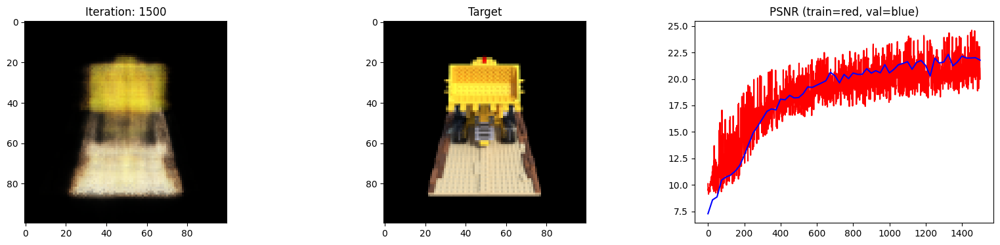

 15%|█▌        | 1525/10000 [11:38<1:01:01,  2.31it/s]

Loss: 0.006087312940508127


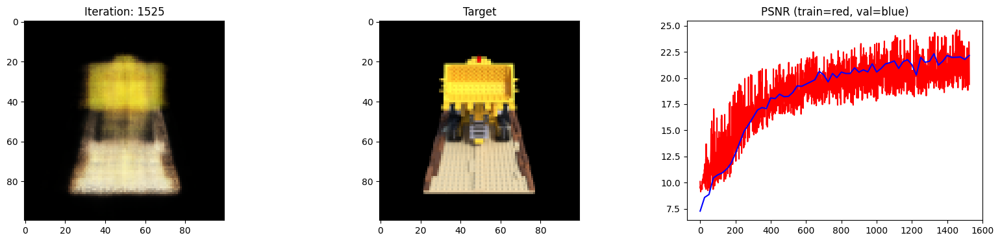

 16%|█▌        | 1550/10000 [11:50<1:00:44,  2.32it/s]

Loss: 0.006010161247104406


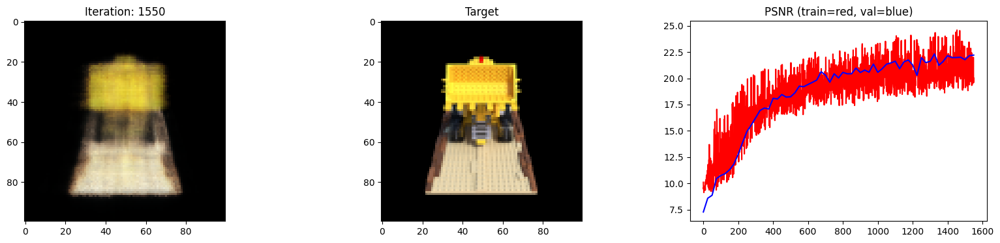

 16%|█▌        | 1575/10000 [12:02<1:00:25,  2.32it/s]

Loss: 0.006102324929088354


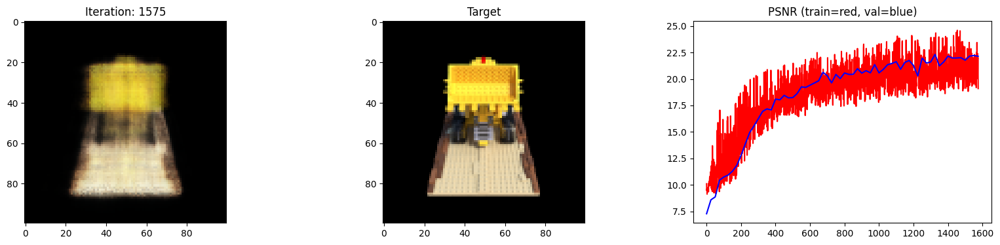

 16%|█▌        | 1600/10000 [12:13<1:00:32,  2.31it/s]

Loss: 0.007331886328756809


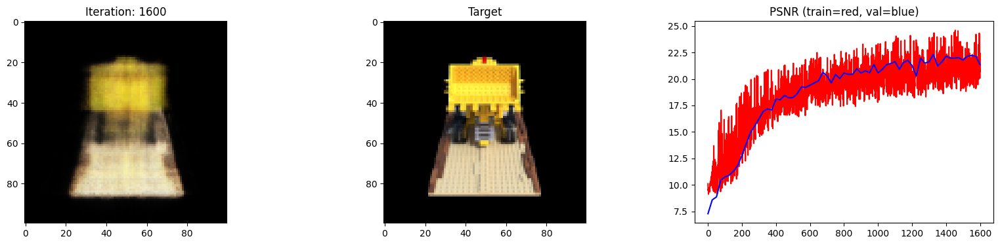

 16%|█▋        | 1625/10000 [12:25<1:00:16,  2.32it/s]

Loss: 0.005635912995785475


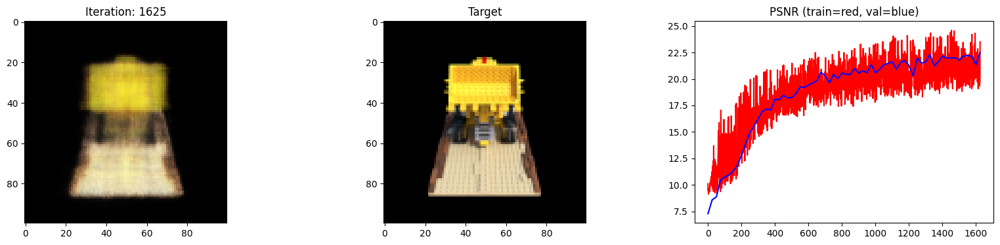

 16%|█▋        | 1650/10000 [12:36<59:52,  2.32it/s]

Loss: 0.005777272395789623


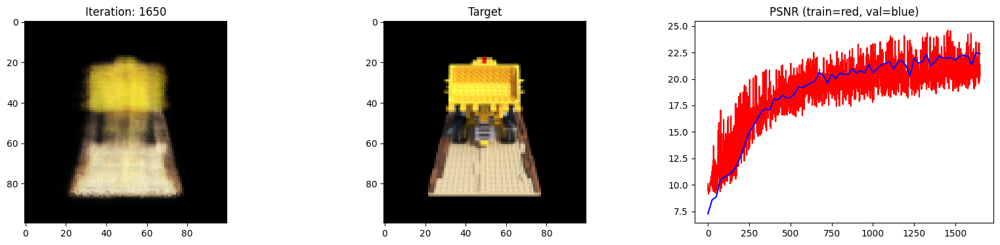

 17%|█▋        | 1675/10000 [12:48<59:53,  2.32it/s]

Loss: 0.005700182169675827


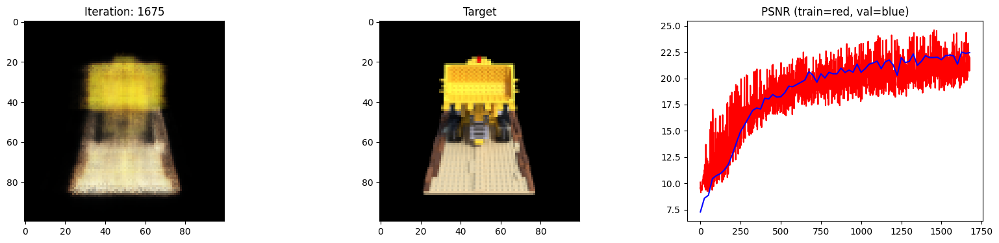

 17%|█▋        | 1700/10000 [13:00<59:41,  2.32it/s]

Loss: 0.006268560420721769


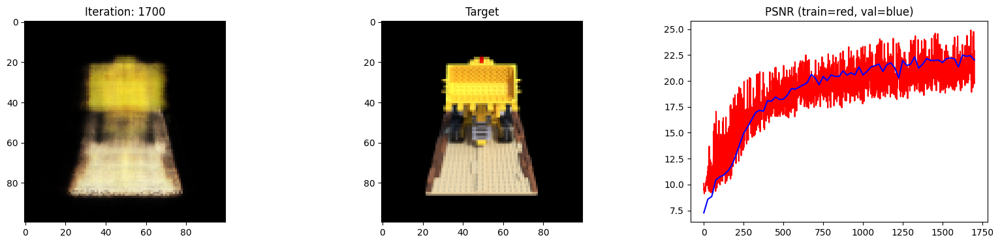

 17%|█▋        | 1725/10000 [13:11<59:28,  2.32it/s]

Loss: 0.006151579786092043


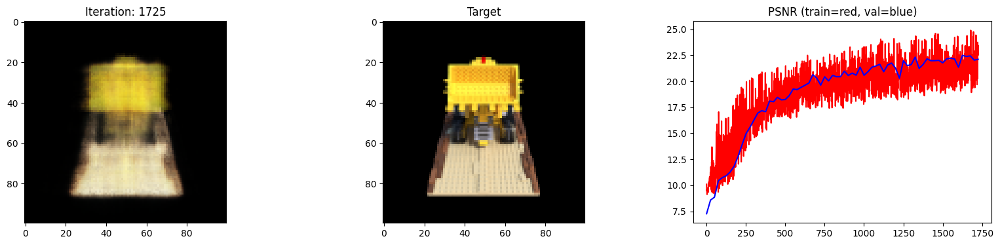

 18%|█▊        | 1750/10000 [13:23<59:14,  2.32it/s]

Loss: 0.006182928569614887


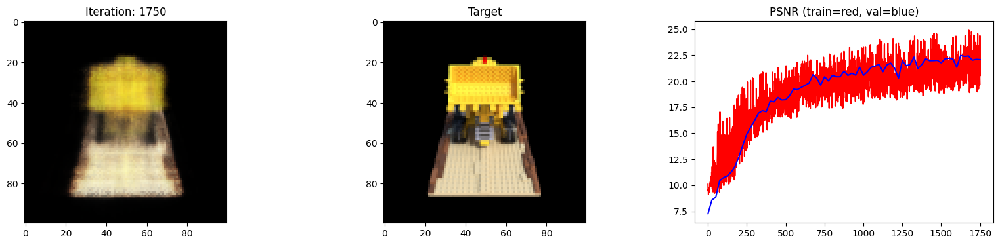

 18%|█▊        | 1775/10000 [13:34<59:05,  2.32it/s]

Loss: 0.005301604978740215


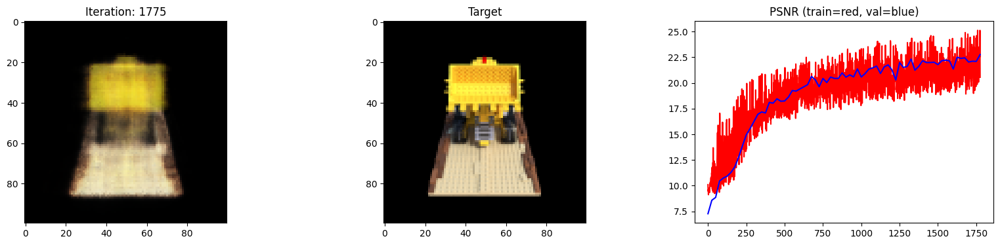

 18%|█▊        | 1800/10000 [13:46<59:21,  2.30it/s]

Loss: 0.005359317641705275


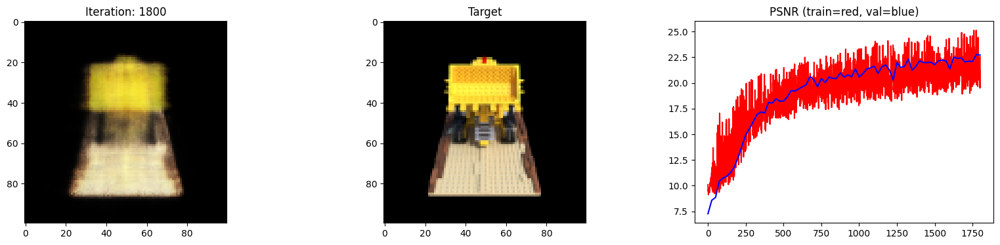

 18%|█▊        | 1825/10000 [13:57<58:54,  2.31it/s]

Loss: 0.00589396059513092


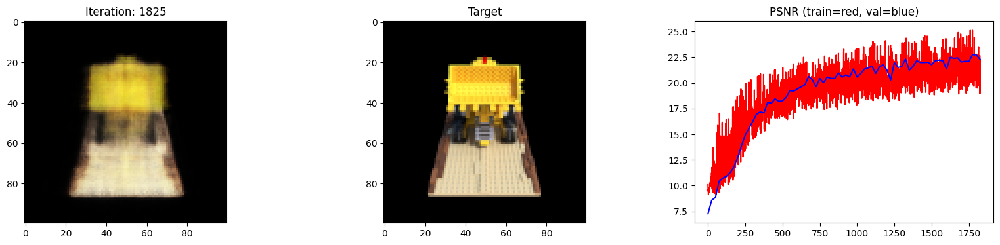

 18%|█▊        | 1850/10000 [14:09<58:41,  2.31it/s]

Loss: 0.005276853684335947


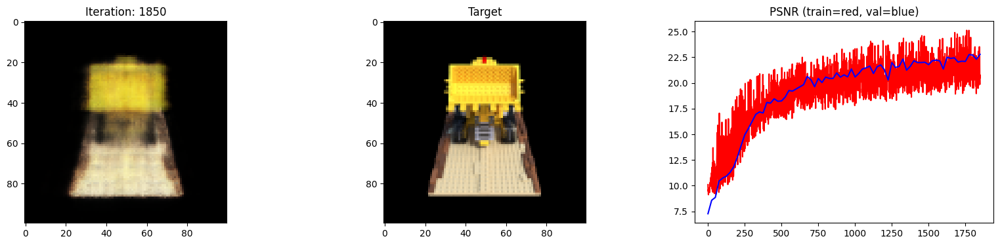

 19%|█▉        | 1875/10000 [14:21<58:19,  2.32it/s]

Loss: 0.00581547012552619


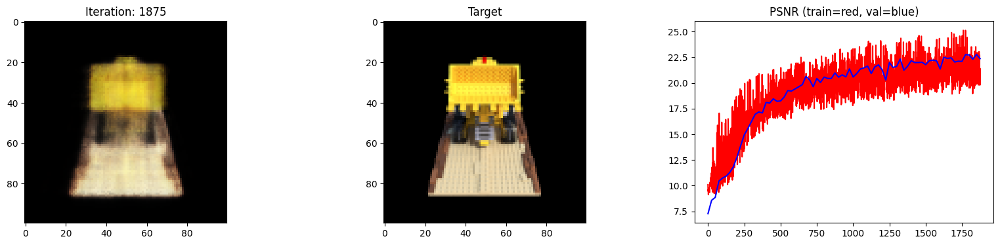

 19%|█▉        | 1900/10000 [14:33<58:10,  2.32it/s]

Loss: 0.005072297062724829


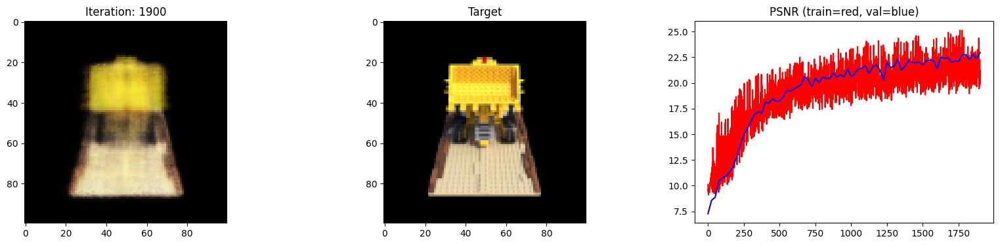

 19%|█▉        | 1925/10000 [14:44<57:57,  2.32it/s]

Loss: 0.005681114736944437


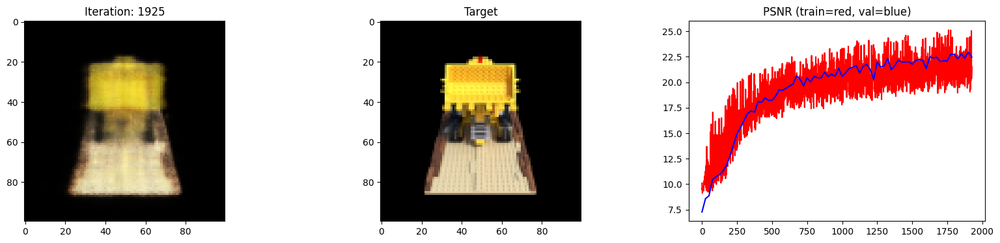

 20%|█▉        | 1950/10000 [14:56<57:44,  2.32it/s]

Loss: 0.005388505291193724


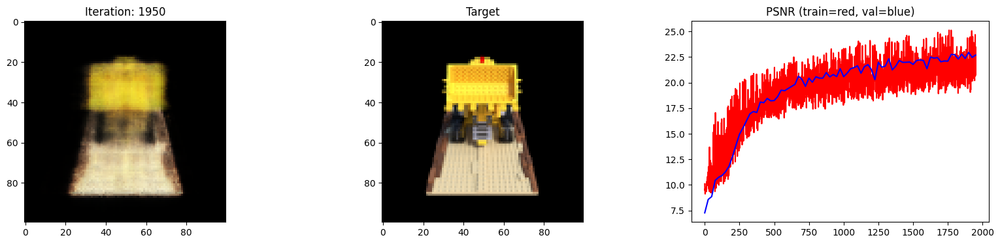

 20%|█▉        | 1975/10000 [15:08<57:25,  2.33it/s]

Loss: 0.005275513976812363


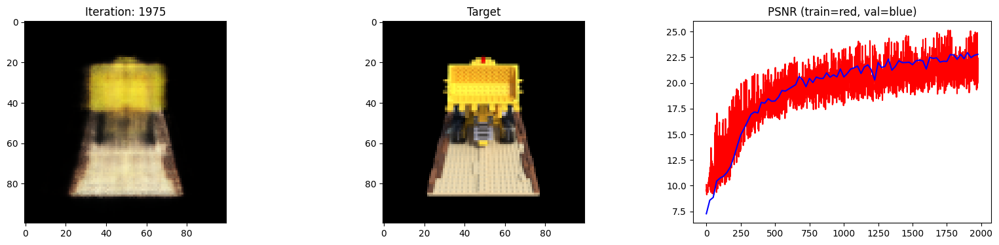

 20%|██        | 2000/10000 [15:19<57:17,  2.33it/s]

Loss: 0.00543840229511261


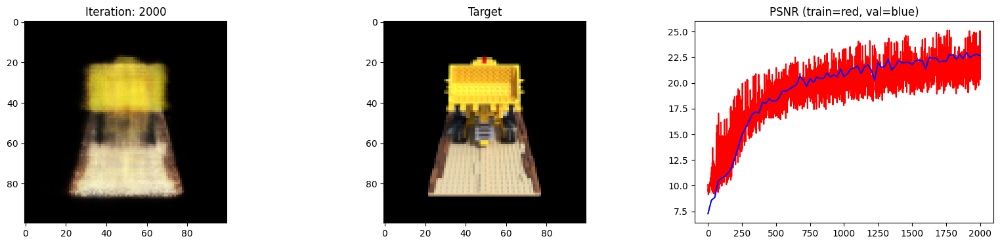

 20%|██        | 2025/10000 [15:31<57:15,  2.32it/s]

Loss: 0.005397411063313484


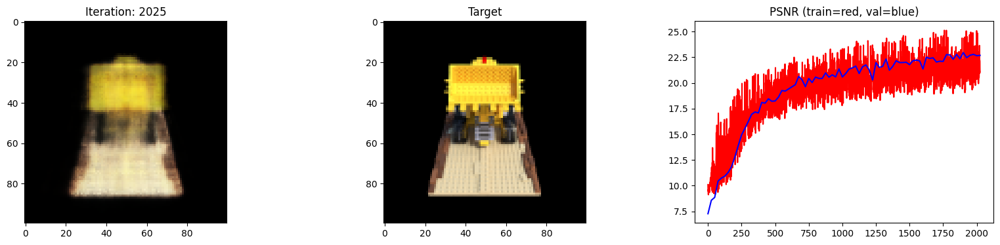

 20%|██        | 2050/10000 [15:42<57:08,  2.32it/s]

Loss: 0.005469242110848427


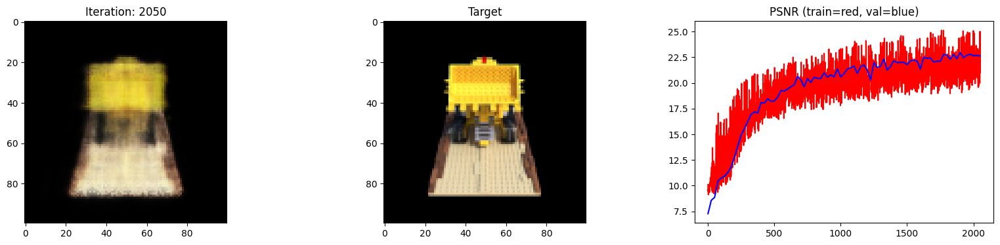

 21%|██        | 2075/10000 [15:54<56:58,  2.32it/s]

Loss: 0.004729354288429022


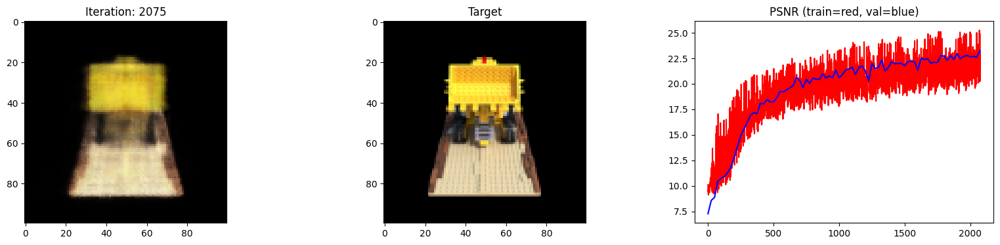

 21%|██        | 2100/10000 [16:05<56:50,  2.32it/s]

Loss: 0.00552772544324398


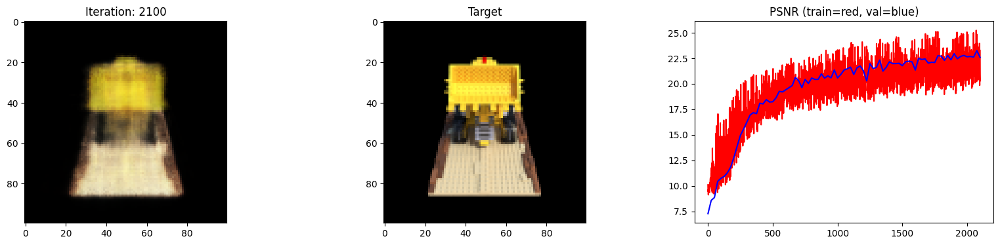

 21%|██▏       | 2125/10000 [16:17<56:43,  2.31it/s]

Loss: 0.004990912042558193


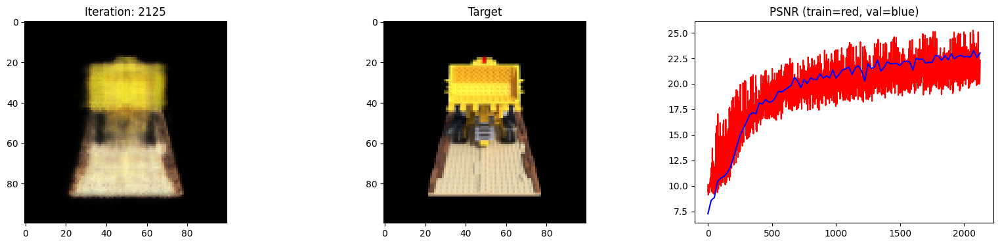

 22%|██▏       | 2150/10000 [16:29<56:30,  2.32it/s]

Loss: 0.004808508325368166


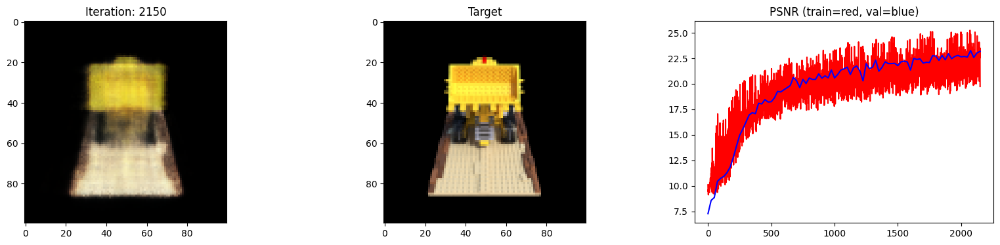

 22%|██▏       | 2175/10000 [16:40<56:19,  2.32it/s]

Loss: 0.004998615477234125


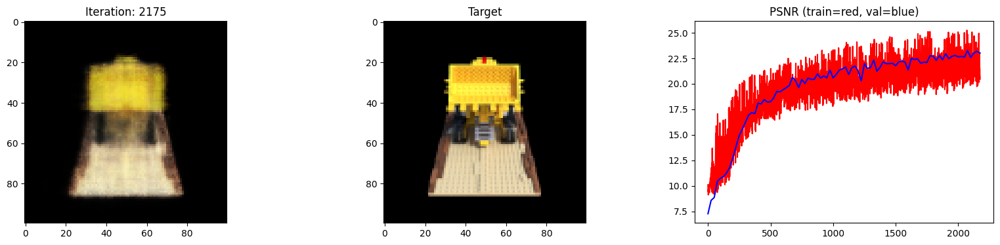

 22%|██▏       | 2200/10000 [16:52<56:04,  2.32it/s]

Loss: 0.004846201743930578


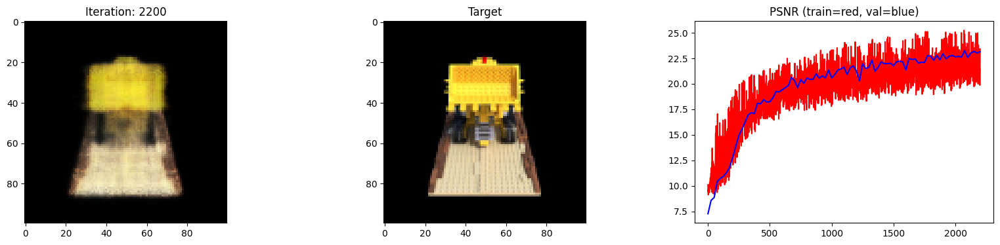

 22%|██▏       | 2225/10000 [17:03<55:47,  2.32it/s]

Loss: 0.005045292899012566


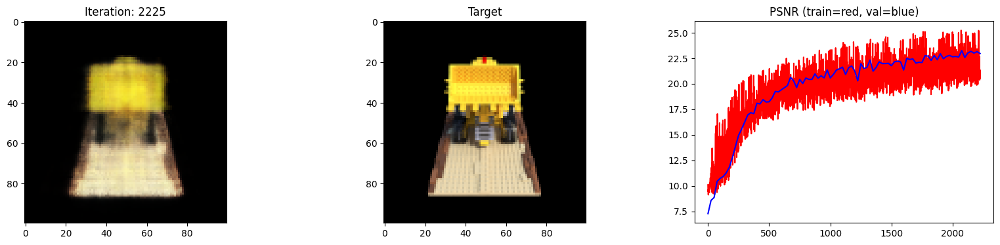

 22%|██▎       | 2250/10000 [17:15<55:30,  2.33it/s]

Loss: 0.005162196233868599


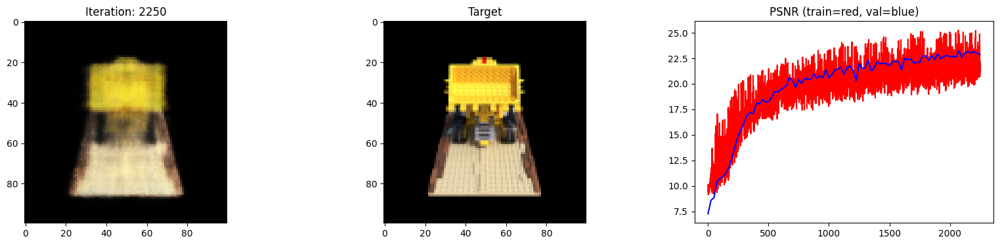

 23%|██▎       | 2275/10000 [17:27<55:17,  2.33it/s]

Loss: 0.005782996769994497


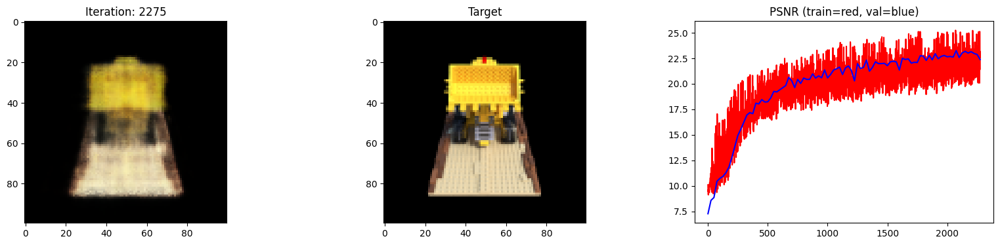

 23%|██▎       | 2300/10000 [17:39<55:08,  2.33it/s]

Loss: 0.005167738534510136


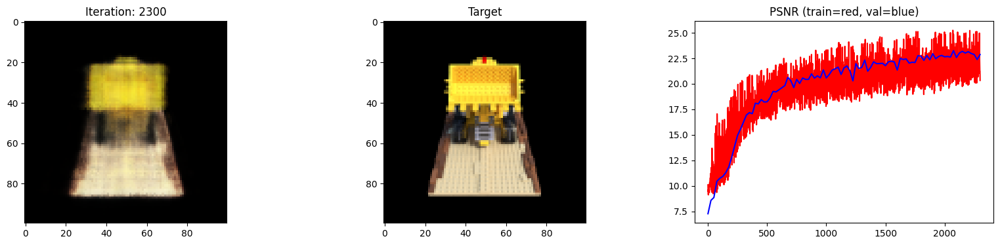

 23%|██▎       | 2325/10000 [17:50<55:08,  2.32it/s]

Loss: 0.004988772328943014


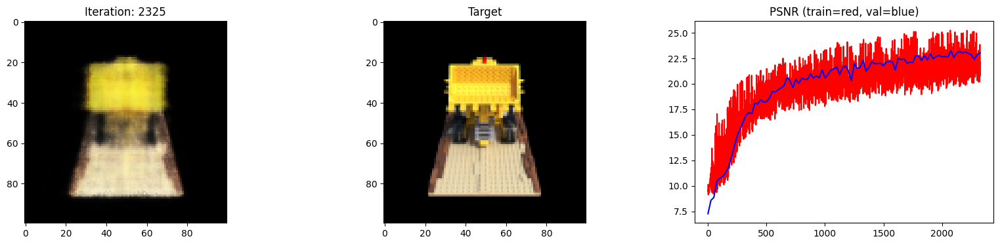

 24%|██▎       | 2350/10000 [18:02<54:57,  2.32it/s]

Loss: 0.004979780409485102


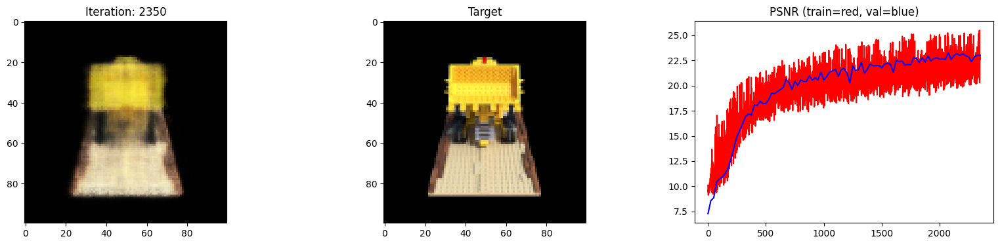

 24%|██▍       | 2375/10000 [18:13<54:43,  2.32it/s]

Loss: 0.004761270247399807


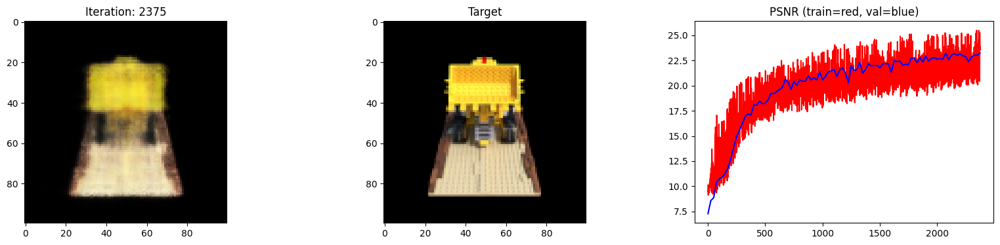

 24%|██▍       | 2400/10000 [18:25<54:31,  2.32it/s]

Loss: 0.005273073446005583


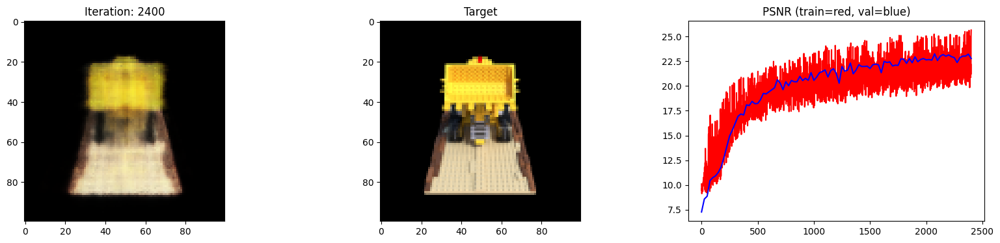

 24%|██▍       | 2425/10000 [18:36<54:32,  2.31it/s]

Loss: 0.004804881755262613


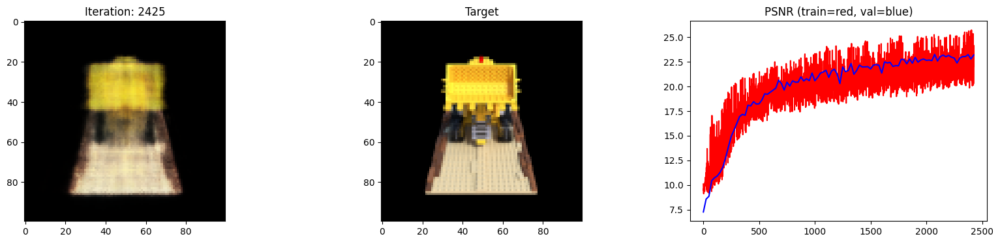

 24%|██▍       | 2450/10000 [18:48<54:22,  2.31it/s]

Loss: 0.00460079638287425


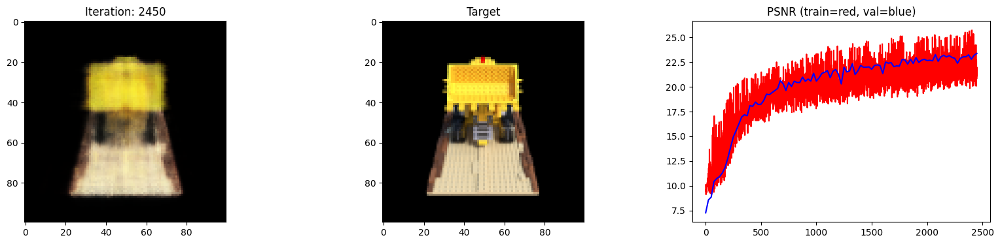

 25%|██▍       | 2475/10000 [19:00<54:18,  2.31it/s]

Loss: 0.005538258235901594


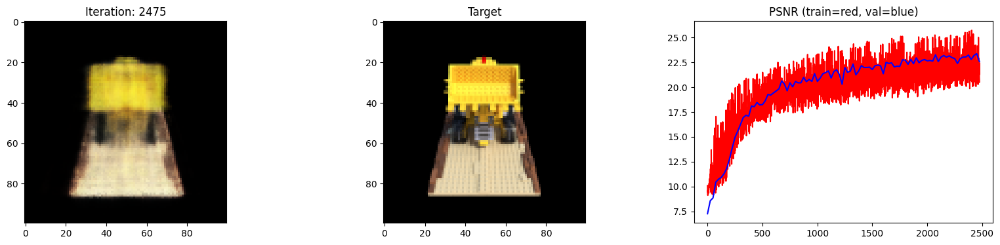

 25%|██▌       | 2500/10000 [19:11<54:02,  2.31it/s]

Loss: 0.005542420316487551


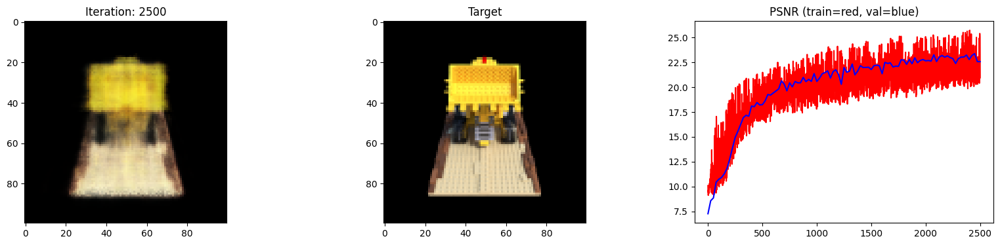

 25%|██▌       | 2525/10000 [19:23<53:42,  2.32it/s]

Loss: 0.0048742759972810745


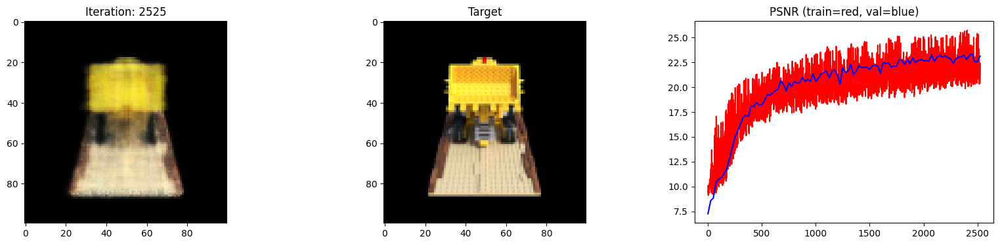

 26%|██▌       | 2550/10000 [19:35<53:29,  2.32it/s]

Loss: 0.0048508779145777225


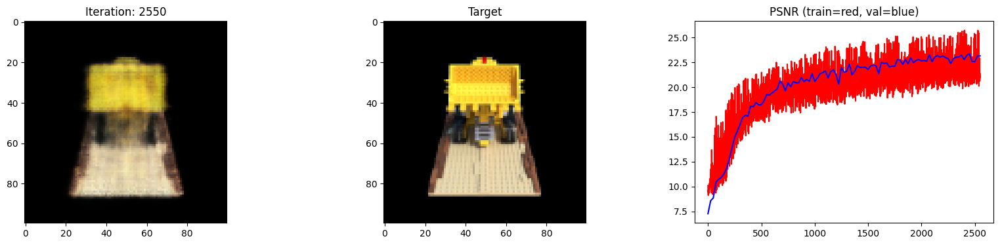

 26%|██▌       | 2575/10000 [19:46<53:09,  2.33it/s]

Loss: 0.005099697038531303


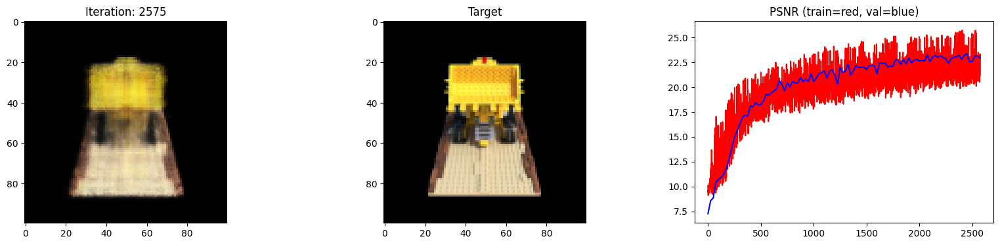

 26%|██▌       | 2600/10000 [19:58<53:02,  2.32it/s]

Loss: 0.004830104764550924


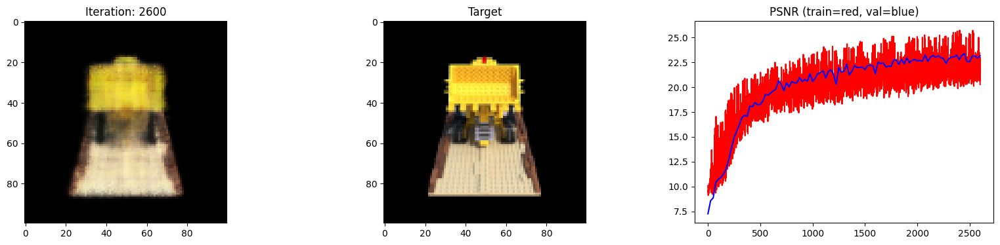

 26%|██▋       | 2625/10000 [20:10<52:49,  2.33it/s]

Loss: 0.004975566640496254


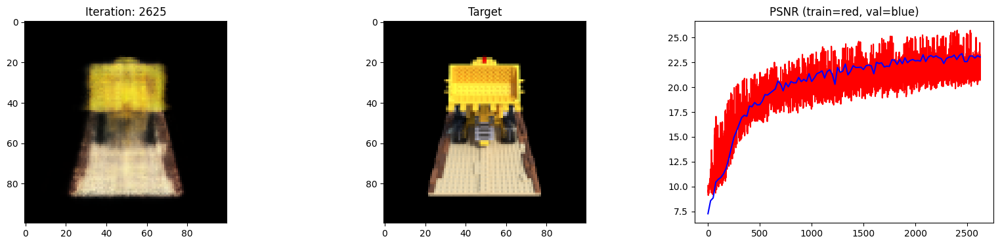

 26%|██▋       | 2650/10000 [20:21<52:34,  2.33it/s]

Loss: 0.0048326109535992146


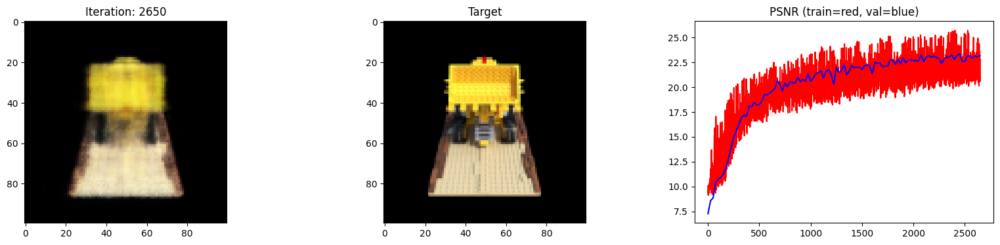

 27%|██▋       | 2675/10000 [20:33<52:31,  2.32it/s]

Loss: 0.004892225377261639


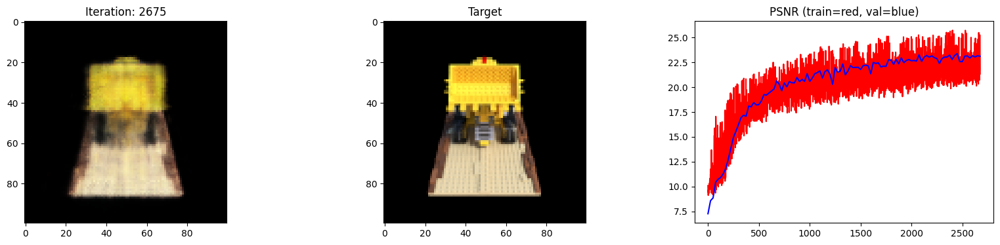

 27%|██▋       | 2700/10000 [20:45<52:27,  2.32it/s]

Loss: 0.005469570867717266


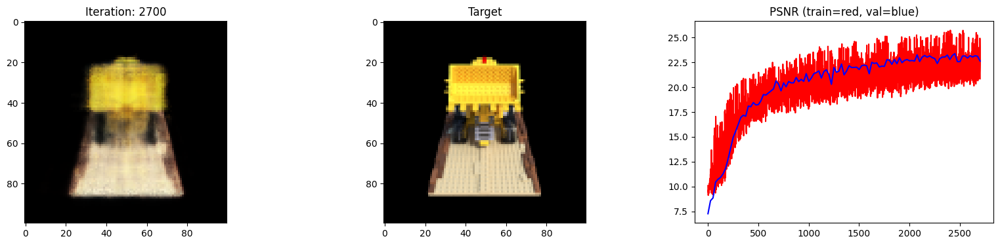

 27%|██▋       | 2725/10000 [20:56<52:08,  2.33it/s]

Loss: 0.00460595590993762


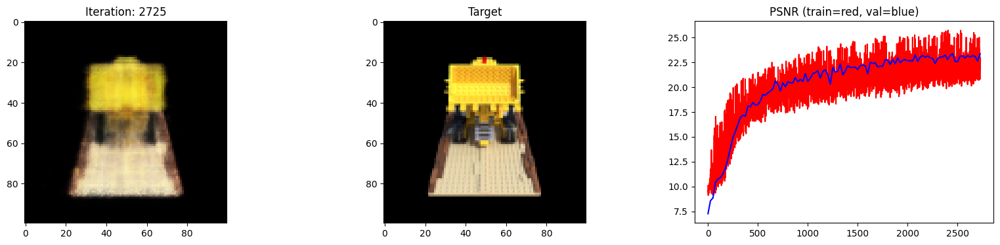

 28%|██▊       | 2750/10000 [21:08<51:59,  2.32it/s]

Loss: 0.004285531584173441


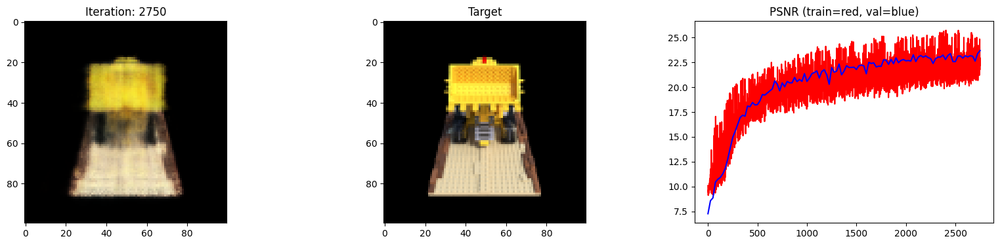

 28%|██▊       | 2775/10000 [21:19<51:44,  2.33it/s]

Loss: 0.004242707975208759


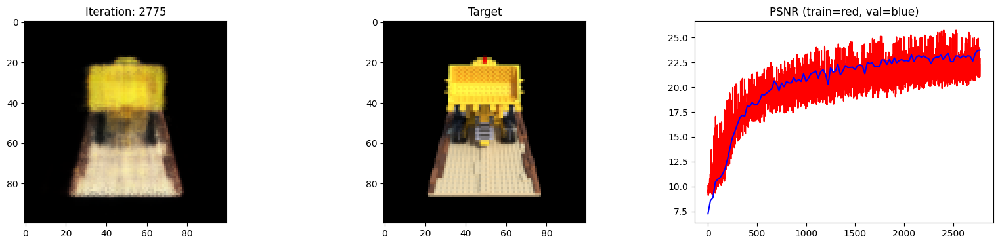

 28%|██▊       | 2800/10000 [21:31<51:49,  2.32it/s]

Loss: 0.004412461072206497


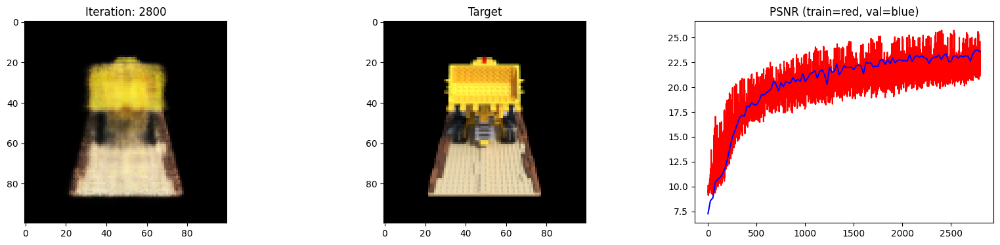

 28%|██▊       | 2825/10000 [21:42<51:27,  2.32it/s]

Loss: 0.004303833469748497


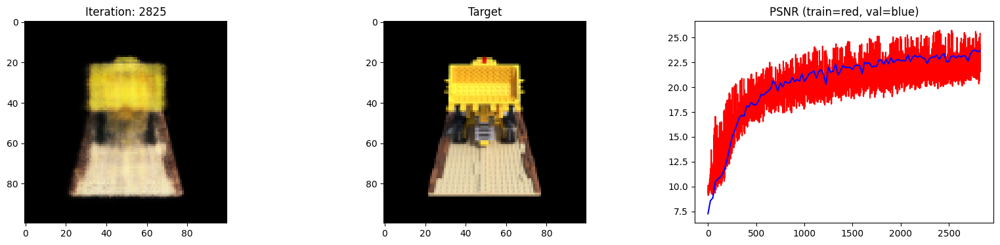

 28%|██▊       | 2850/10000 [21:54<51:17,  2.32it/s]

Loss: 0.004478353075683117


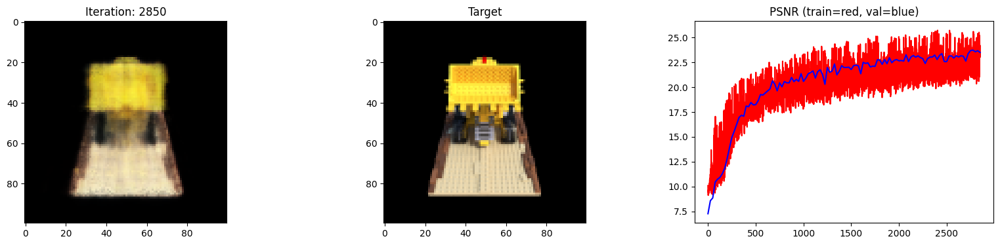

 29%|██▉       | 2875/10000 [22:06<51:04,  2.32it/s]

Loss: 0.005026982631534338


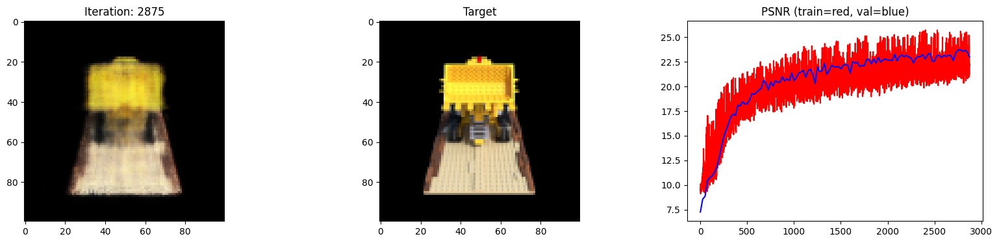

 29%|██▉       | 2900/10000 [22:18<50:48,  2.33it/s]

Loss: 0.004404149483889341


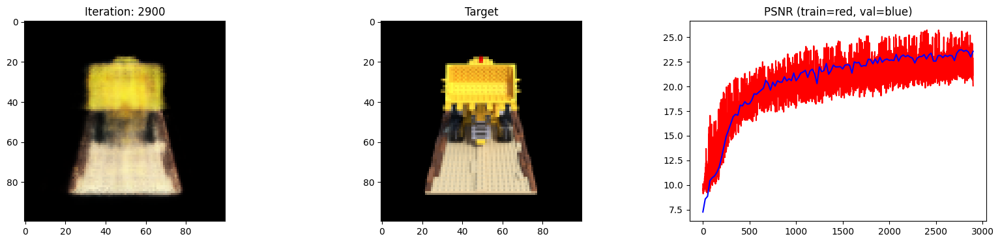

 29%|██▉       | 2925/10000 [22:29<50:40,  2.33it/s]

Loss: 0.004518033005297184


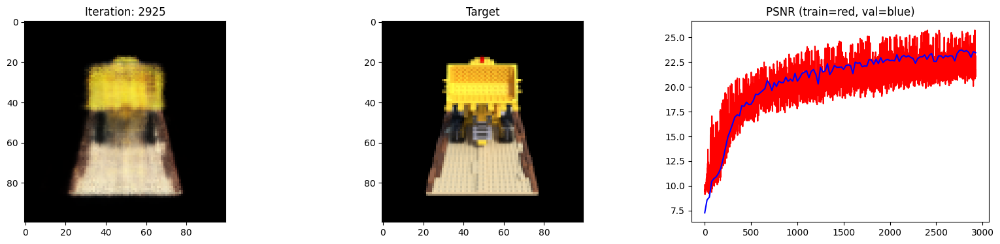

 30%|██▉       | 2950/10000 [22:41<50:37,  2.32it/s]

Loss: 0.00434746453538537


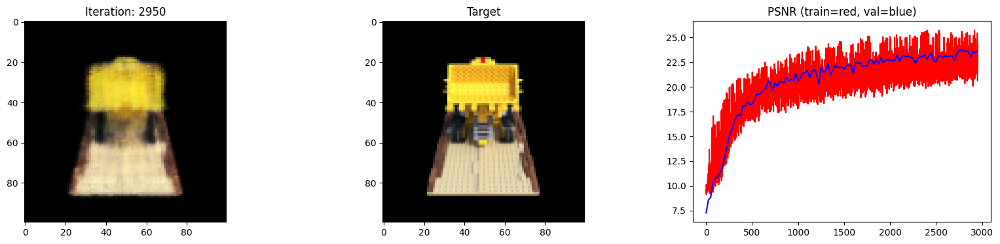

 30%|██▉       | 2975/10000 [22:52<50:23,  2.32it/s]

Loss: 0.004270022269338369


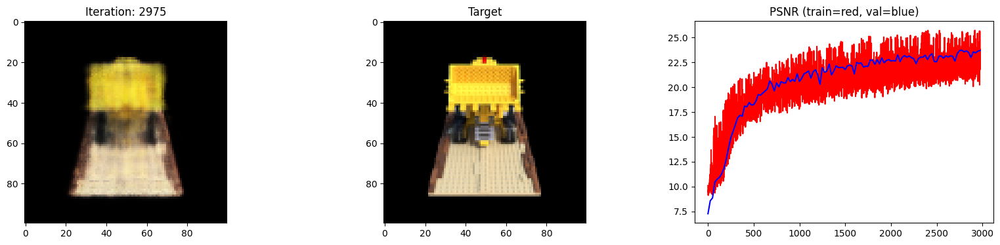

 30%|███       | 3000/10000 [23:04<50:07,  2.33it/s]

Loss: 0.003866012906655669


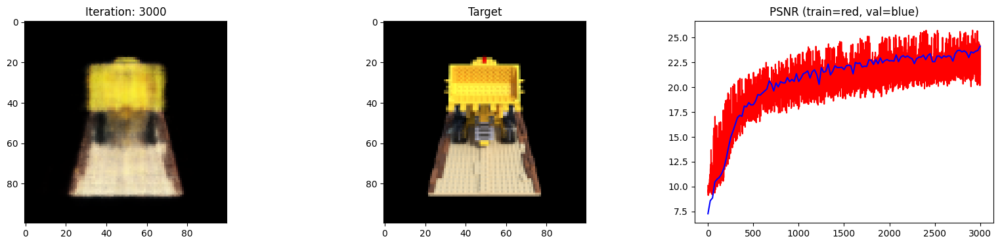

 30%|███       | 3025/10000 [23:16<50:06,  2.32it/s]

Loss: 0.004635031800717115


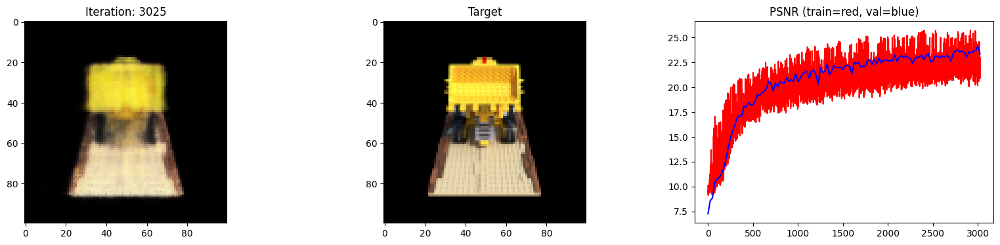

 30%|███       | 3050/10000 [23:27<49:48,  2.33it/s]

Loss: 0.004133688285946846


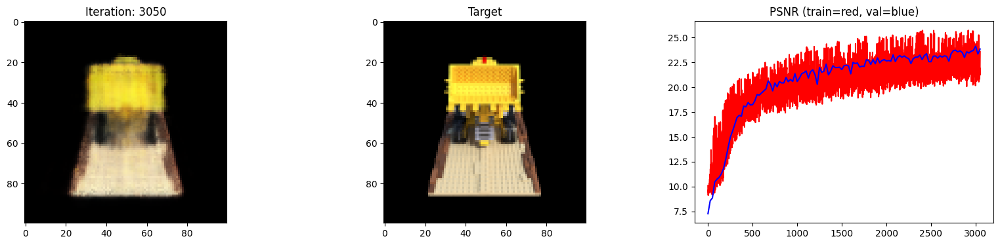

 31%|███       | 3075/10000 [23:39<49:46,  2.32it/s]

Loss: 0.004359639249742031


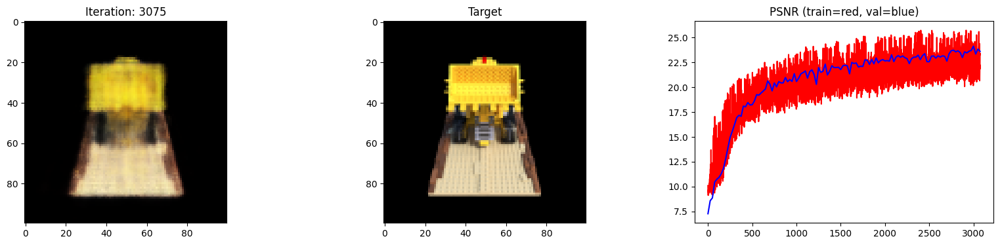

 31%|███       | 3100/10000 [23:50<49:37,  2.32it/s]

Loss: 0.0042000929825007915


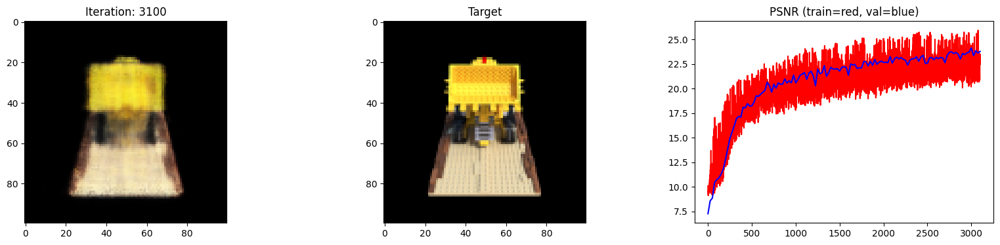

 31%|███▏      | 3125/10000 [24:02<49:19,  2.32it/s]

Loss: 0.004421143792569637


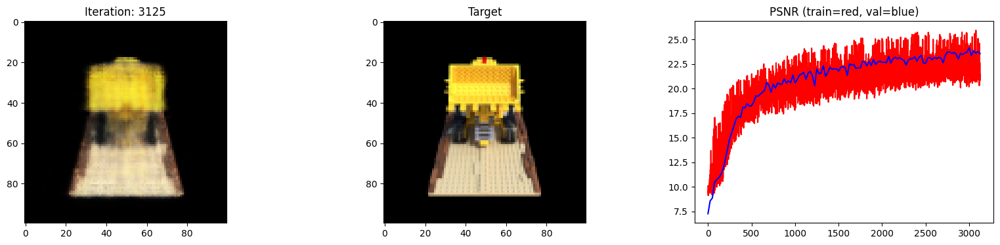

 32%|███▏      | 3150/10000 [24:14<48:54,  2.33it/s]

Loss: 0.0040888916701078415


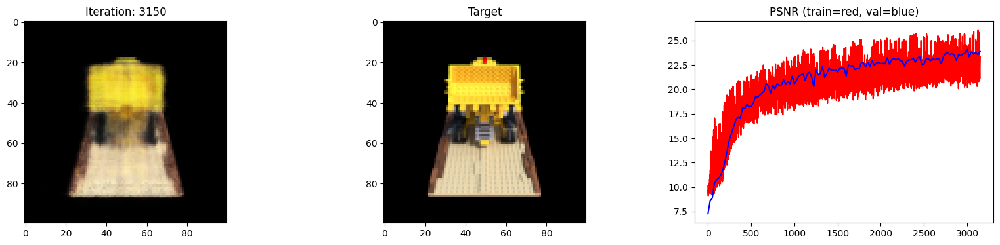

 32%|███▏      | 3175/10000 [24:25<48:53,  2.33it/s]

Loss: 0.004103409126400948


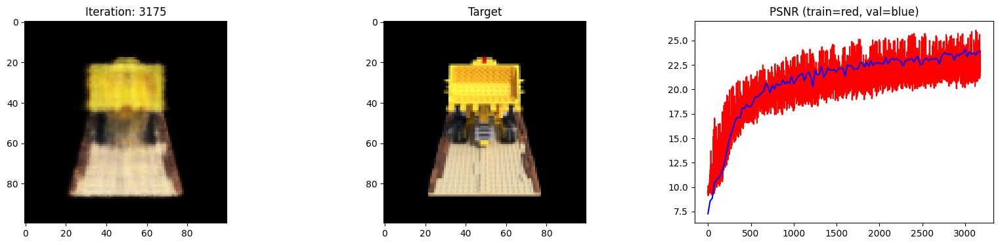

 32%|███▏      | 3200/10000 [24:37<48:42,  2.33it/s]

Loss: 0.004521450959146023


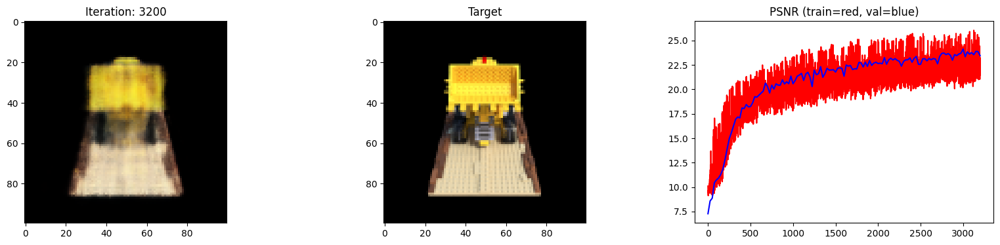

 32%|███▏      | 3225/10000 [24:49<48:31,  2.33it/s]

Loss: 0.004096254240721464


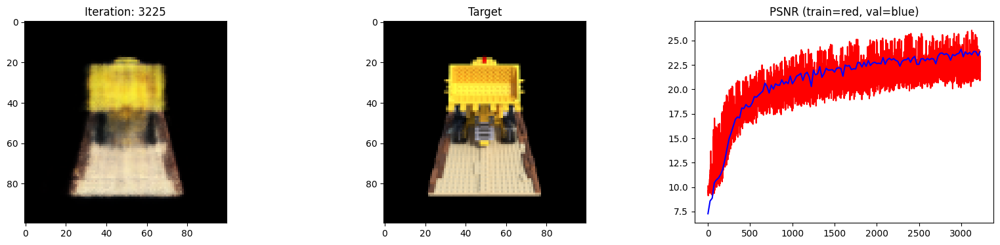

 32%|███▎      | 3250/10000 [25:00<48:26,  2.32it/s]

Loss: 0.004360788036137819


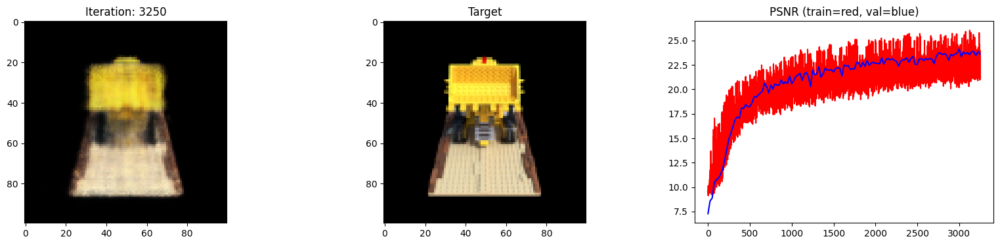

 33%|███▎      | 3275/10000 [25:12<48:07,  2.33it/s]

Loss: 0.004408998880535364


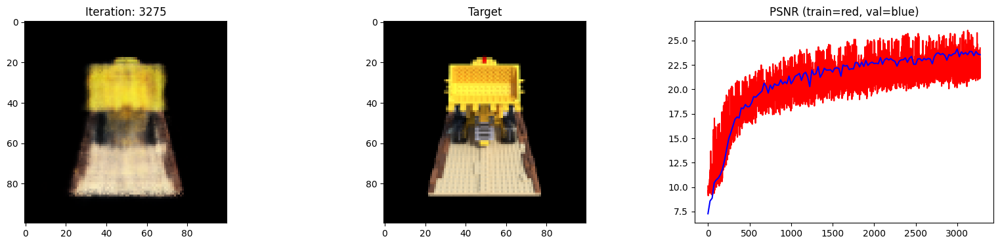

 33%|███▎      | 3300/10000 [25:24<48:00,  2.33it/s]

Loss: 0.00505475141108036


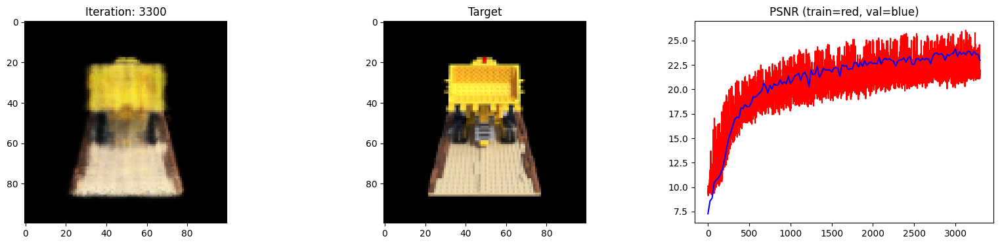

 33%|███▎      | 3325/10000 [25:35<47:51,  2.32it/s]

Loss: 0.004745046142488718


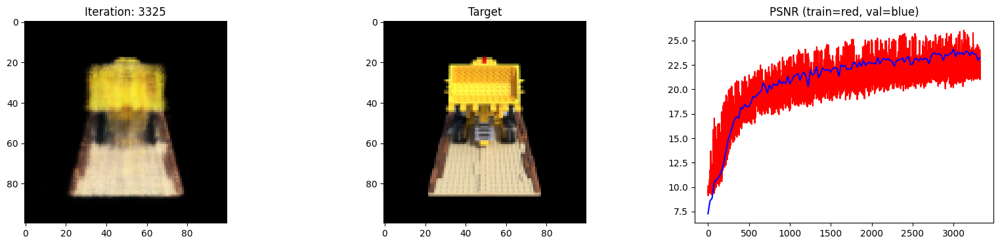

 34%|███▎      | 3350/10000 [25:47<47:48,  2.32it/s]

Loss: 0.004304418805986643


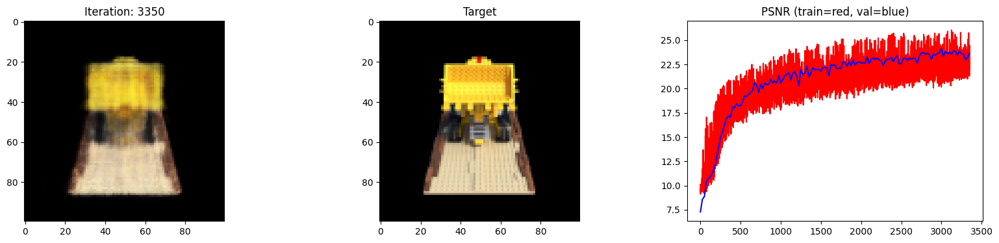

 34%|███▍      | 3375/10000 [25:58<47:39,  2.32it/s]

Loss: 0.004347373731434345


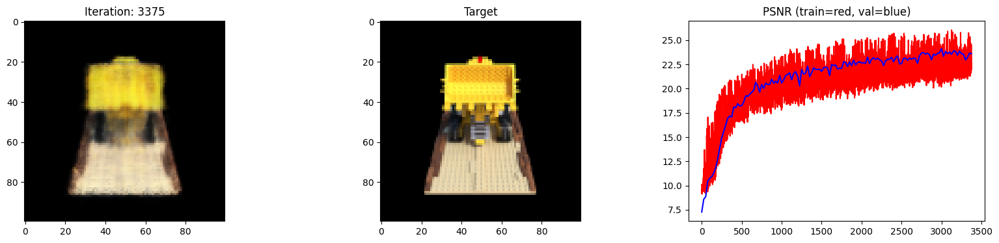

 34%|███▍      | 3400/10000 [26:10<47:39,  2.31it/s]

Loss: 0.003995092120021582


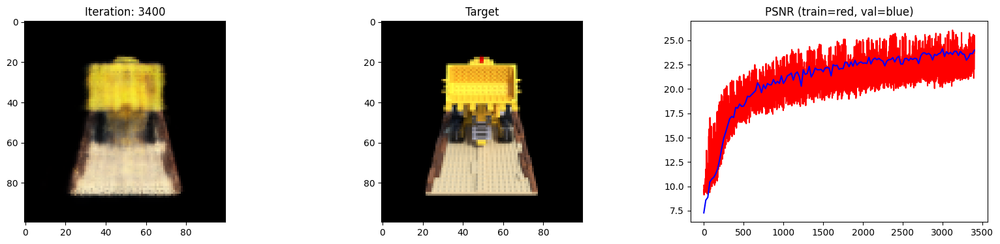

 34%|███▍      | 3425/10000 [26:22<47:09,  2.32it/s]

Loss: 0.0039932322688400745


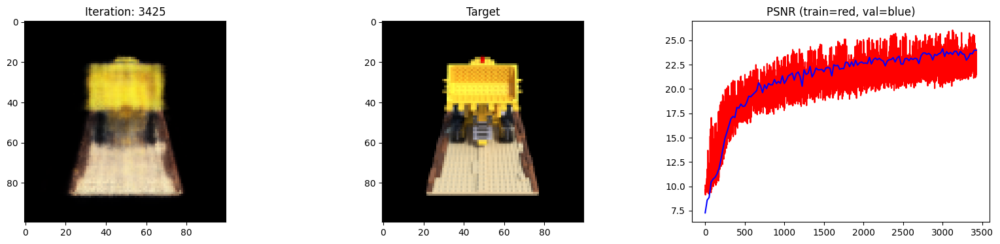

 34%|███▍      | 3450/10000 [26:34<46:55,  2.33it/s]

Loss: 0.004132917616516352


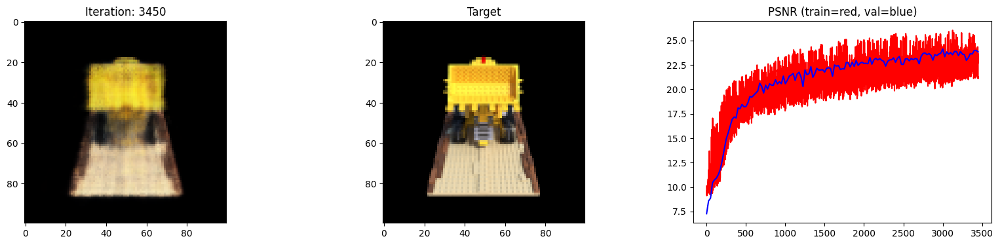

 35%|███▍      | 3475/10000 [26:45<46:40,  2.33it/s]

Loss: 0.004637585021555424


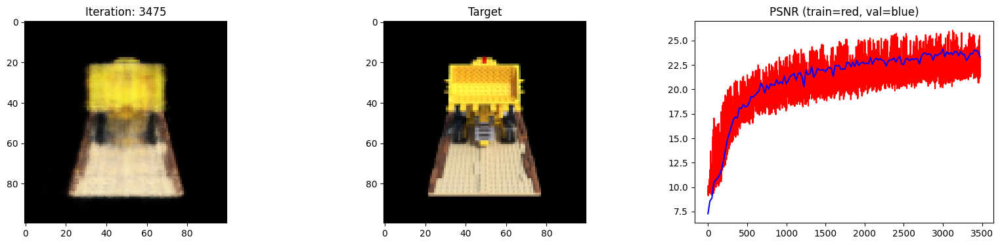

 35%|███▌      | 3500/10000 [26:57<46:29,  2.33it/s]

Loss: 0.004041953478008509


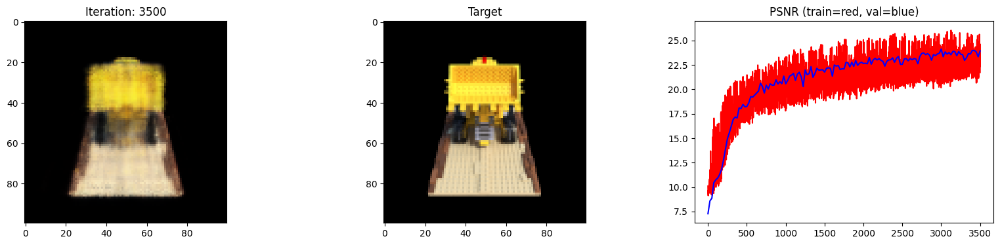

 35%|███▌      | 3525/10000 [27:08<46:33,  2.32it/s]

Loss: 0.0038373286370187998


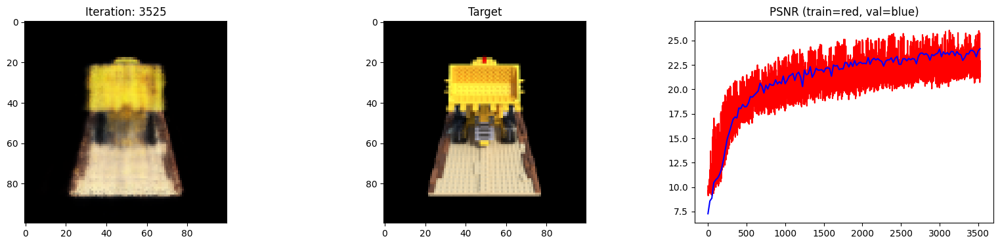

 36%|███▌      | 3550/10000 [27:20<46:18,  2.32it/s]

Loss: 0.004240214359015226


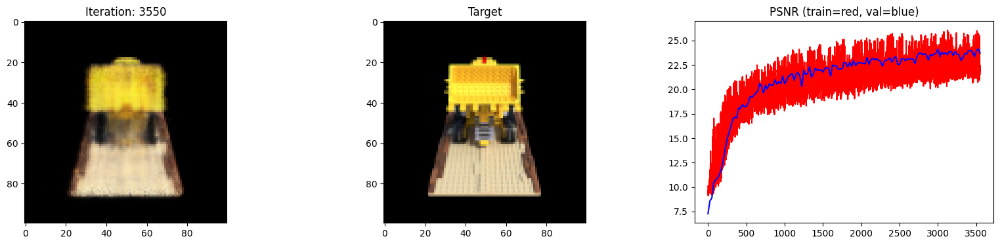

 36%|███▌      | 3575/10000 [27:32<46:01,  2.33it/s]

Loss: 0.004521327558904886


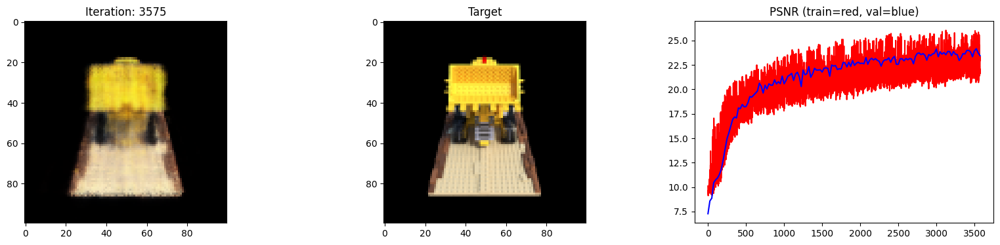

 36%|███▌      | 3600/10000 [27:43<46:00,  2.32it/s]

Loss: 0.004253791645169258


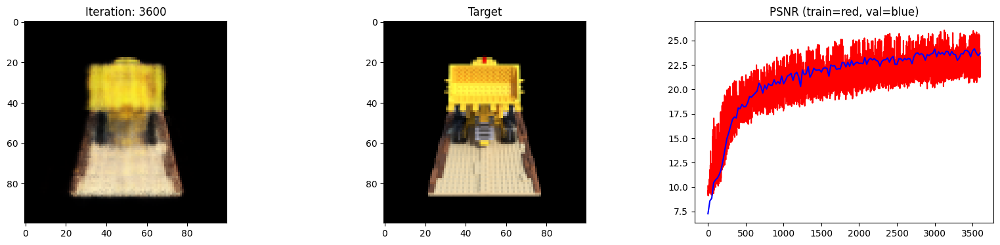

 36%|███▋      | 3625/10000 [27:55<45:58,  2.31it/s]

Loss: 0.004295905586332083


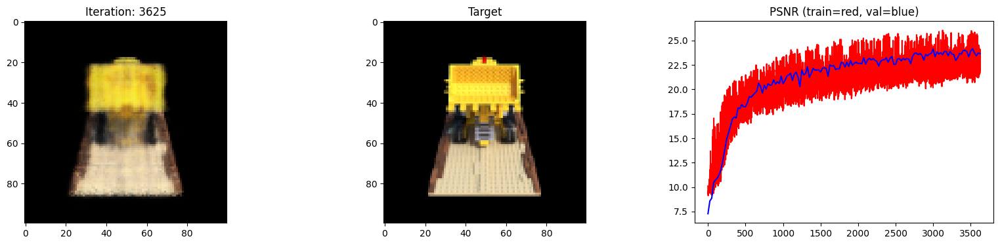

 36%|███▋      | 3650/10000 [28:07<45:40,  2.32it/s]

Loss: 0.0039999778382480145


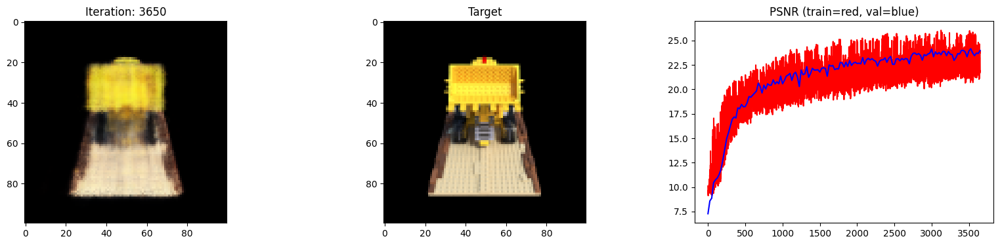

 37%|███▋      | 3675/10000 [28:18<45:19,  2.33it/s]

Loss: 0.0037759190890938044


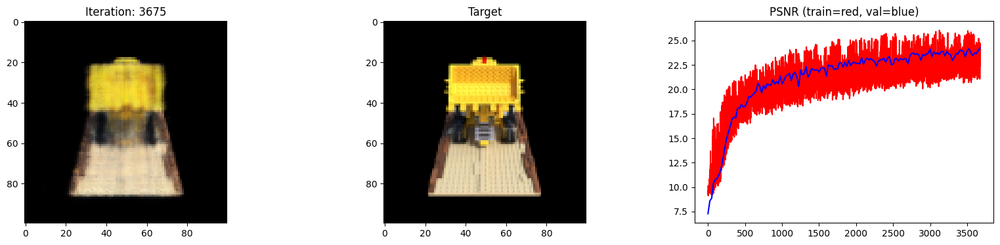

 37%|███▋      | 3700/10000 [28:30<45:07,  2.33it/s]

Loss: 0.004176539368927479


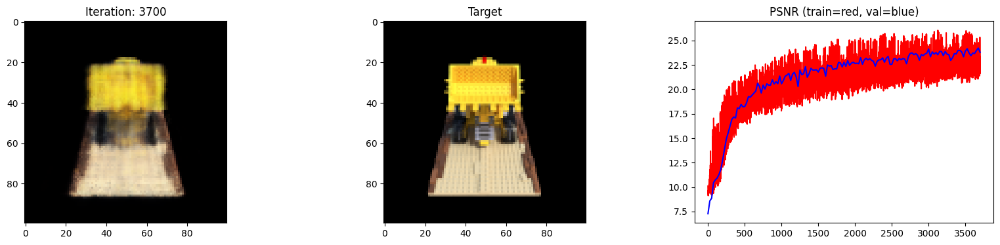

 37%|███▋      | 3725/10000 [28:42<44:58,  2.33it/s]

Loss: 0.004135339055210352


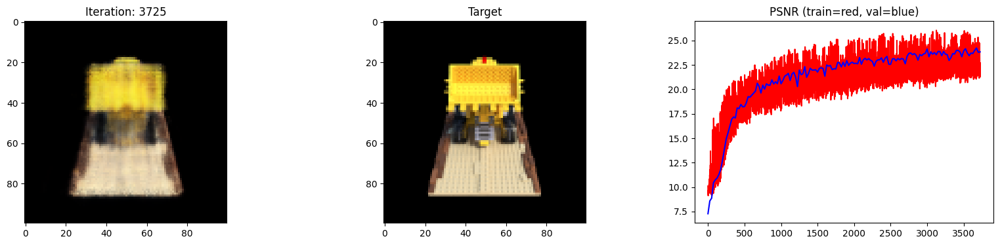

 38%|███▊      | 3750/10000 [28:53<44:45,  2.33it/s]

Loss: 0.004170754458755255


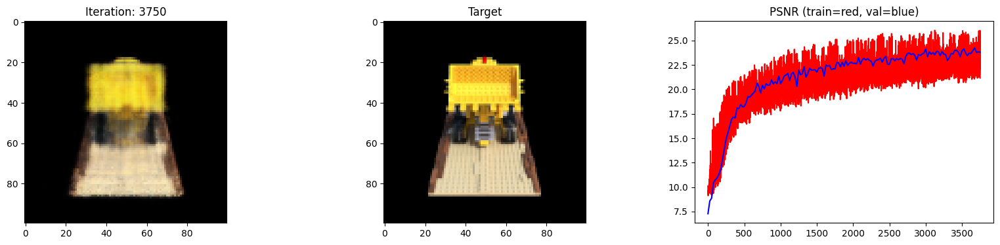

 38%|███▊      | 3775/10000 [29:05<44:31,  2.33it/s]

Loss: 0.004111957270652056


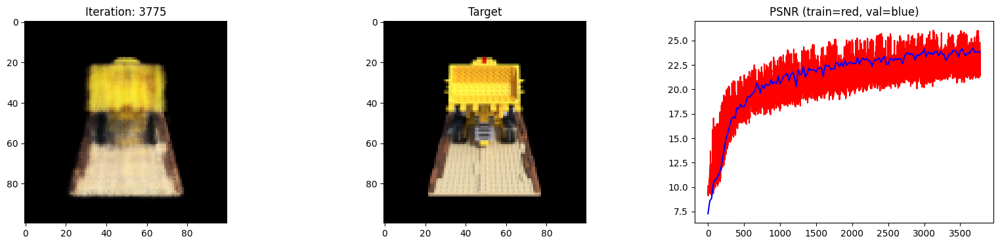

 38%|███▊      | 3800/10000 [29:17<44:21,  2.33it/s]

Loss: 0.00427766190841794


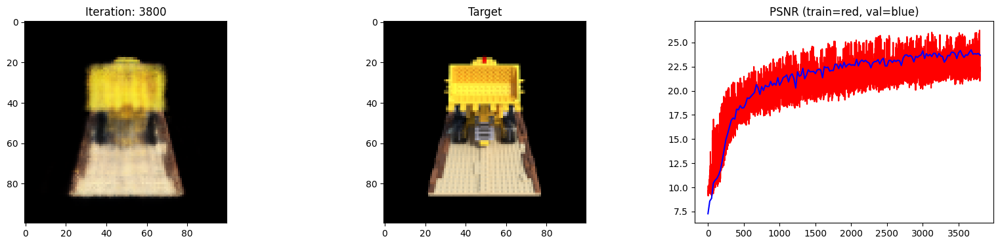

 38%|███▊      | 3825/10000 [29:28<44:16,  2.32it/s]

Loss: 0.0040567368268966675


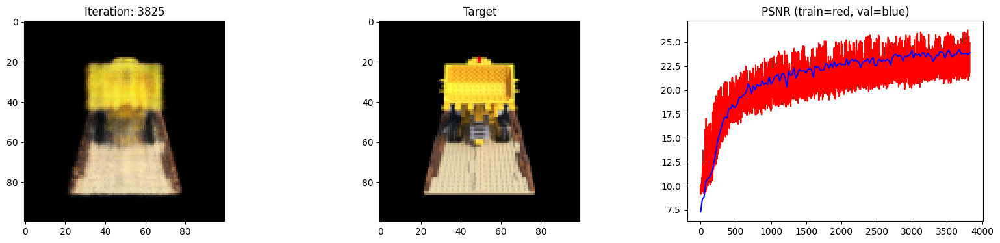

 38%|███▊      | 3850/10000 [29:40<44:10,  2.32it/s]

Loss: 0.004402007907629013


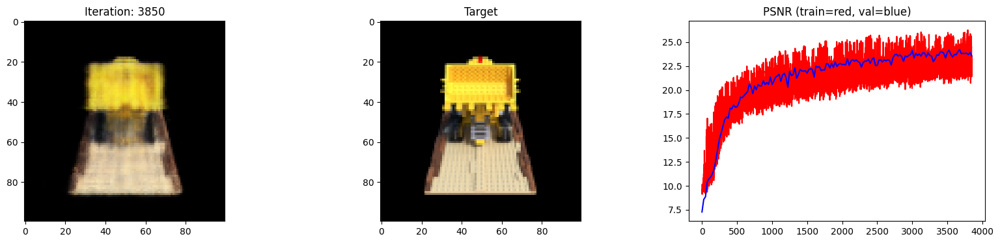

 39%|███▉      | 3875/10000 [29:51<44:05,  2.32it/s]

Loss: 0.004291961435228586


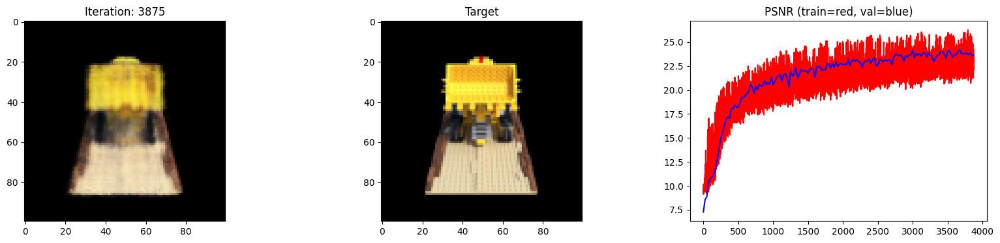

 39%|███▉      | 3900/10000 [30:03<43:54,  2.32it/s]

Loss: 0.003962508402764797


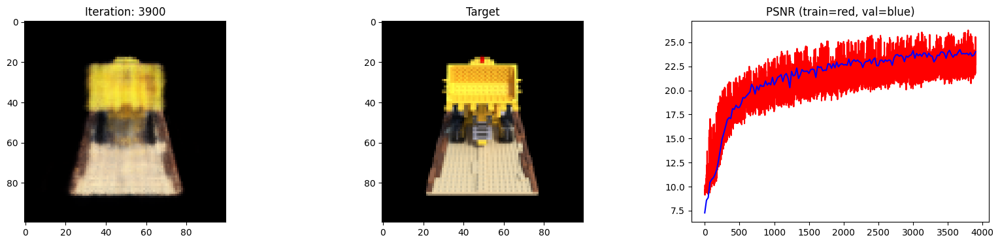

 39%|███▉      | 3925/10000 [30:15<43:46,  2.31it/s]

Loss: 0.0043398491106927395


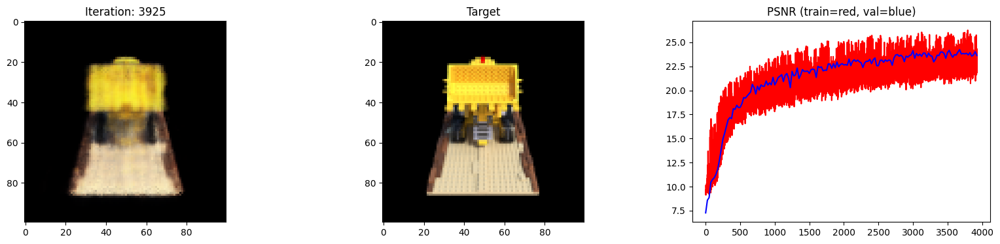

 40%|███▉      | 3950/10000 [30:27<43:13,  2.33it/s]

Loss: 0.004200768191367388


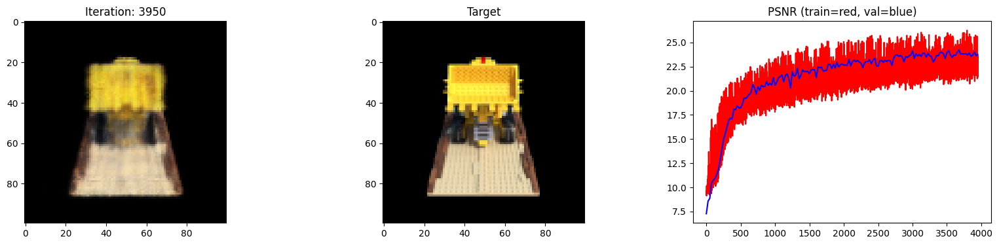

 40%|███▉      | 3975/10000 [30:39<43:05,  2.33it/s]

Loss: 0.004336392041295767


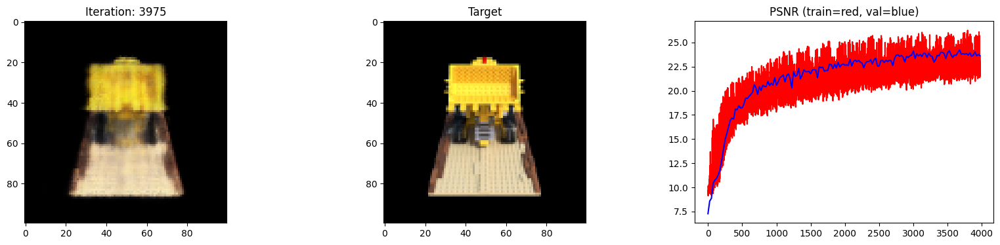

 40%|████      | 4000/10000 [30:50<43:05,  2.32it/s]

Loss: 0.004349082708358765


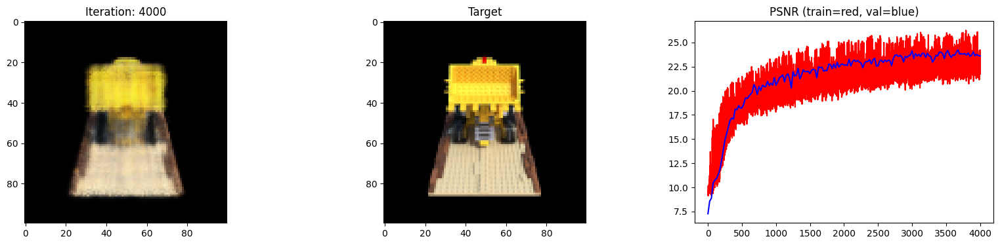

 40%|████      | 4025/10000 [31:02<42:46,  2.33it/s]

Loss: 0.004247983917593956


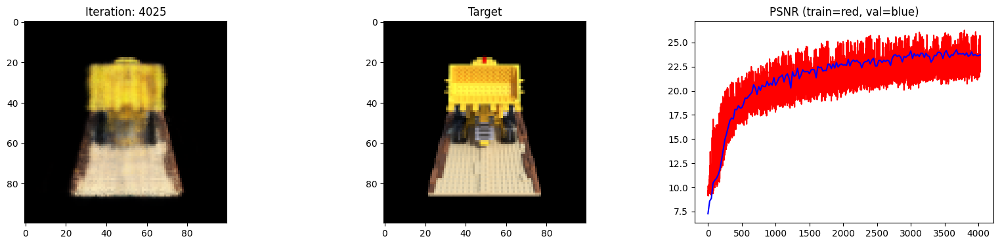

 40%|████      | 4050/10000 [31:13<42:32,  2.33it/s]

Loss: 0.004077248275279999


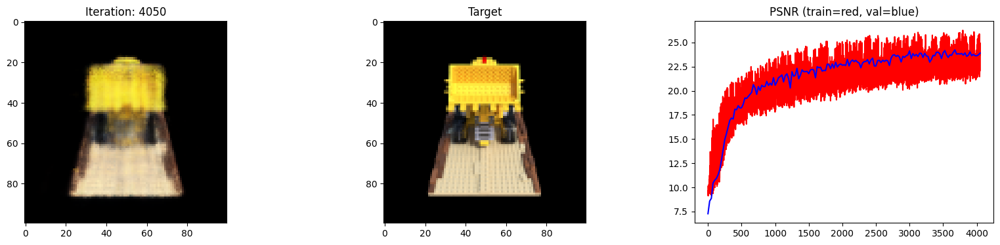

 41%|████      | 4075/10000 [31:25<42:30,  2.32it/s]

Loss: 0.004091845825314522


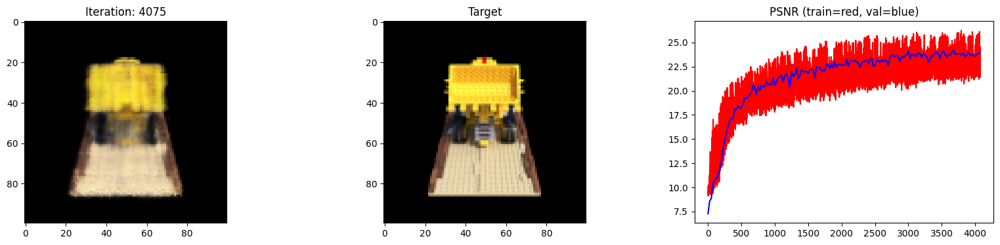

 41%|████      | 4100/10000 [31:37<42:32,  2.31it/s]

Loss: 0.003925819415599108


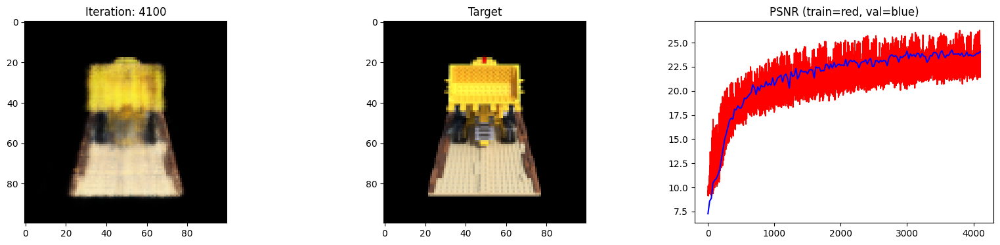

 41%|████▏     | 4125/10000 [31:48<42:32,  2.30it/s]

Loss: 0.0037888207007199526


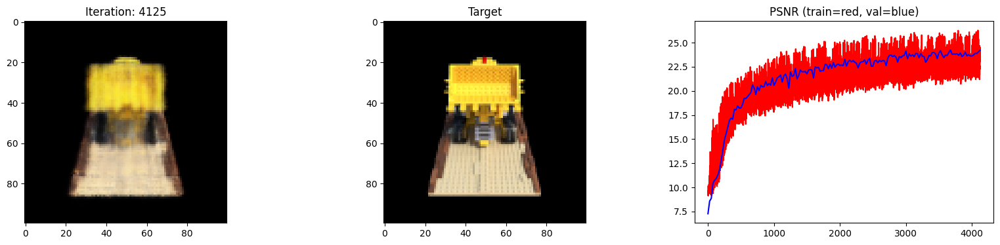

 42%|████▏     | 4150/10000 [32:00<41:59,  2.32it/s]

Loss: 0.004247982520610094


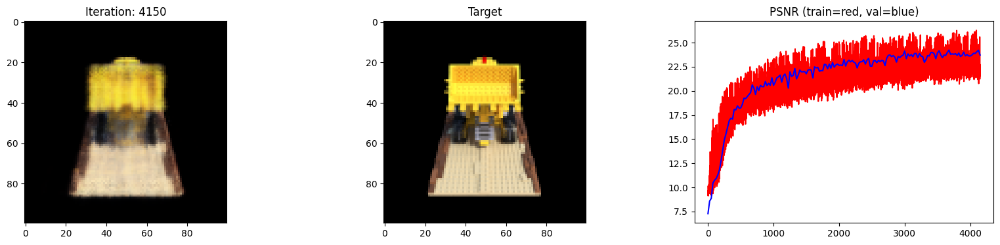

 42%|████▏     | 4175/10000 [32:12<41:40,  2.33it/s]

Loss: 0.004147475119680166


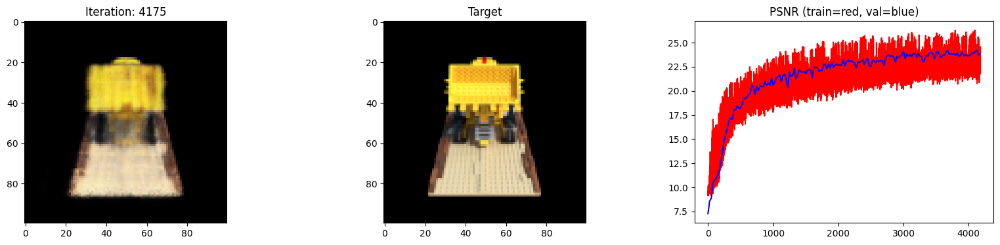

 42%|████▏     | 4200/10000 [32:23<41:31,  2.33it/s]

Loss: 0.003554371651262045


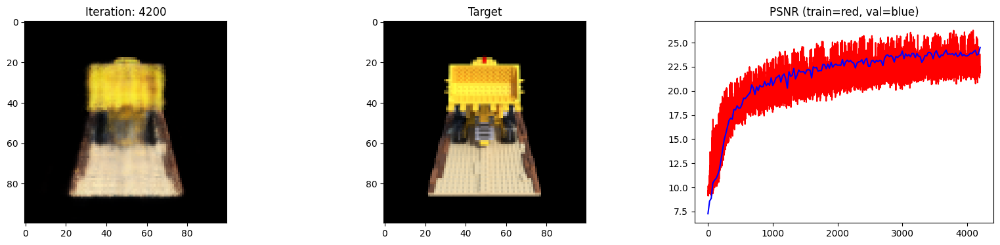

 42%|████▏     | 4225/10000 [32:35<41:24,  2.32it/s]

Loss: 0.0037983516231179237


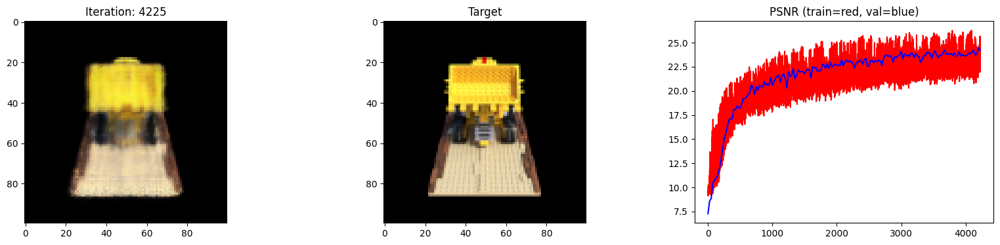

 42%|████▎     | 4250/10000 [32:47<41:08,  2.33it/s]

Loss: 0.004014788661152124


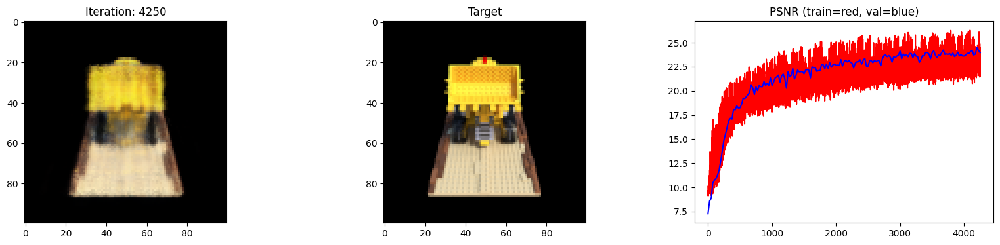

 43%|████▎     | 4275/10000 [32:58<41:00,  2.33it/s]

Loss: 0.003850543173030019


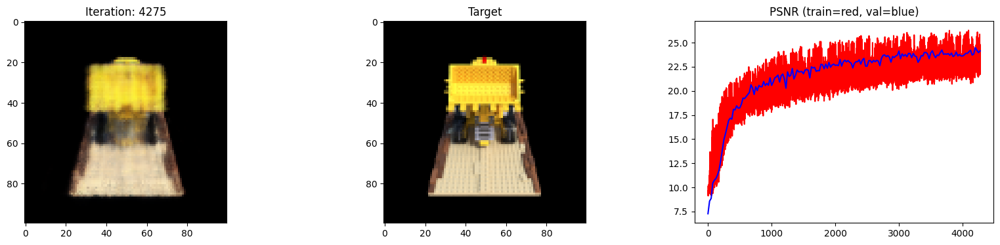

 43%|████▎     | 4300/10000 [33:10<40:57,  2.32it/s]

Loss: 0.004060619045048952


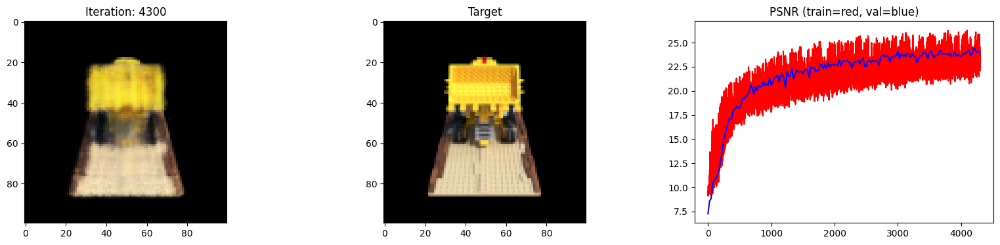

 43%|████▎     | 4325/10000 [33:21<40:58,  2.31it/s]

Loss: 0.003716810140758753


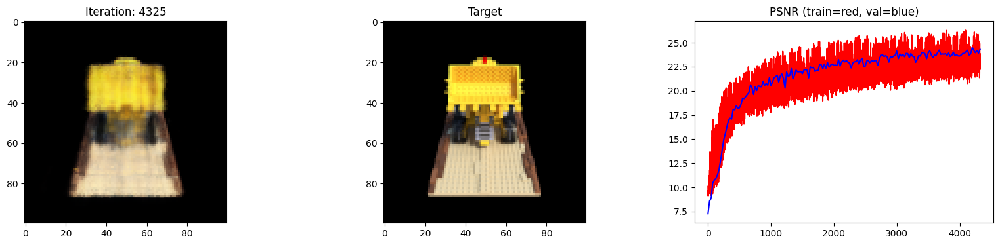

 44%|████▎     | 4350/10000 [33:33<40:53,  2.30it/s]

Loss: 0.004575931001454592


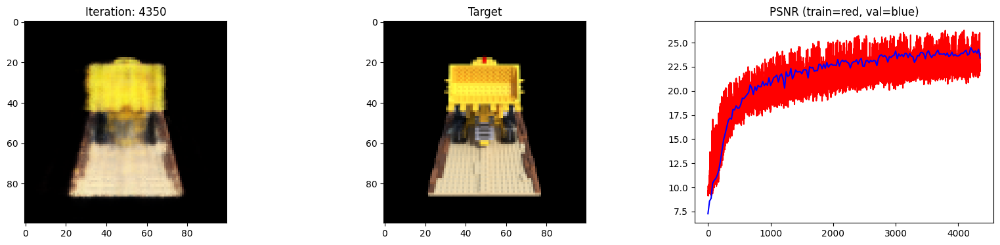

 44%|████▍     | 4375/10000 [33:45<40:26,  2.32it/s]

Loss: 0.003805923042818904


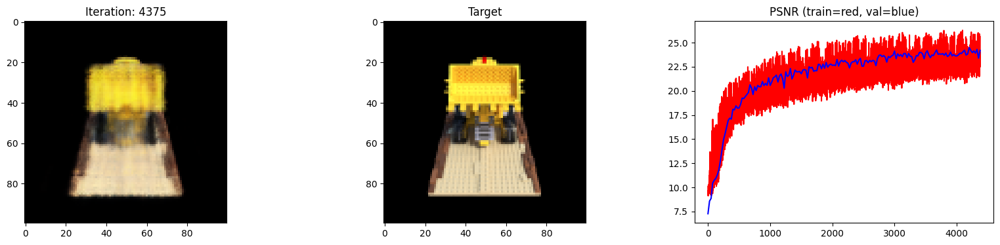

 44%|████▍     | 4400/10000 [33:56<40:10,  2.32it/s]

Loss: 0.003691296325996518


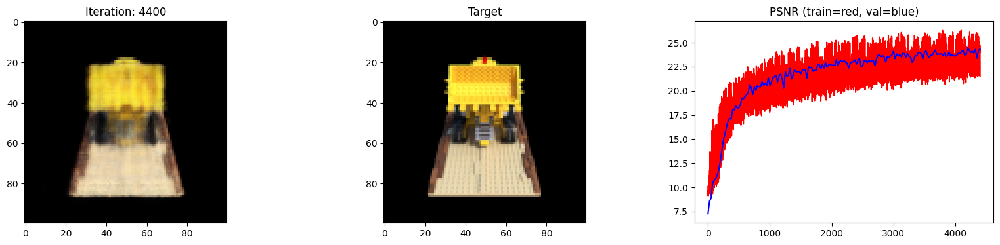

 44%|████▍     | 4425/10000 [34:08<39:56,  2.33it/s]

Loss: 0.003885095240548253


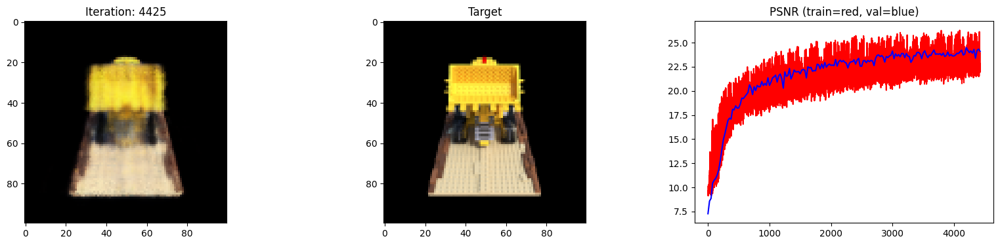

 44%|████▍     | 4450/10000 [34:20<39:47,  2.32it/s]

Loss: 0.0038678140845149755


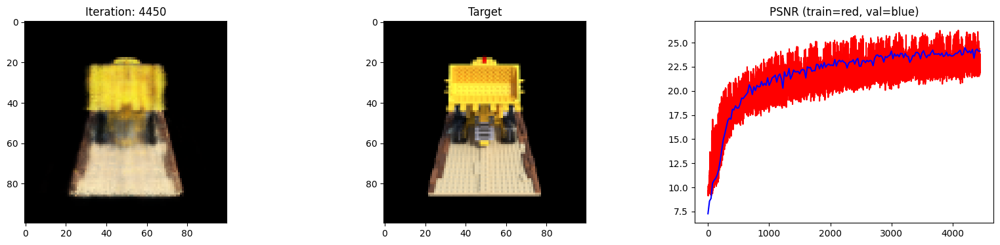

 45%|████▍     | 4475/10000 [34:31<39:36,  2.32it/s]

Loss: 0.0038909651339054108


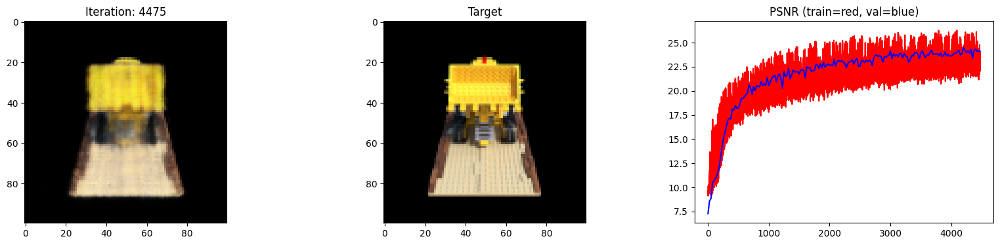

 45%|████▌     | 4500/10000 [34:43<39:23,  2.33it/s]

Loss: 0.0038257695268839598


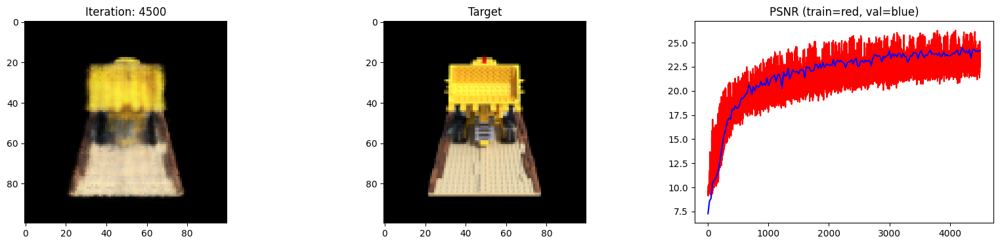

 45%|████▌     | 4525/10000 [34:55<39:19,  2.32it/s]

Loss: 0.0039197527803480625


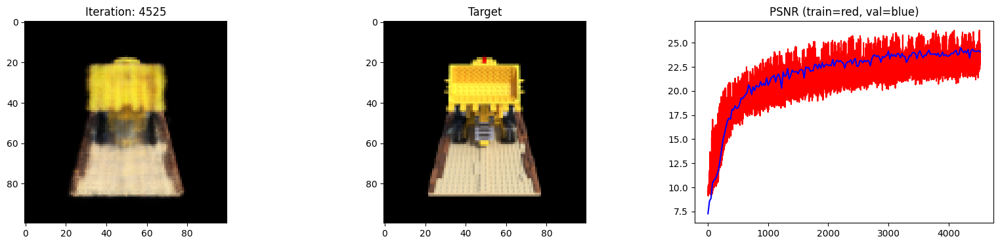

 46%|████▌     | 4550/10000 [35:06<39:16,  2.31it/s]

Loss: 0.003799411002546549


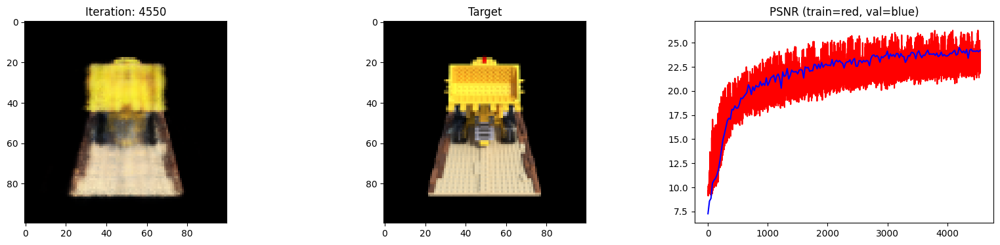

 46%|████▌     | 4575/10000 [35:18<38:55,  2.32it/s]

Loss: 0.00379863940179348


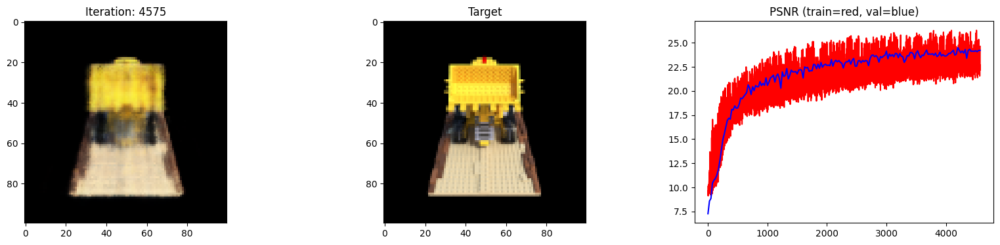

 46%|████▌     | 4600/10000 [35:30<38:40,  2.33it/s]

Loss: 0.0038684476166963577


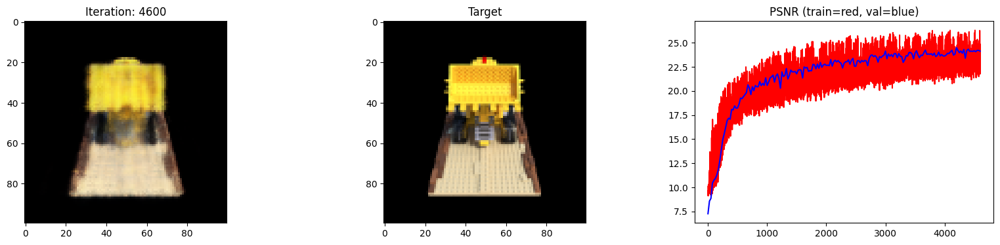

 46%|████▋     | 4625/10000 [35:41<38:29,  2.33it/s]

Loss: 0.004226112738251686


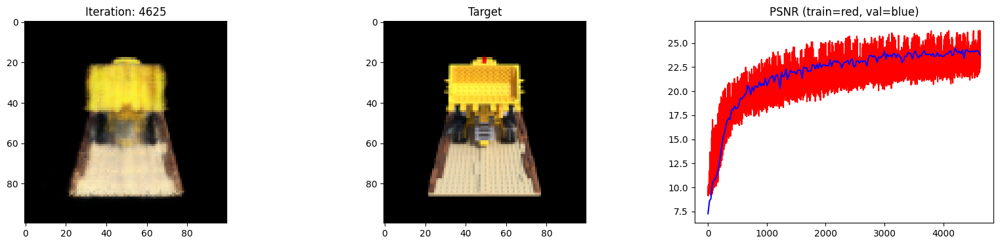

 46%|████▋     | 4650/10000 [35:53<38:16,  2.33it/s]

Loss: 0.0039001668337732553


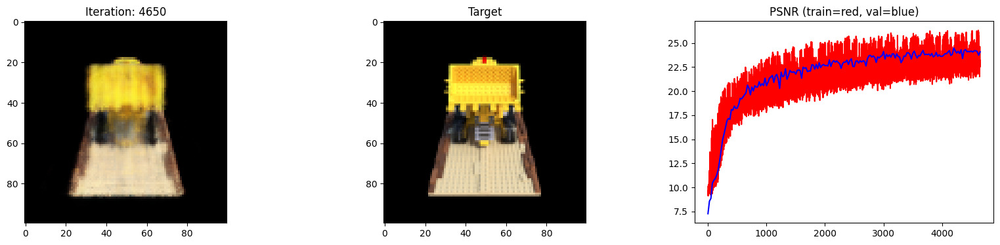

 47%|████▋     | 4675/10000 [36:05<38:04,  2.33it/s]

Loss: 0.003983347676694393


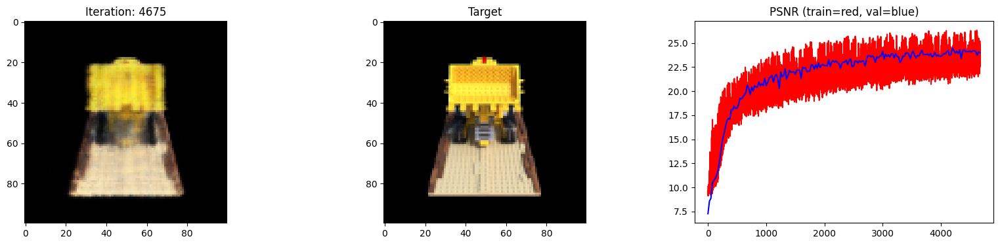

 47%|████▋     | 4700/10000 [36:16<37:58,  2.33it/s]

Loss: 0.003745575901120901


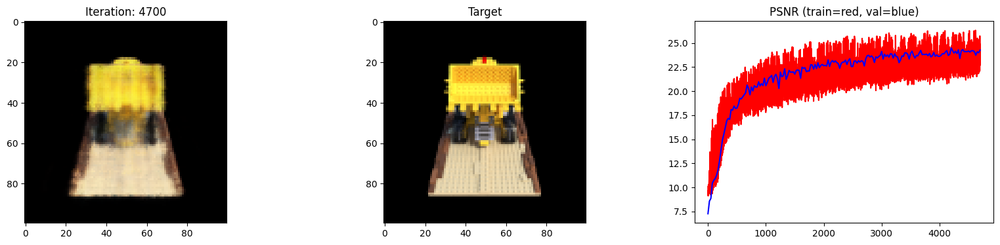

 47%|████▋     | 4725/10000 [36:28<37:52,  2.32it/s]

Loss: 0.0034297017846256495


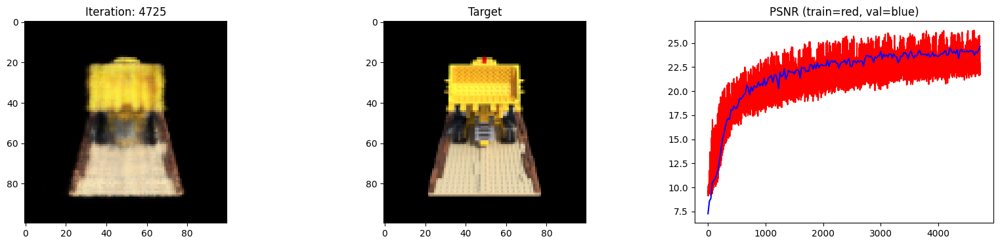

 48%|████▊     | 4750/10000 [36:39<37:50,  2.31it/s]

Loss: 0.0036696854513138533


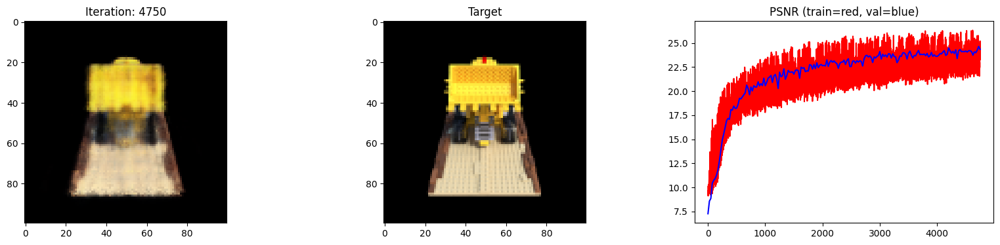

 48%|████▊     | 4775/10000 [36:51<37:27,  2.32it/s]

Loss: 0.003837412456050515


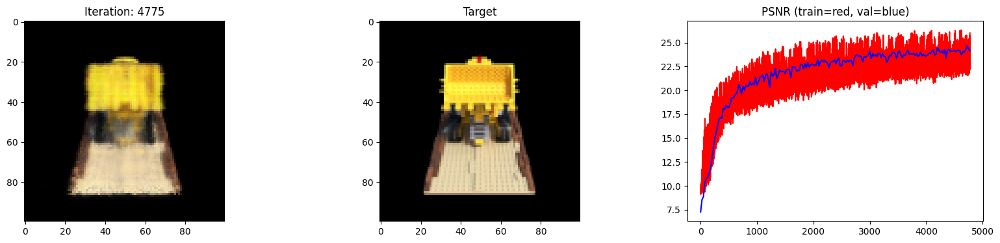

 48%|████▊     | 4800/10000 [37:03<37:11,  2.33it/s]

Loss: 0.004073848482221365


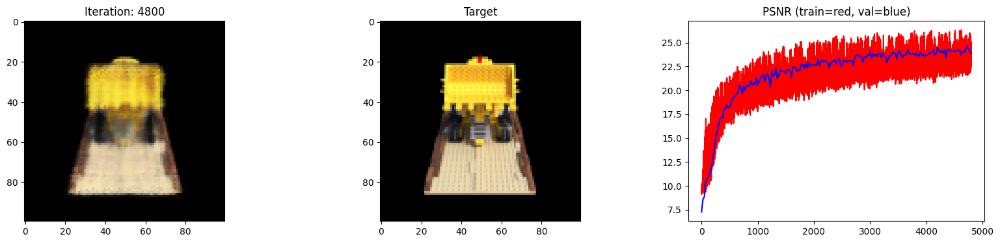

 48%|████▊     | 4825/10000 [37:15<37:00,  2.33it/s]

Loss: 0.003331741550937295


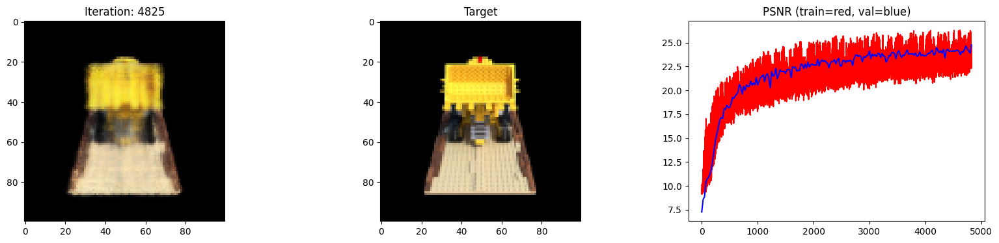

 48%|████▊     | 4850/10000 [37:26<36:52,  2.33it/s]

Loss: 0.003259602701291442


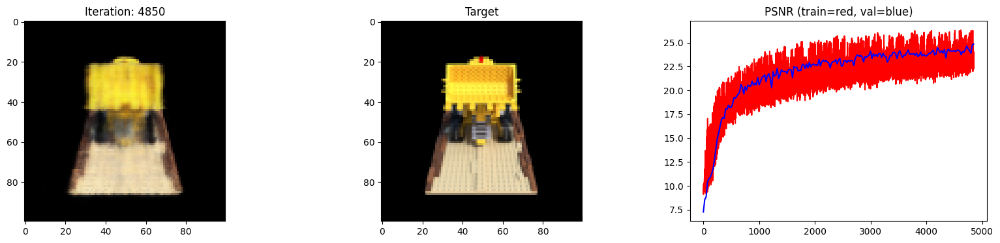

 49%|████▉     | 4875/10000 [37:38<36:40,  2.33it/s]

Loss: 0.0034618698991835117


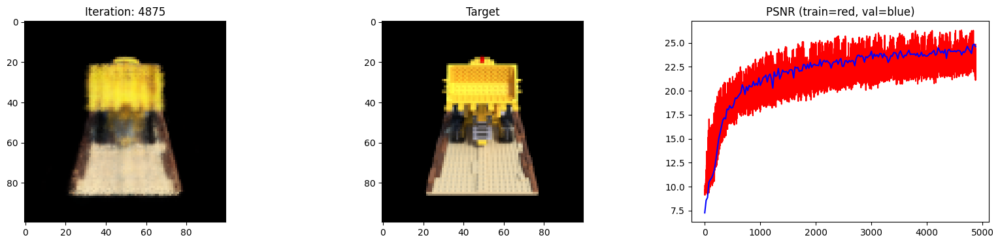

 49%|████▉     | 4900/10000 [37:50<36:37,  2.32it/s]

Loss: 0.003467088332399726


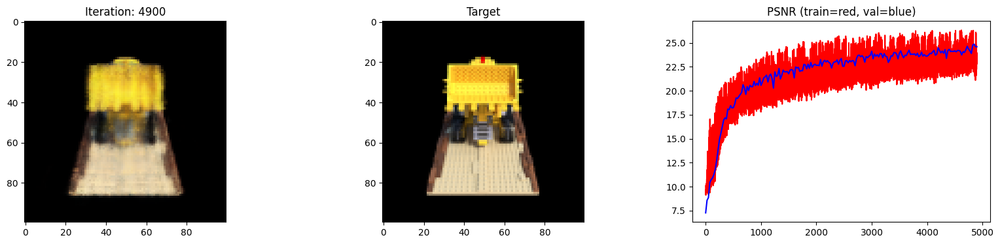

 49%|████▉     | 4925/10000 [38:01<36:30,  2.32it/s]

Loss: 0.003522785846143961


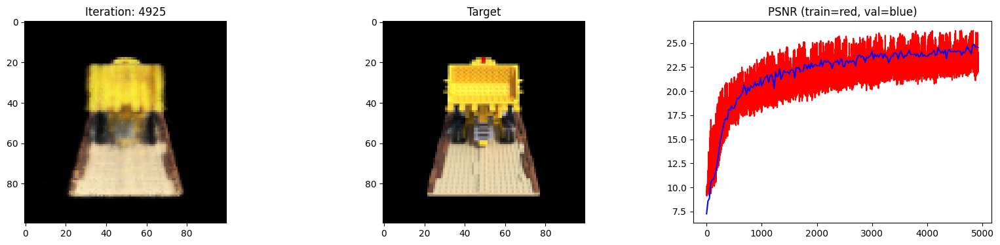

 50%|████▉     | 4950/10000 [38:13<36:22,  2.31it/s]

Loss: 0.0033550180960446596


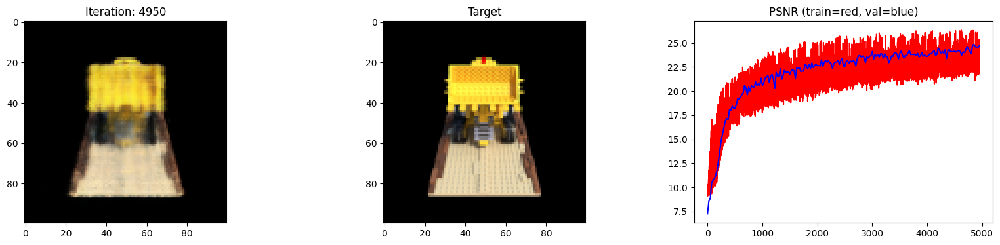

 50%|████▉     | 4975/10000 [38:25<35:59,  2.33it/s]

Loss: 0.003372945124283433


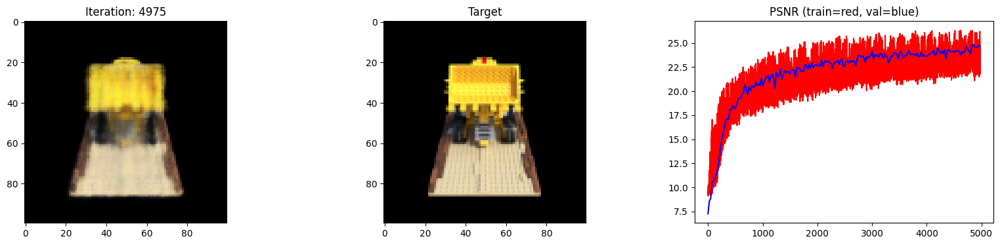

 50%|█████     | 5000/10000 [38:36<35:49,  2.33it/s]

Loss: 0.003303025383502245


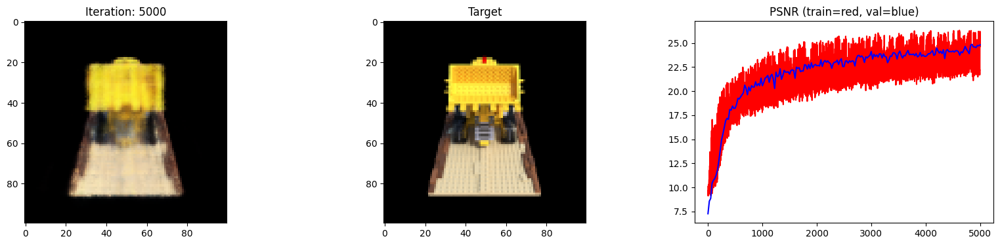

 50%|█████     | 5025/10000 [38:48<35:36,  2.33it/s]

Loss: 0.0032841539941728115


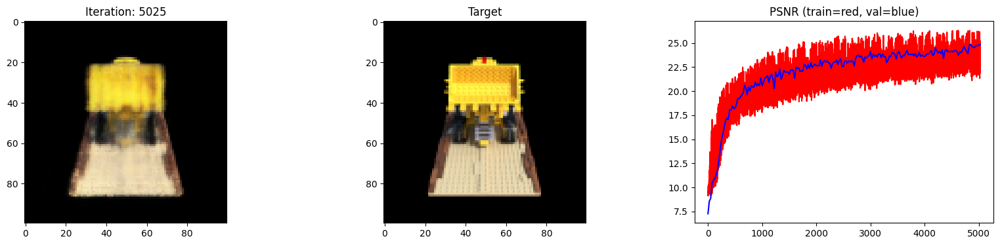

 50%|█████     | 5050/10000 [39:00<35:31,  2.32it/s]

Loss: 0.0034335677046328783


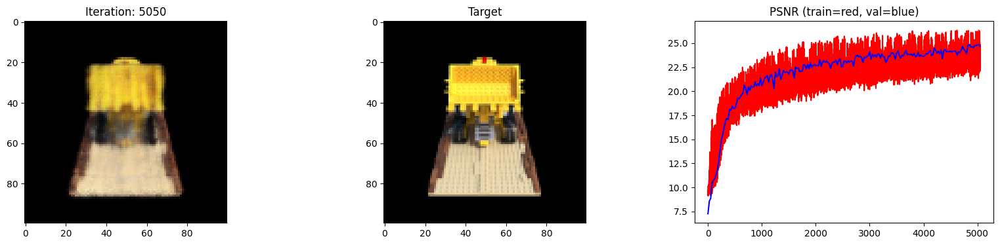

 51%|█████     | 5075/10000 [39:12<35:16,  2.33it/s]

Loss: 0.003472780343145132


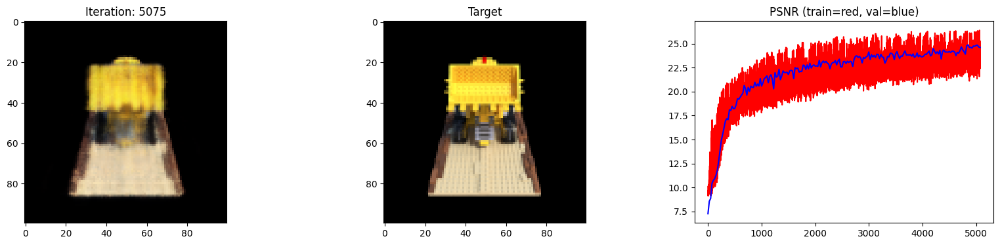

 51%|█████     | 5100/10000 [39:23<35:14,  2.32it/s]

Loss: 0.003685097210109234


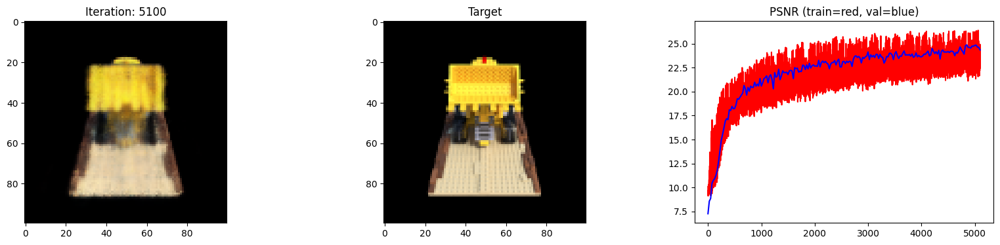

 51%|█████▏    | 5125/10000 [39:35<35:25,  2.29it/s]

Loss: 0.003566362662240863


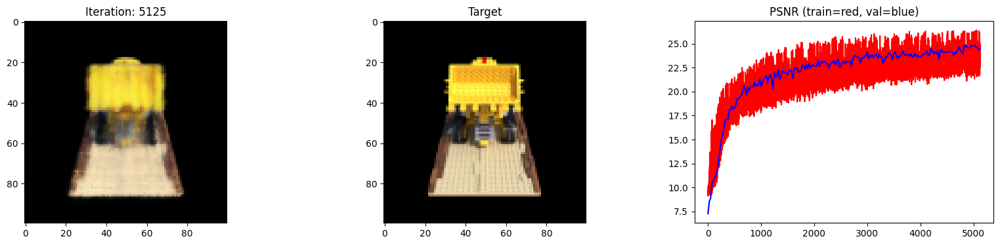

 52%|█████▏    | 5150/10000 [39:46<34:47,  2.32it/s]

Loss: 0.0033929108176380396


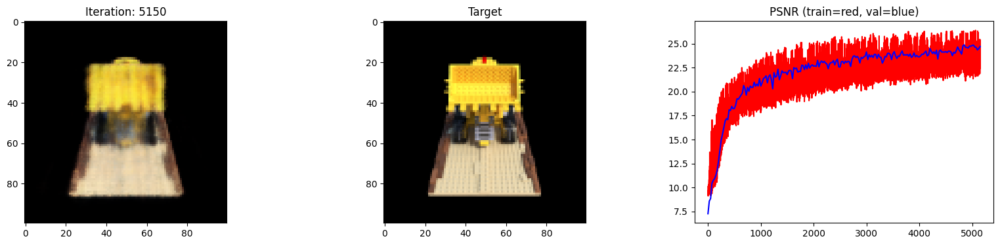

 52%|█████▏    | 5175/10000 [39:58<34:30,  2.33it/s]

Loss: 0.003442975692451


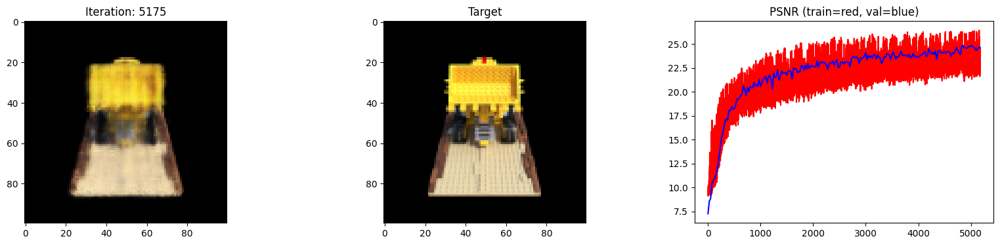

 52%|█████▏    | 5200/10000 [40:10<34:21,  2.33it/s]

Loss: 0.003268666099756956


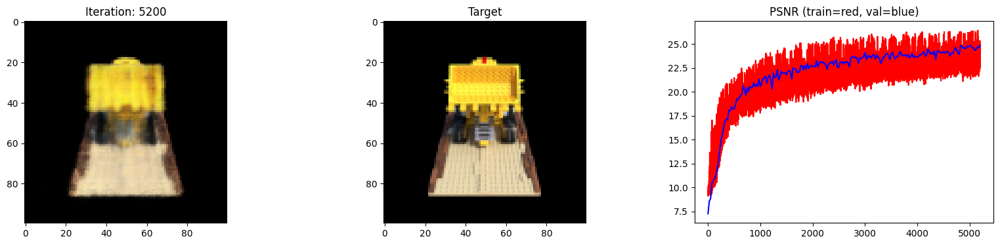

 52%|█████▏    | 5225/10000 [40:22<34:08,  2.33it/s]

Loss: 0.00380411627702415


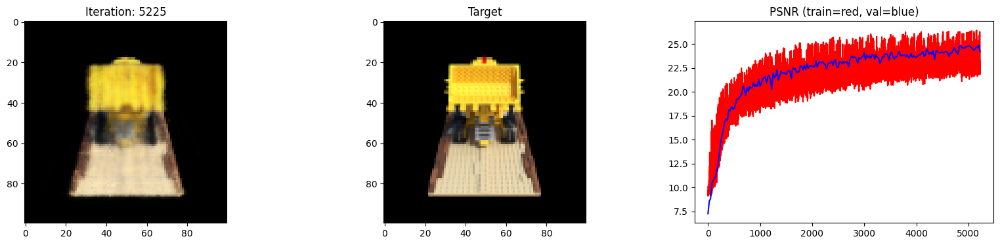

 52%|█████▎    | 5250/10000 [40:33<34:04,  2.32it/s]

Loss: 0.003757621394470334


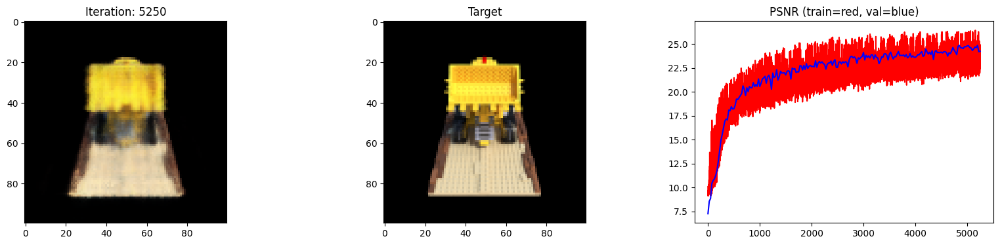

 53%|█████▎    | 5275/10000 [40:45<33:50,  2.33it/s]

Loss: 0.003482719650492072


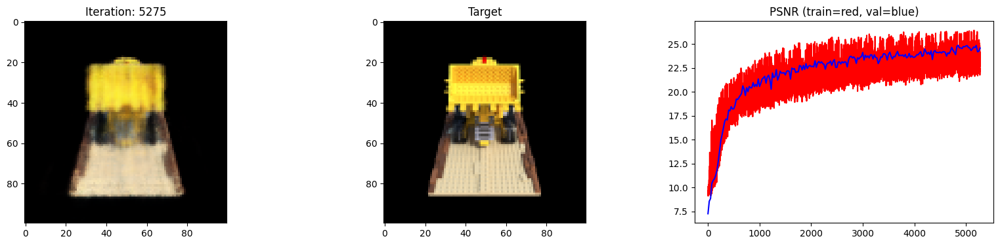

 53%|█████▎    | 5300/10000 [40:57<34:06,  2.30it/s]

Loss: 0.0035042143426835537


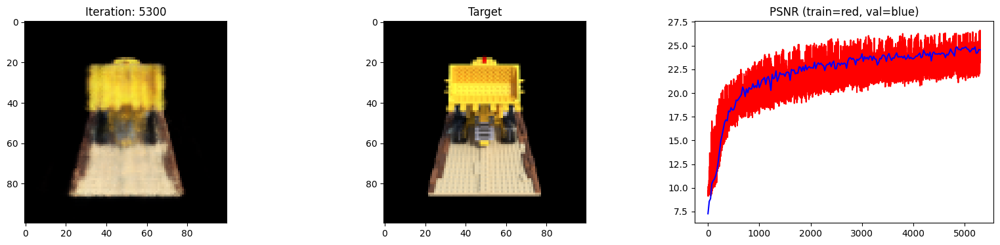

 53%|█████▎    | 5325/10000 [41:08<33:53,  2.30it/s]

Loss: 0.003351058578118682


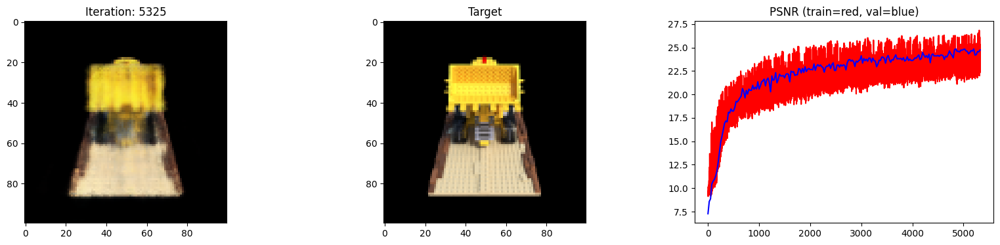

 54%|█████▎    | 5350/10000 [41:20<33:19,  2.33it/s]

Loss: 0.0033456876408308744


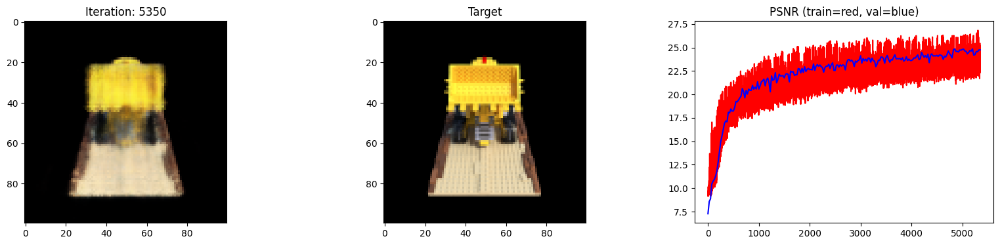

 54%|█████▍    | 5375/10000 [41:32<33:06,  2.33it/s]

Loss: 0.0035704276524484158


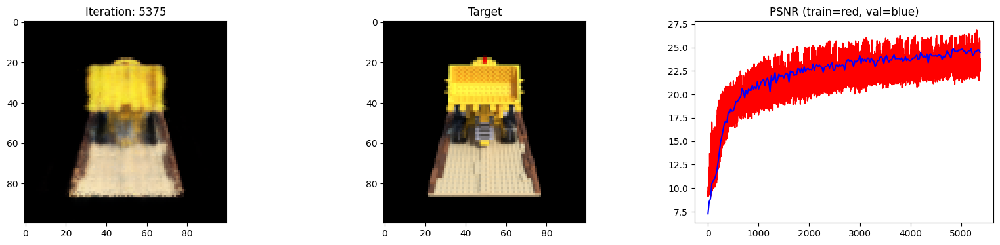

 54%|█████▍    | 5400/10000 [41:44<32:56,  2.33it/s]

Loss: 0.0036206161603331566


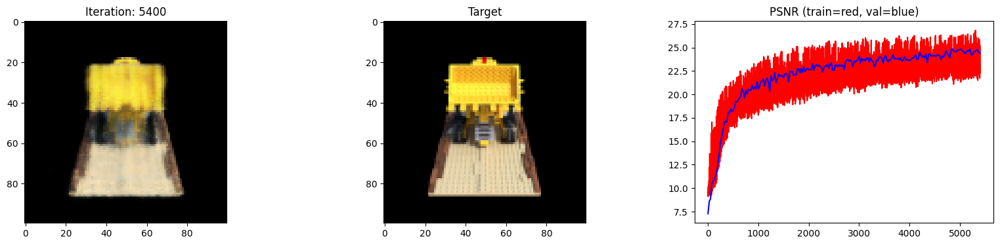

 54%|█████▍    | 5425/10000 [41:55<32:45,  2.33it/s]

Loss: 0.00354061764664948


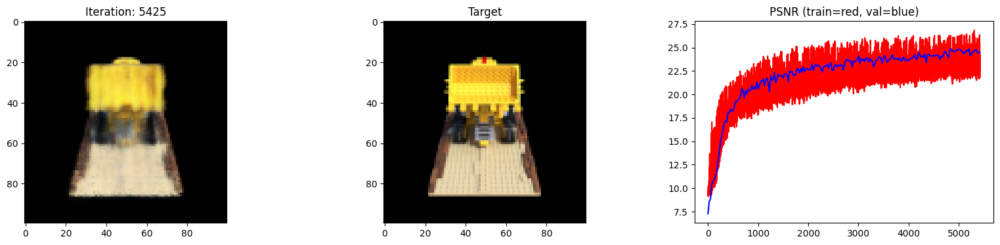

 55%|█████▍    | 5450/10000 [42:07<32:36,  2.33it/s]

Loss: 0.003560806391760707


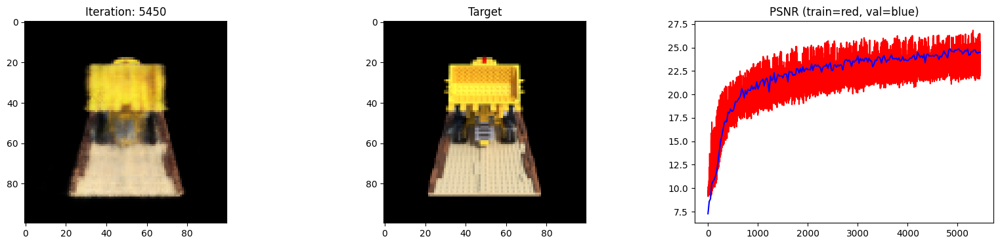

 55%|█████▍    | 5475/10000 [42:19<32:34,  2.31it/s]

Loss: 0.0035023894160985947


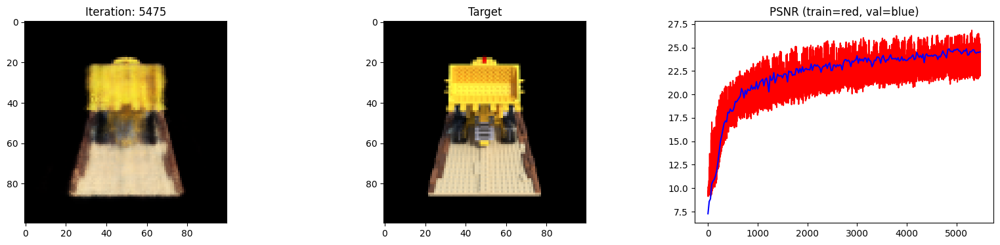

 55%|█████▌    | 5500/10000 [42:30<32:22,  2.32it/s]

Loss: 0.00328297377564013


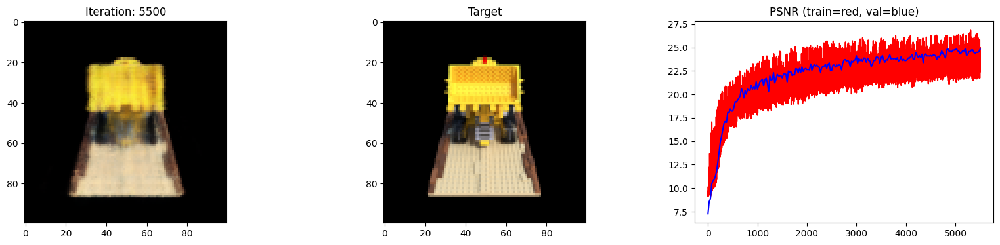

 55%|█████▌    | 5525/10000 [42:42<32:13,  2.31it/s]

Loss: 0.003944569732993841


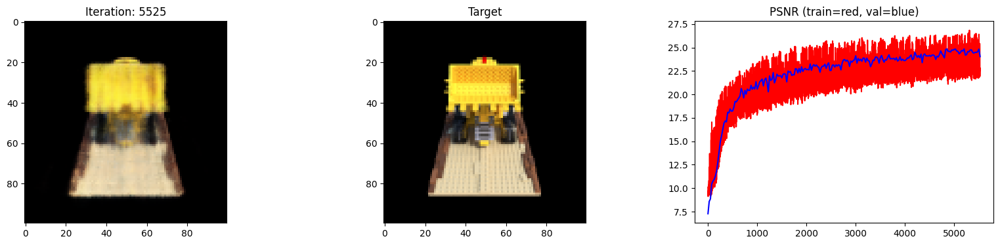

 56%|█████▌    | 5550/10000 [42:54<31:52,  2.33it/s]

Loss: 0.0038697505369782448


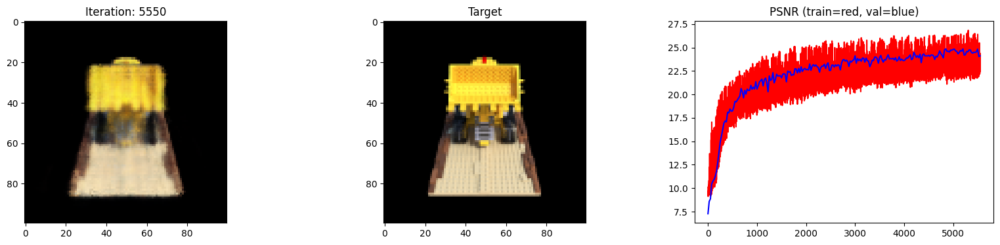

 56%|█████▌    | 5575/10000 [43:05<31:37,  2.33it/s]

Loss: 0.003991550300270319


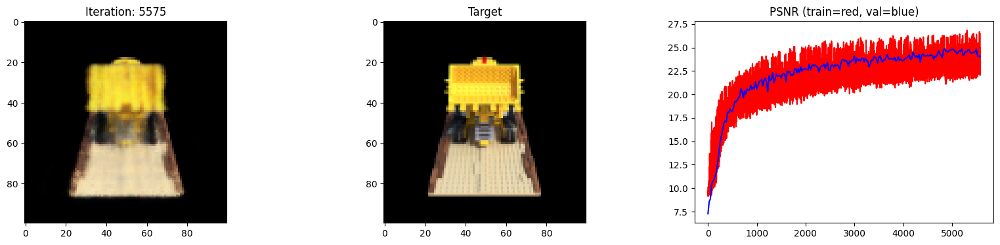

 56%|█████▌    | 5600/10000 [43:17<31:37,  2.32it/s]

Loss: 0.004569203592836857


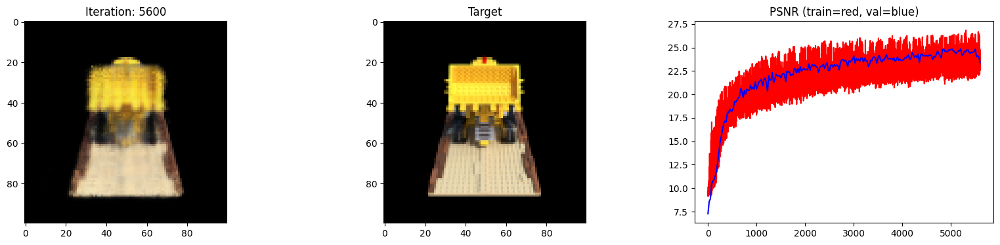

 56%|█████▋    | 5625/10000 [43:29<31:21,  2.33it/s]

Loss: 0.004007386974990368


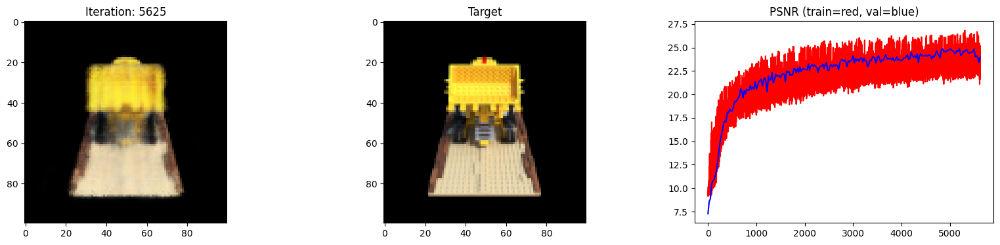

 56%|█████▋    | 5650/10000 [43:40<31:24,  2.31it/s]

Loss: 0.0037251112516969442


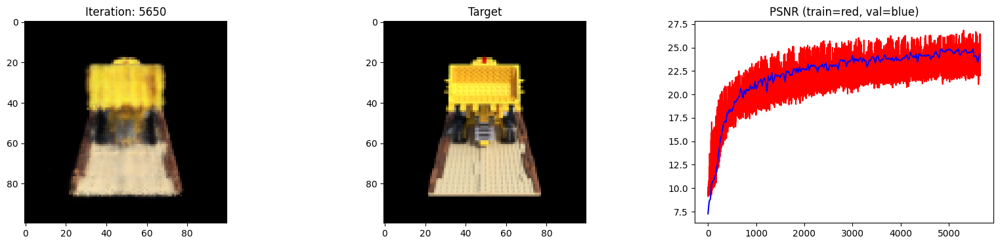

 57%|█████▋    | 5675/10000 [43:52<31:03,  2.32it/s]

Loss: 0.00335945887491107


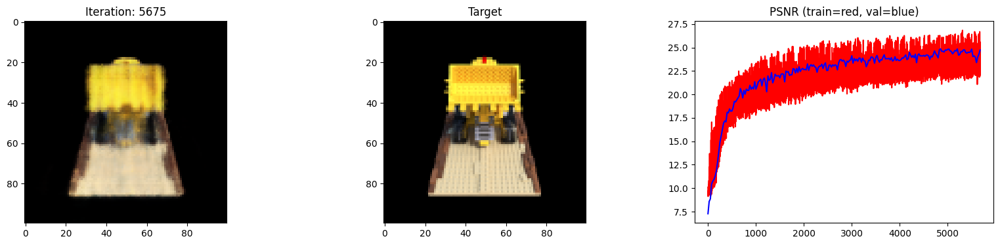

 57%|█████▋    | 5700/10000 [44:04<30:48,  2.33it/s]

Loss: 0.0038444160018116236


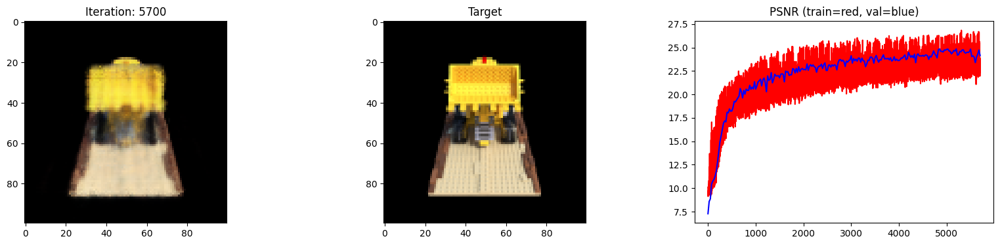

 57%|█████▋    | 5725/10000 [44:15<30:39,  2.32it/s]

Loss: 0.00403355760499835


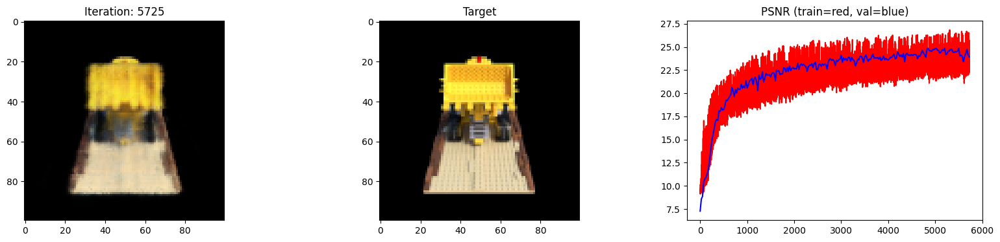

 57%|█████▊    | 5750/10000 [44:27<30:28,  2.32it/s]

Loss: 0.00328530790284276


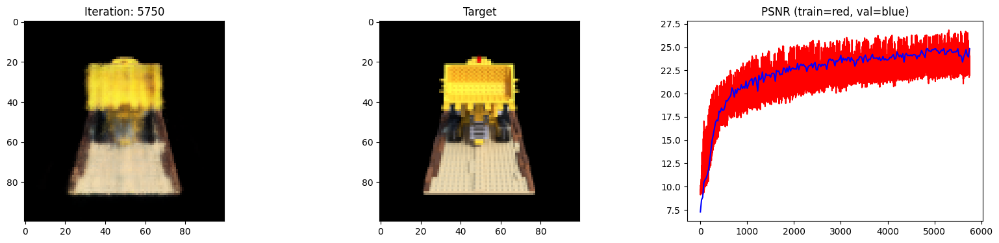

 58%|█████▊    | 5775/10000 [44:39<30:12,  2.33it/s]

Loss: 0.0034075600560754538


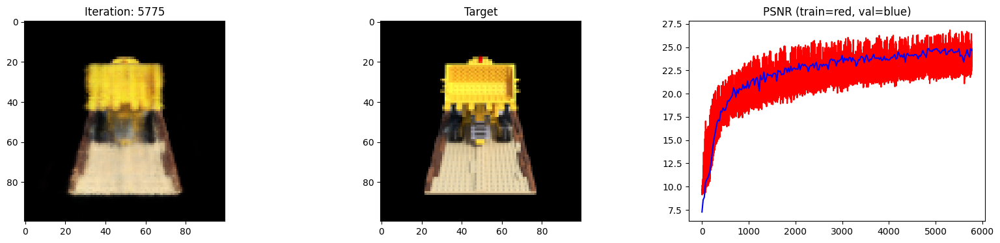

 58%|█████▊    | 5800/10000 [44:51<30:06,  2.33it/s]

Loss: 0.00309839122928679


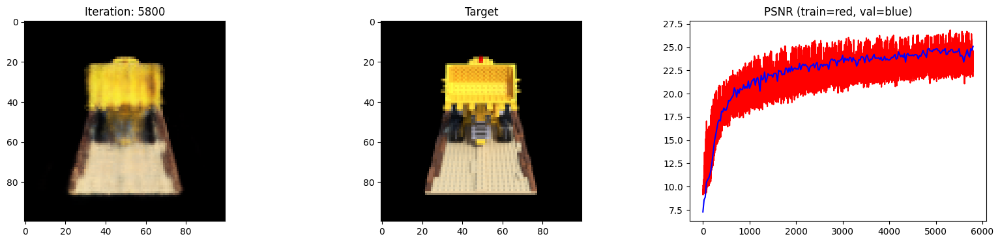

 58%|█████▊    | 5825/10000 [45:02<30:14,  2.30it/s]

Loss: 0.003077276749536395


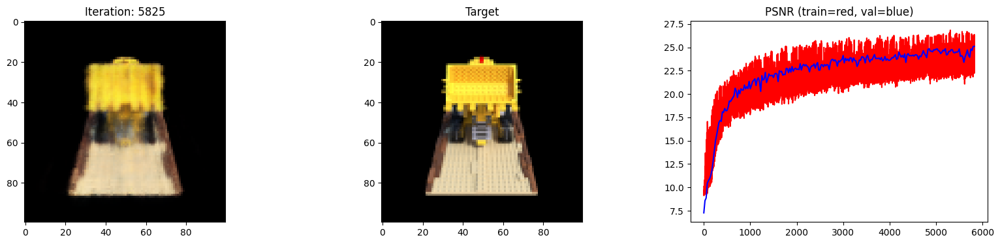

 58%|█████▊    | 5850/10000 [45:14<29:45,  2.32it/s]

Loss: 0.0031087168026715517


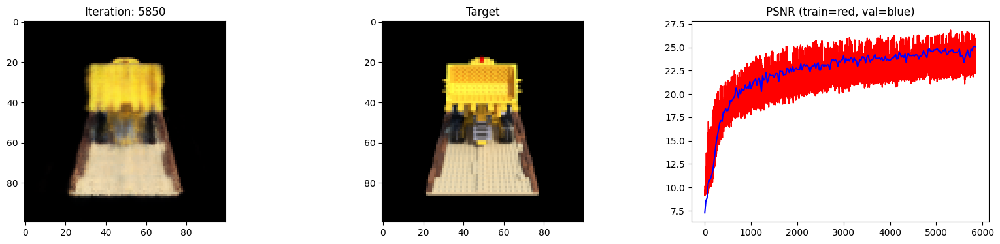

 59%|█████▉    | 5875/10000 [45:26<29:30,  2.33it/s]

Loss: 0.0033469381742179394


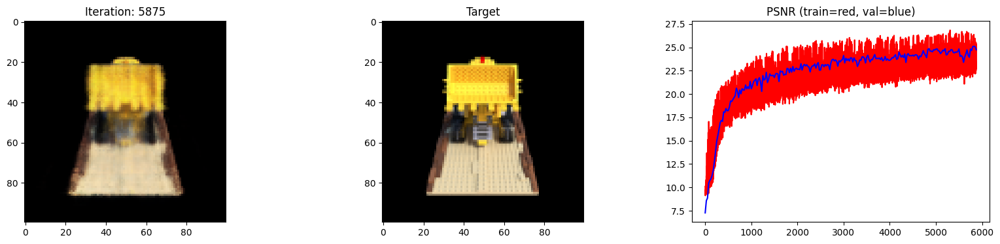

 59%|█████▉    | 5900/10000 [45:38<29:21,  2.33it/s]

Loss: 0.003526350250467658


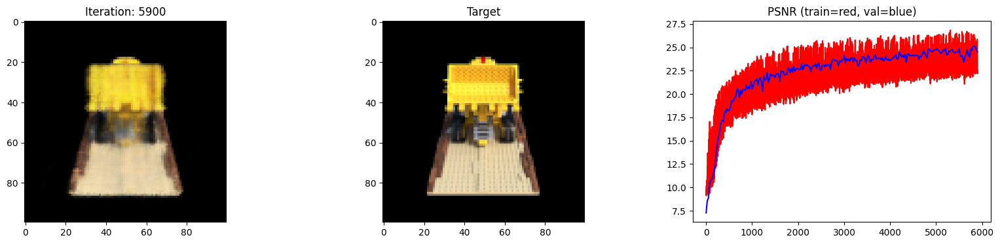

 59%|█████▉    | 5925/10000 [45:49<29:09,  2.33it/s]

Loss: 0.003689306788146496


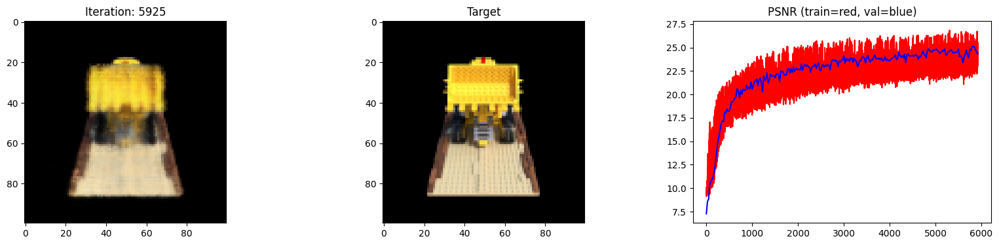

 60%|█████▉    | 5950/10000 [46:01<28:58,  2.33it/s]

Loss: 0.003490758128464222


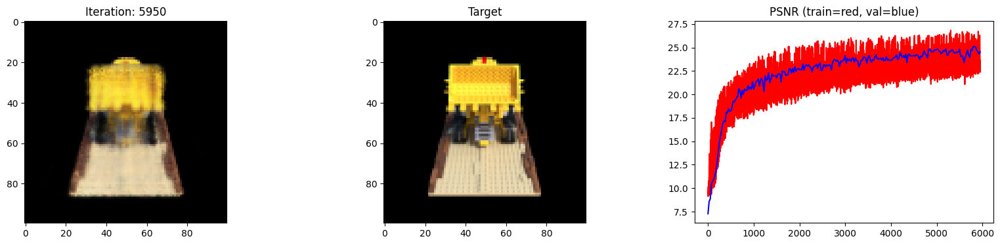

 60%|█████▉    | 5975/10000 [46:13<28:51,  2.33it/s]

Loss: 0.0032150843180716038


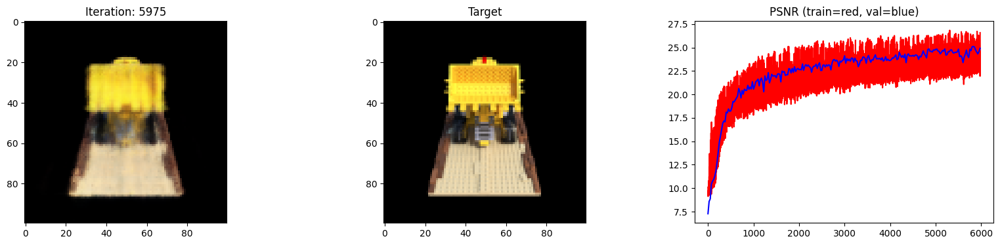

 60%|██████    | 6000/10000 [46:24<28:52,  2.31it/s]

Loss: 0.0033407455775886774


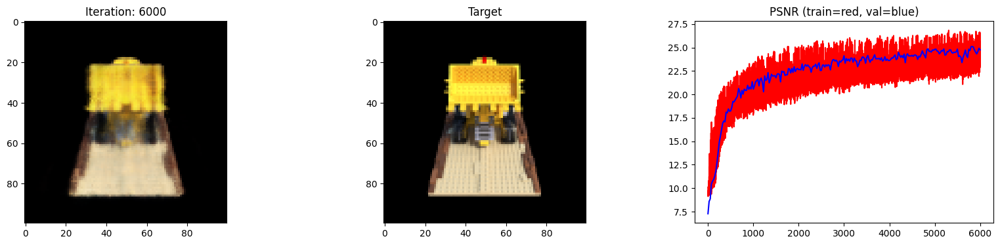

 60%|██████    | 6025/10000 [46:36<28:45,  2.30it/s]

Loss: 0.003000300144776702


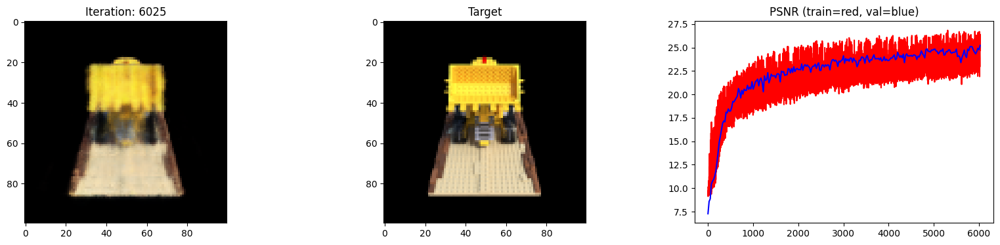

 60%|██████    | 6050/10000 [46:48<28:19,  2.32it/s]

Loss: 0.00310618057847023


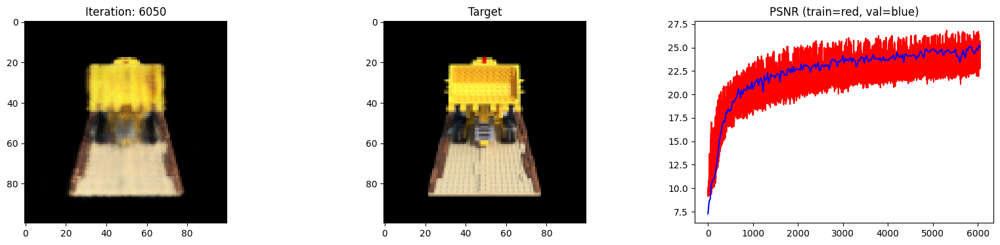

 61%|██████    | 6075/10000 [47:00<28:09,  2.32it/s]

Loss: 0.003453308716416359


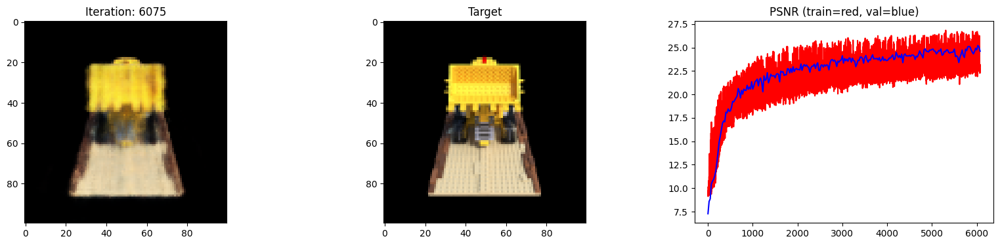

 61%|██████    | 6100/10000 [47:11<27:54,  2.33it/s]

Loss: 0.003065353026613593


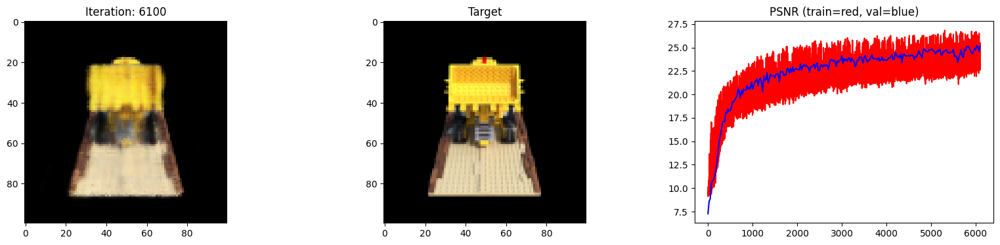

 61%|██████▏   | 6125/10000 [47:23<27:43,  2.33it/s]

Loss: 0.0031861632596701384


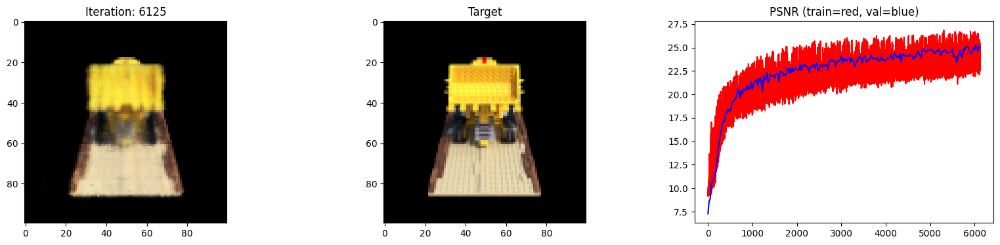

 62%|██████▏   | 6150/10000 [47:35<27:40,  2.32it/s]

Loss: 0.00342528335750103


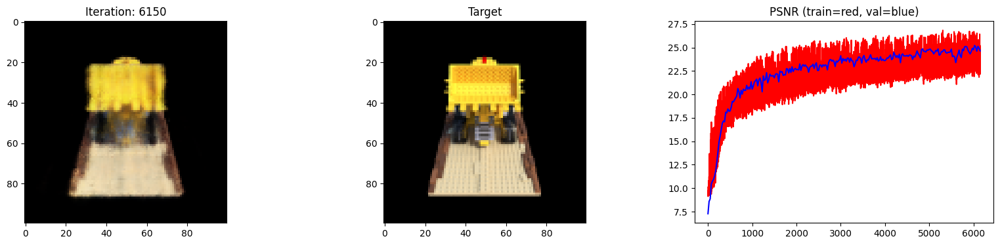

 62%|██████▏   | 6175/10000 [47:46<27:38,  2.31it/s]

Loss: 0.00323701580055058


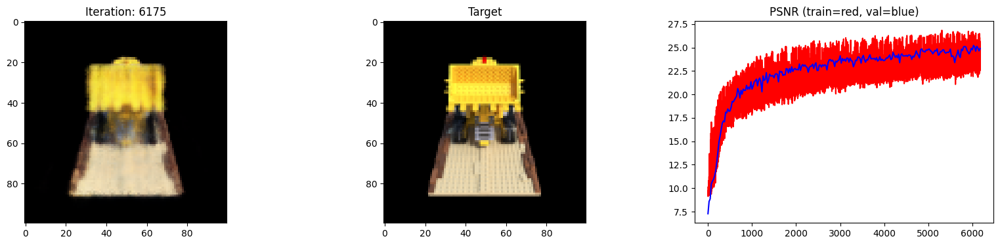

 62%|██████▏   | 6200/10000 [47:58<27:15,  2.32it/s]

Loss: 0.0033122384920716286


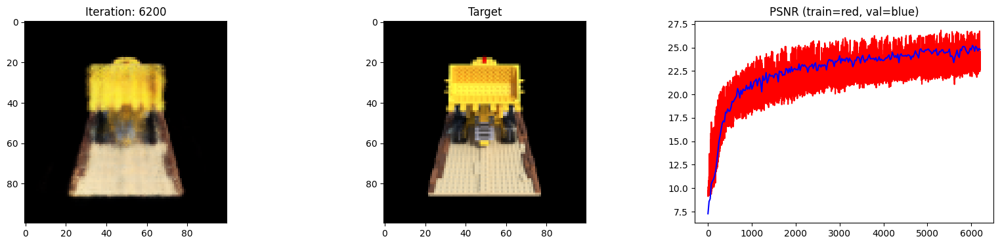

 62%|██████▏   | 6225/10000 [48:10<27:01,  2.33it/s]

Loss: 0.0033877508249133825


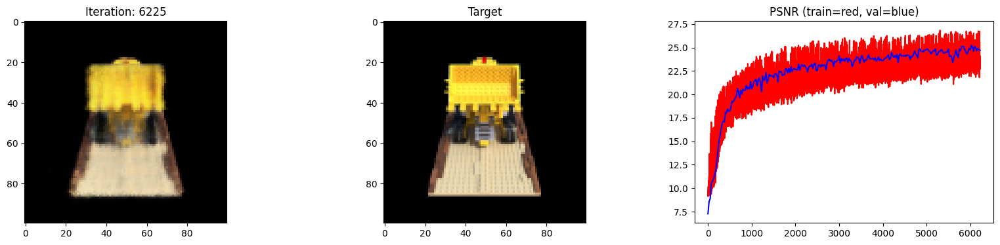

 62%|██████▎   | 6250/10000 [48:21<26:48,  2.33it/s]

Loss: 0.003643035190179944


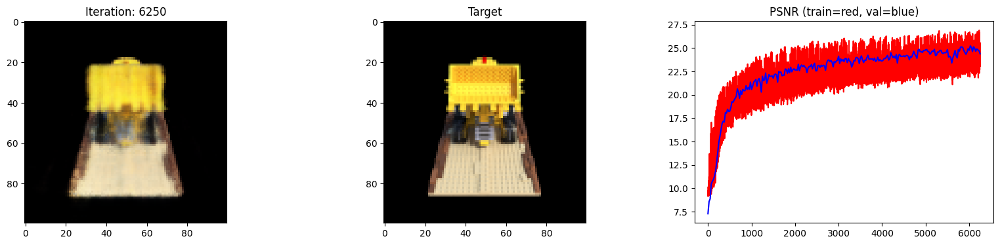

 63%|██████▎   | 6275/10000 [48:33<26:37,  2.33it/s]

Loss: 0.003368265461176634


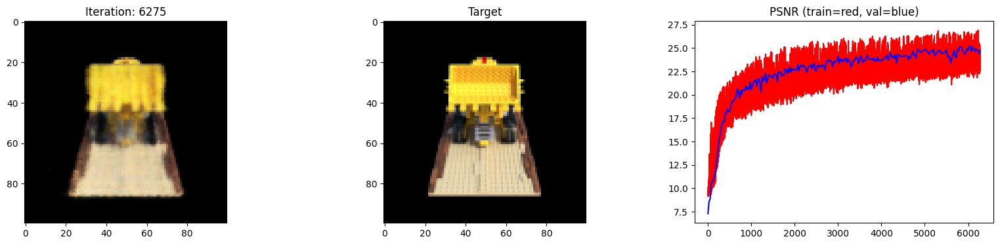

 63%|██████▎   | 6300/10000 [48:45<26:30,  2.33it/s]

Loss: 0.003489215625450015


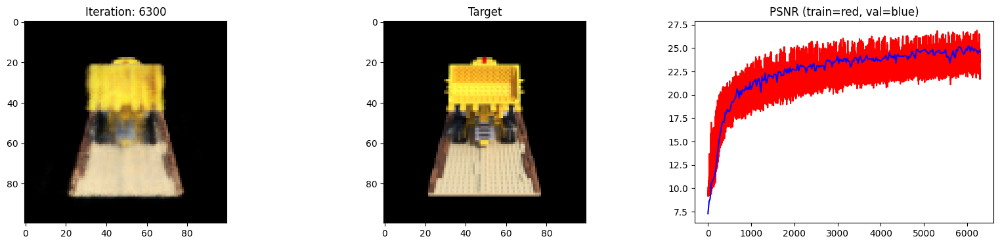

 63%|██████▎   | 6325/10000 [48:56<26:30,  2.31it/s]

Loss: 0.0036748393904417753


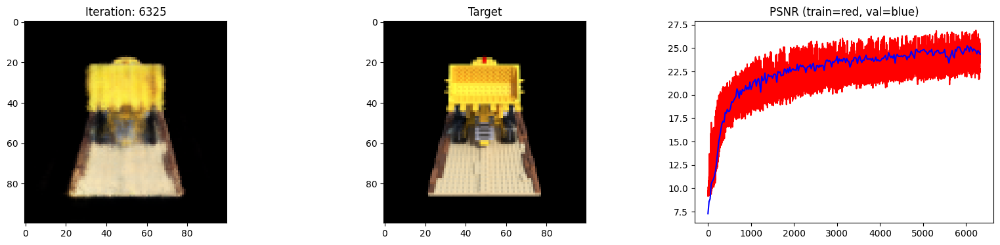

 64%|██████▎   | 6350/10000 [49:08<26:17,  2.31it/s]

Loss: 0.003330199746415019


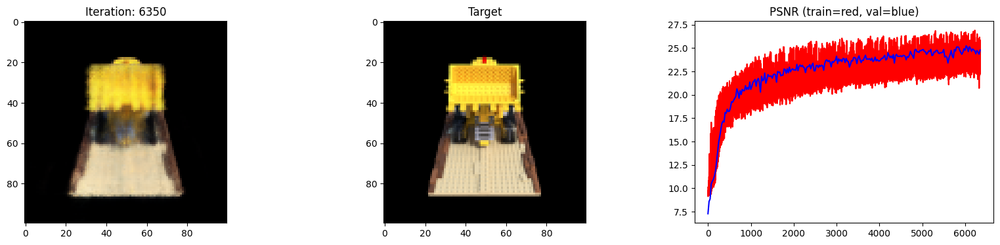

 64%|██████▍   | 6375/10000 [49:20<26:01,  2.32it/s]

Loss: 0.0032908753491938114


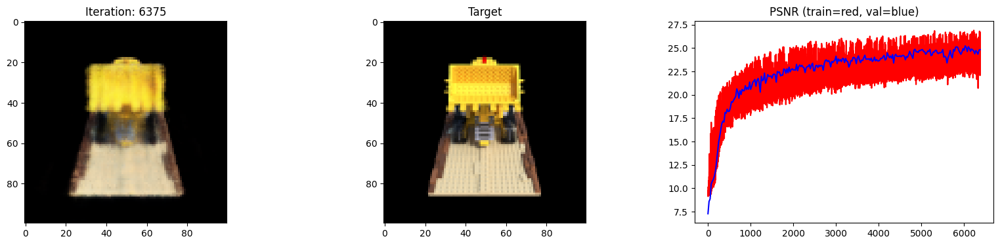

 64%|██████▍   | 6400/10000 [49:31<25:50,  2.32it/s]

Loss: 0.0033883110154420137


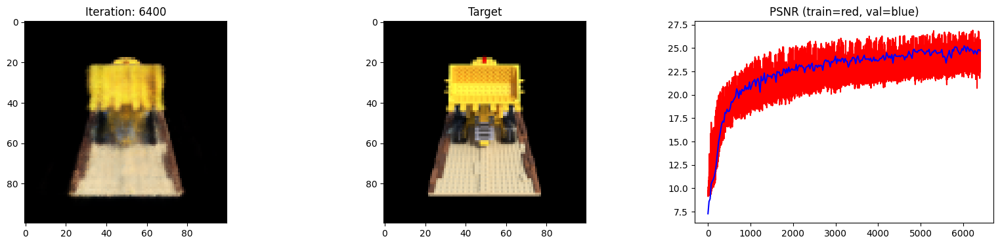

 64%|██████▍   | 6425/10000 [49:43<25:34,  2.33it/s]

Loss: 0.0031468658708035946


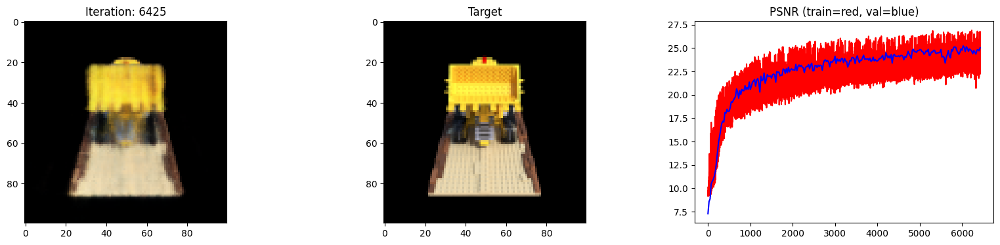

 64%|██████▍   | 6450/10000 [49:55<25:24,  2.33it/s]

Loss: 0.0037936302833259106


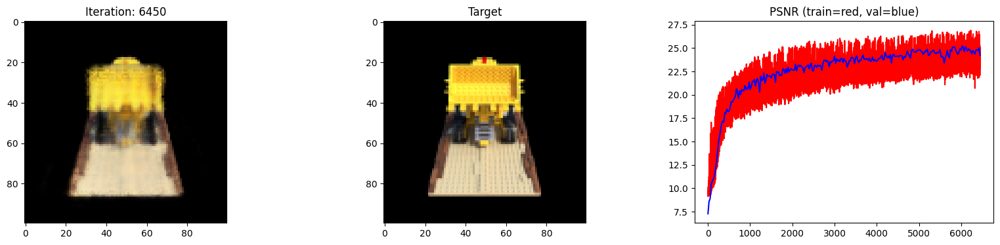

 65%|██████▍   | 6475/10000 [50:06<25:19,  2.32it/s]

Loss: 0.0032617771066725254


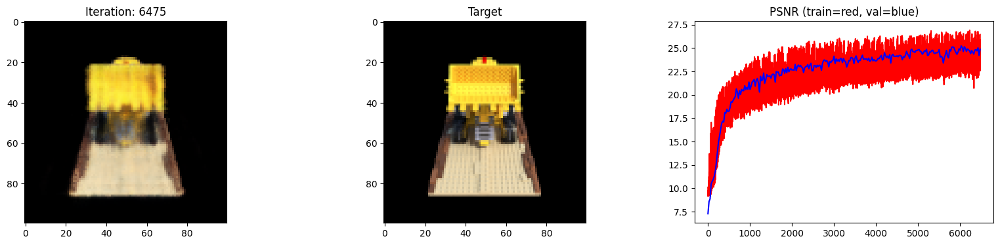

 65%|██████▌   | 6500/10000 [50:18<25:13,  2.31it/s]

Loss: 0.0034650571178644896


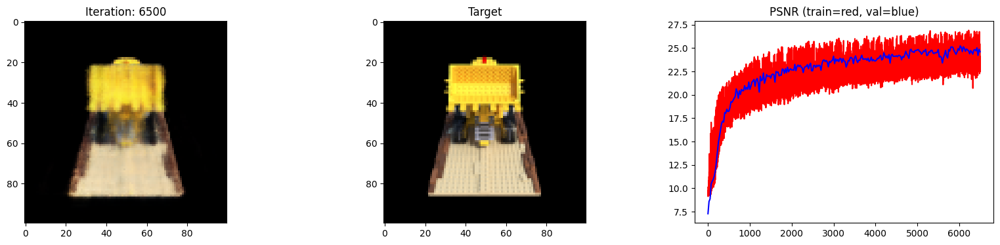

 65%|██████▌   | 6525/10000 [50:30<24:56,  2.32it/s]

Loss: 0.0034909790847450495


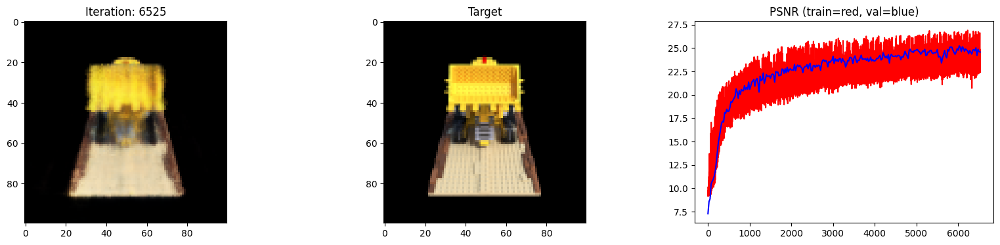

 66%|██████▌   | 6550/10000 [50:42<24:38,  2.33it/s]

Loss: 0.0031855565030127764


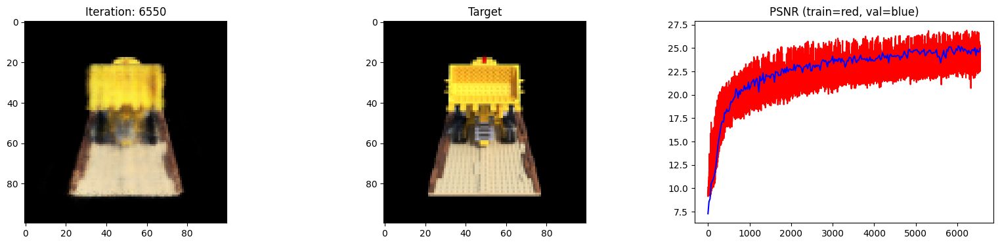

 66%|██████▌   | 6575/10000 [50:53<24:32,  2.33it/s]

Loss: 0.0031450551468878984


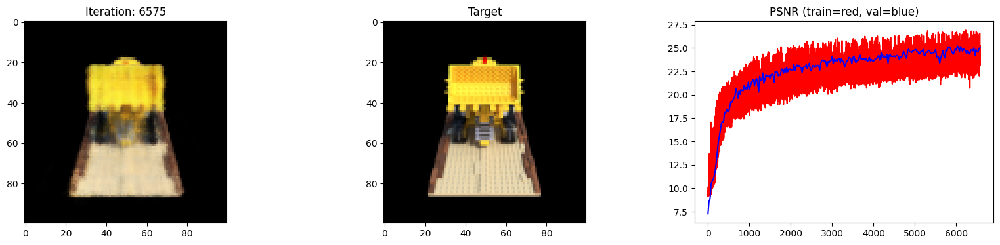

 66%|██████▌   | 6600/10000 [51:05<24:20,  2.33it/s]

Loss: 0.003326807403936982


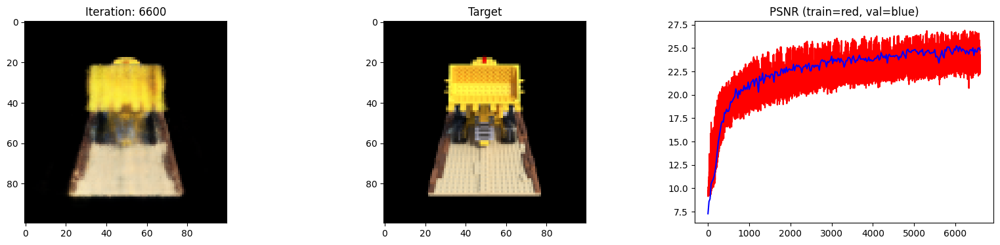

 66%|██████▋   | 6625/10000 [51:17<24:12,  2.32it/s]

Loss: 0.003358514979481697


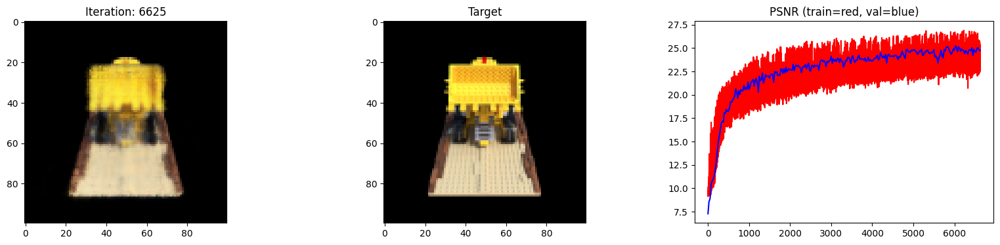

 66%|██████▋   | 6650/10000 [51:28<24:08,  2.31it/s]

Loss: 0.0030648051761090755


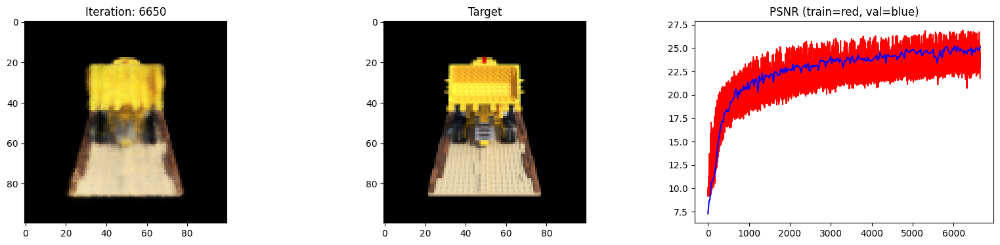

 67%|██████▋   | 6675/10000 [51:40<24:02,  2.31it/s]

Loss: 0.0034206807613372803


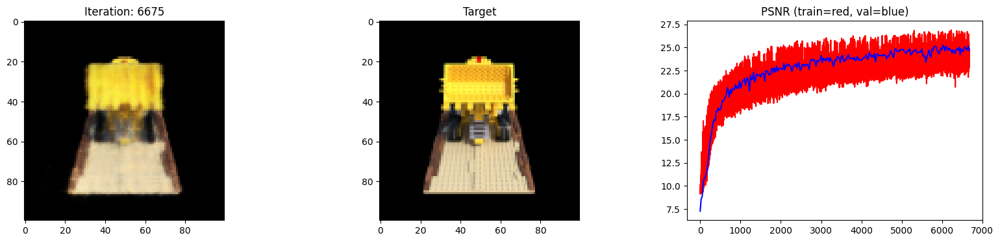

 67%|██████▋   | 6700/10000 [51:52<23:36,  2.33it/s]

Loss: 0.0034571699798107147


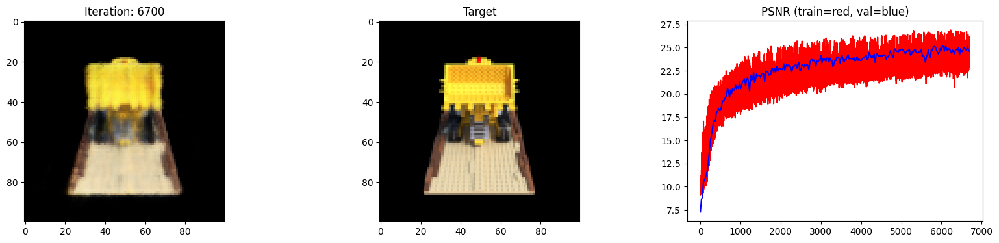

 67%|██████▋   | 6725/10000 [52:04<23:25,  2.33it/s]

Loss: 0.003572996472939849


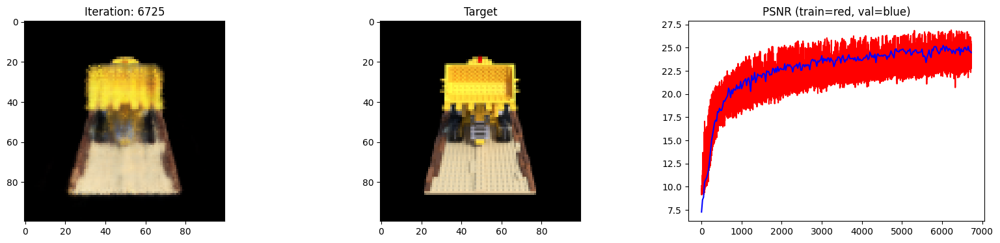

 68%|██████▊   | 6750/10000 [52:16<23:16,  2.33it/s]

Loss: 0.0029714370612055063


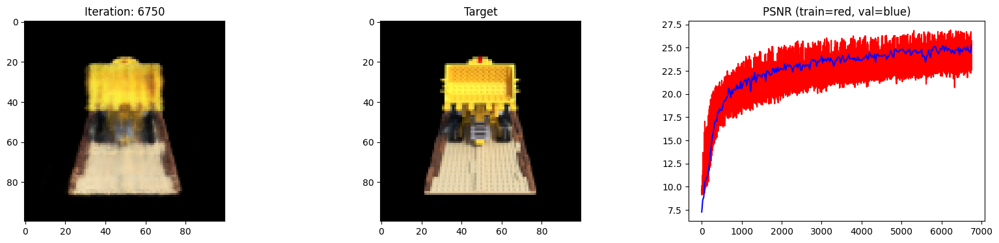

 68%|██████▊   | 6775/10000 [52:27<23:02,  2.33it/s]

Loss: 0.0031657908111810684


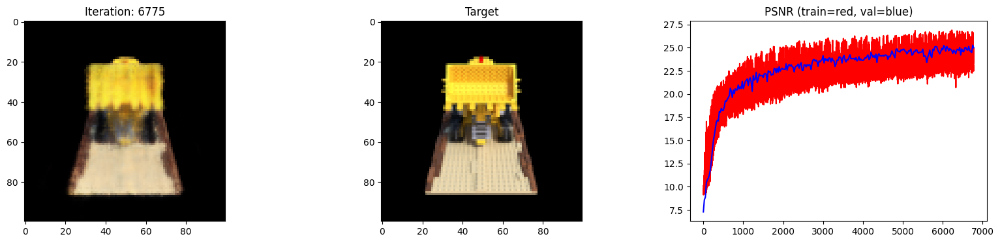

 68%|██████▊   | 6800/10000 [52:39<23:05,  2.31it/s]

Loss: 0.003246455918997526


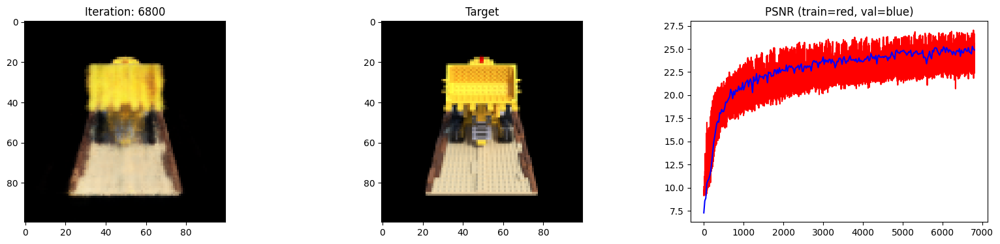

 68%|██████▊   | 6825/10000 [52:51<23:01,  2.30it/s]

Loss: 0.003379525849595666


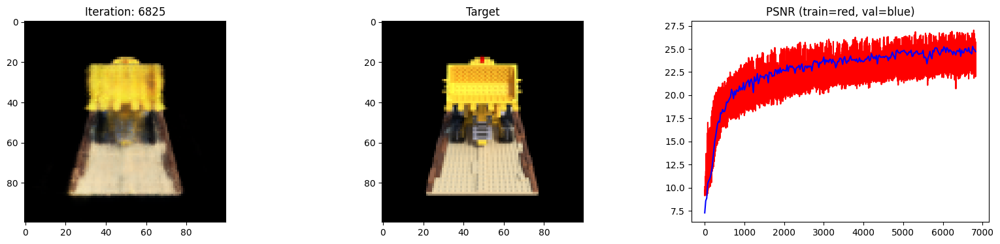

 68%|██████▊   | 6850/10000 [53:02<22:42,  2.31it/s]

Loss: 0.0036886080633848906


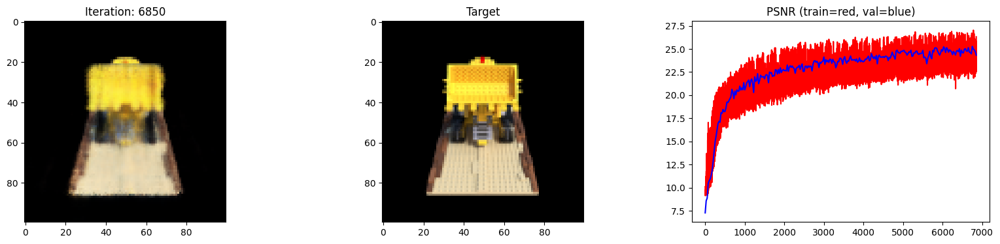

 69%|██████▉   | 6875/10000 [53:14<22:22,  2.33it/s]

Loss: 0.0038673309609293938


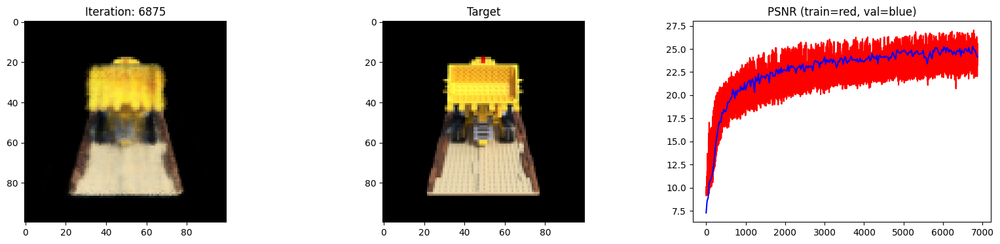

 69%|██████▉   | 6900/10000 [53:26<22:12,  2.33it/s]

Loss: 0.0033744191750884056


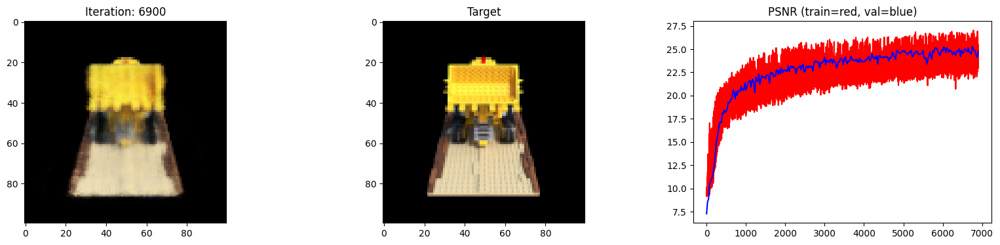

 69%|██████▉   | 6925/10000 [53:38<22:01,  2.33it/s]

Loss: 0.003764017950743437


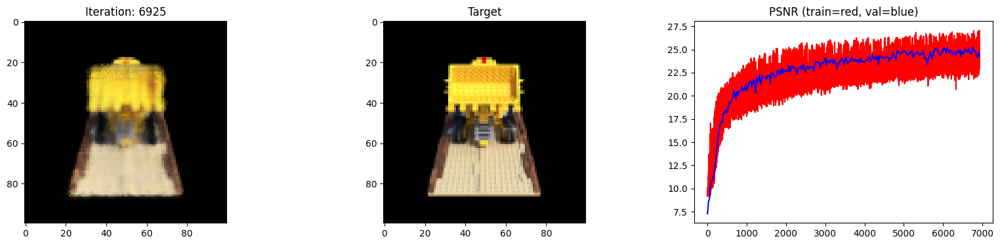

 70%|██████▉   | 6950/10000 [53:49<21:57,  2.31it/s]

Loss: 0.0038956766948103905


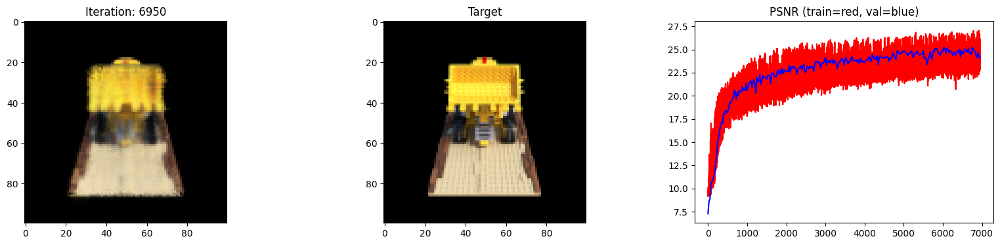

 70%|██████▉   | 6975/10000 [54:01<21:47,  2.31it/s]

Loss: 0.0031305658631026745


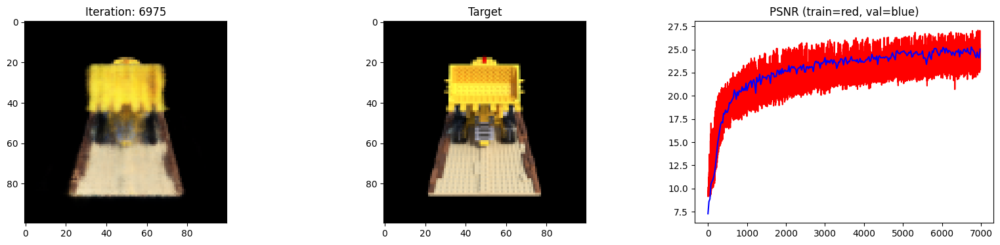

 70%|███████   | 7000/10000 [54:12<21:33,  2.32it/s]

Loss: 0.002954793395474553


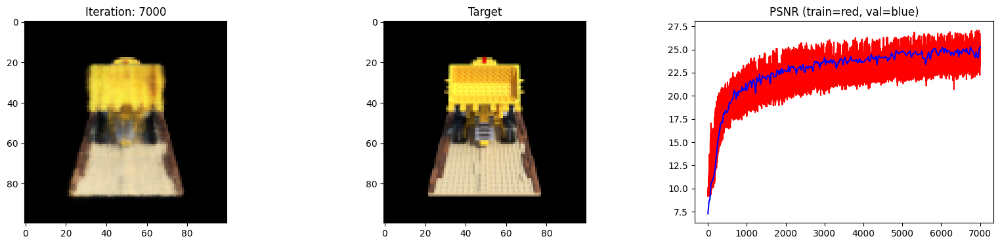

 70%|███████   | 7025/10000 [54:24<21:17,  2.33it/s]

Loss: 0.00319260754622519


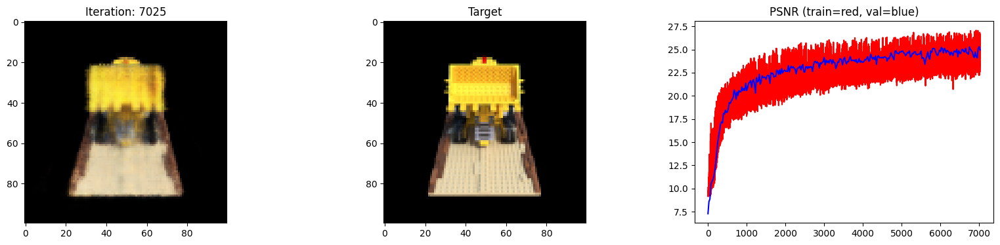

 70%|███████   | 7050/10000 [54:36<21:10,  2.32it/s]

Loss: 0.0033731115981936455


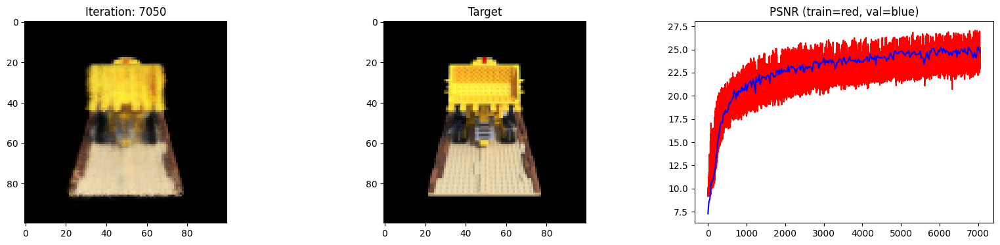

 71%|███████   | 7075/10000 [54:48<20:55,  2.33it/s]

Loss: 0.0030401453841477633


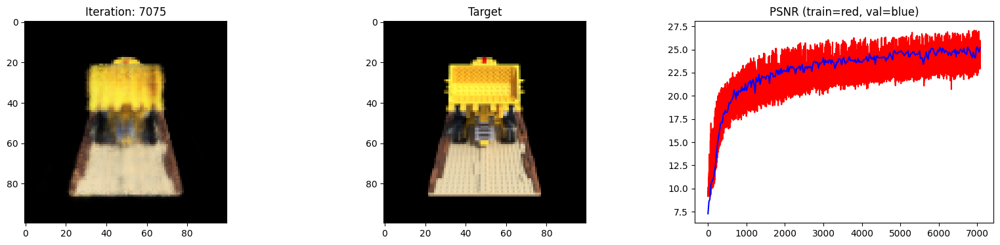

 71%|███████   | 7100/10000 [54:59<20:53,  2.31it/s]

Loss: 0.0031466842629015446


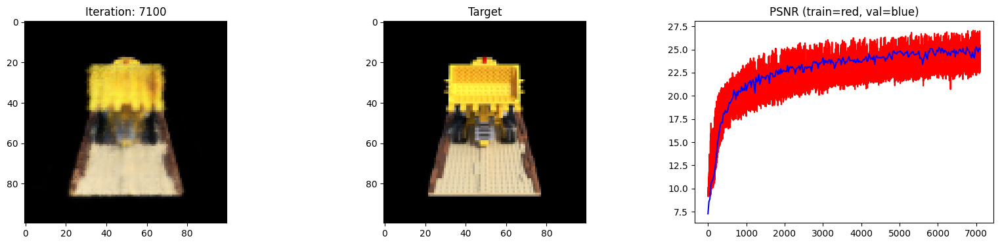

 71%|███████▏  | 7125/10000 [55:11<20:43,  2.31it/s]

Loss: 0.0033990454394370317


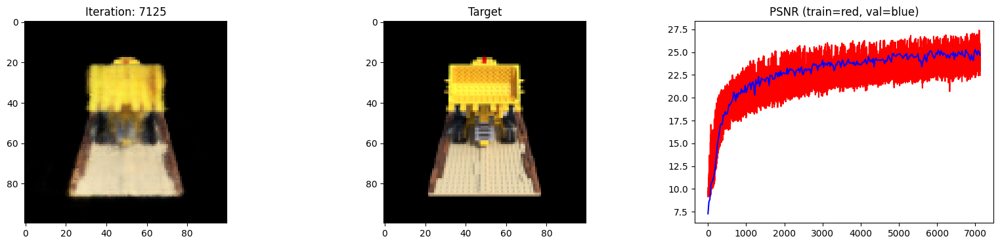

 72%|███████▏  | 7150/10000 [55:23<20:35,  2.31it/s]

Loss: 0.0032236184924840927


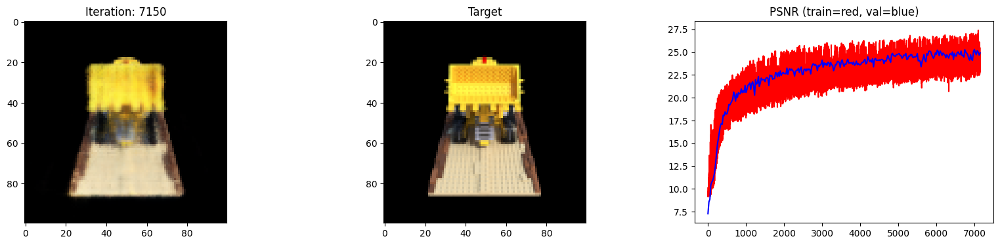

 72%|███████▏  | 7175/10000 [55:34<20:10,  2.33it/s]

Loss: 0.003213951364159584


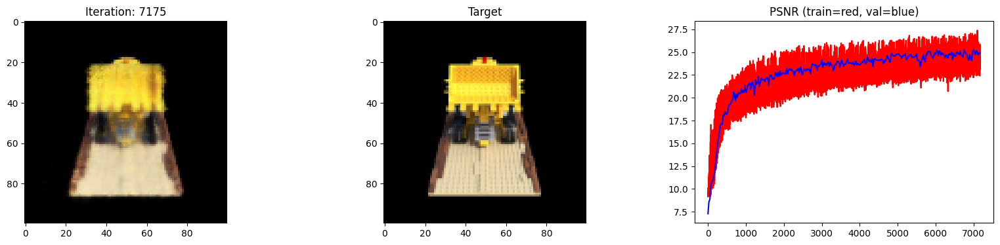

 72%|███████▏  | 7200/10000 [55:46<20:06,  2.32it/s]

Loss: 0.0030694662127643824


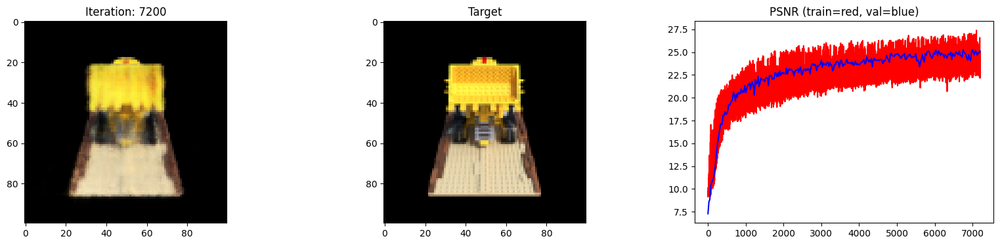

 72%|███████▏  | 7225/10000 [55:58<20:01,  2.31it/s]

Loss: 0.0032490359153598547


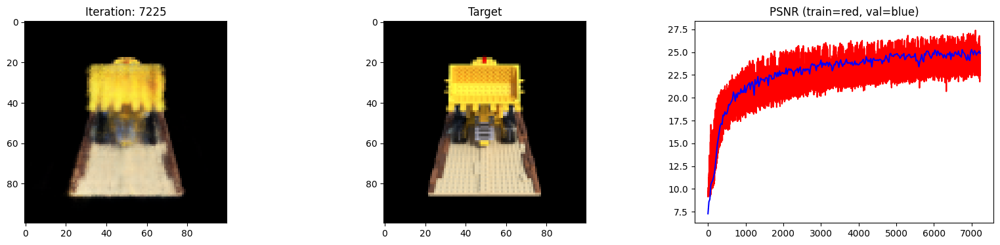

 72%|███████▎  | 7250/10000 [56:10<19:43,  2.32it/s]

Loss: 0.003229130059480667


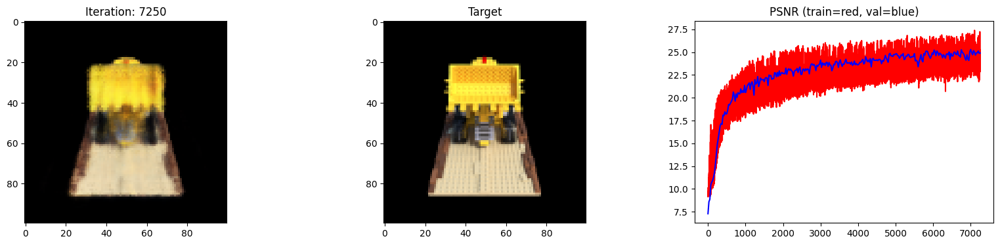

 73%|███████▎  | 7275/10000 [56:21<19:38,  2.31it/s]

Loss: 0.003272722940891981


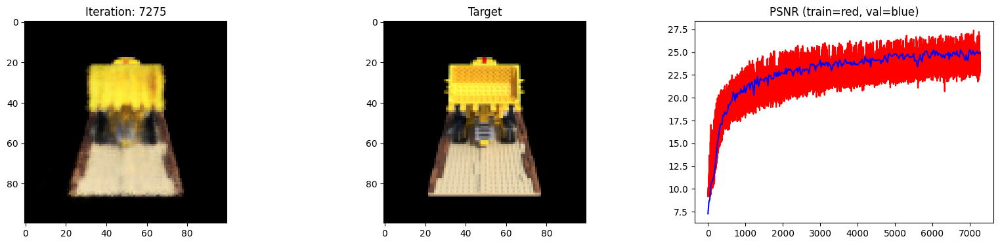

 73%|███████▎  | 7300/10000 [56:33<19:23,  2.32it/s]

Loss: 0.00332250795327127


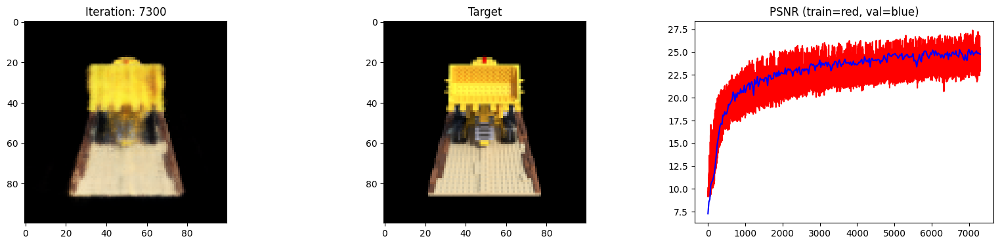

 73%|███████▎  | 7325/10000 [56:45<19:12,  2.32it/s]

Loss: 0.0030473615042865276


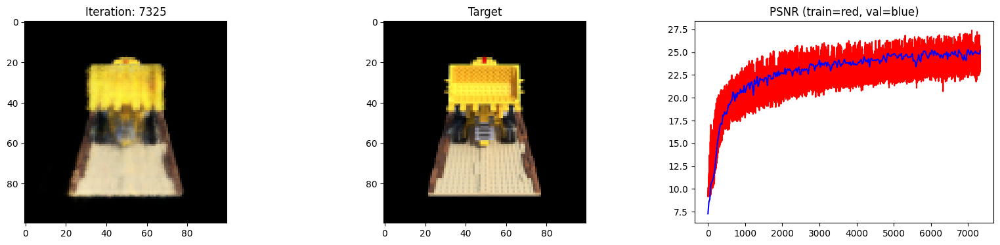

 74%|███████▎  | 7350/10000 [56:57<19:04,  2.32it/s]

Loss: 0.0029194895178079605


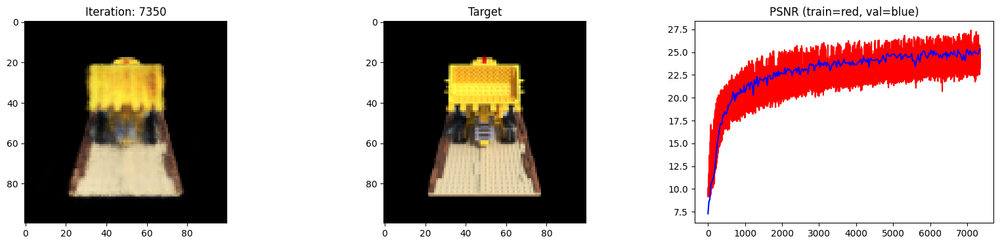

 74%|███████▍  | 7375/10000 [57:08<18:50,  2.32it/s]

Loss: 0.003137128660455346


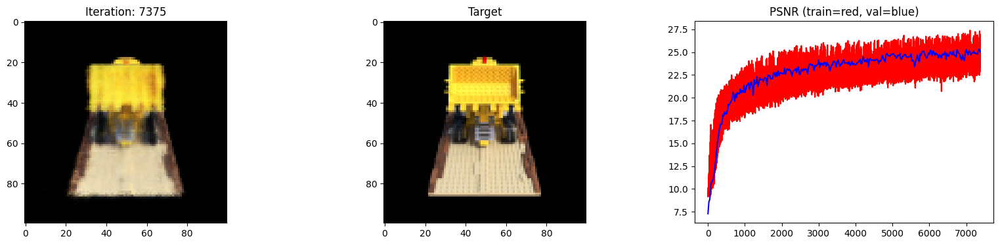

 74%|███████▍  | 7400/10000 [57:20<18:47,  2.31it/s]

Loss: 0.0029523882549256086


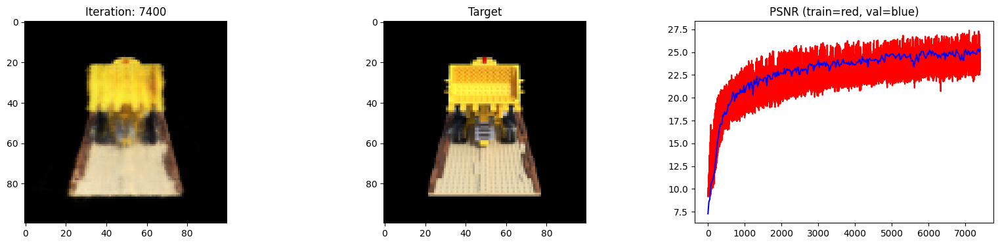

 74%|███████▍  | 7425/10000 [57:32<18:30,  2.32it/s]

Loss: 0.003419260960072279


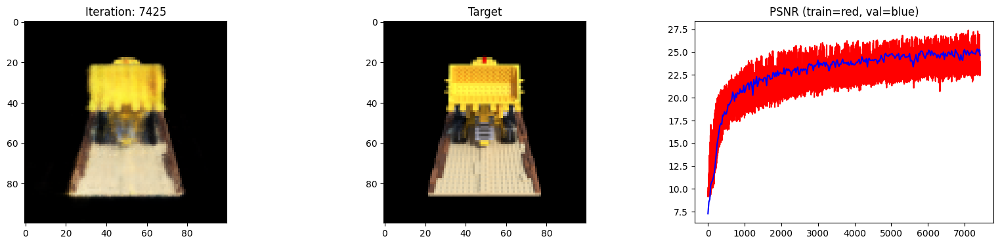

 74%|███████▍  | 7450/10000 [57:44<18:27,  2.30it/s]

Loss: 0.0032714316621422768


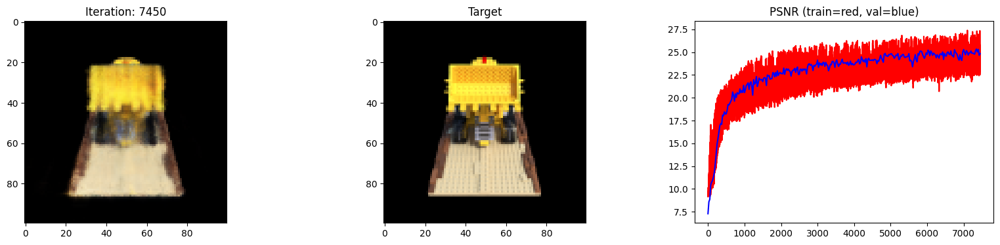

 75%|███████▍  | 7475/10000 [57:55<18:20,  2.29it/s]

Loss: 0.002968456596136093


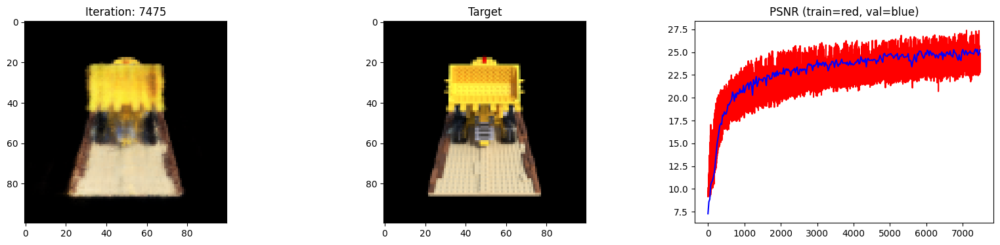

 75%|███████▌  | 7500/10000 [58:07<17:56,  2.32it/s]

Loss: 0.0034412865061312914


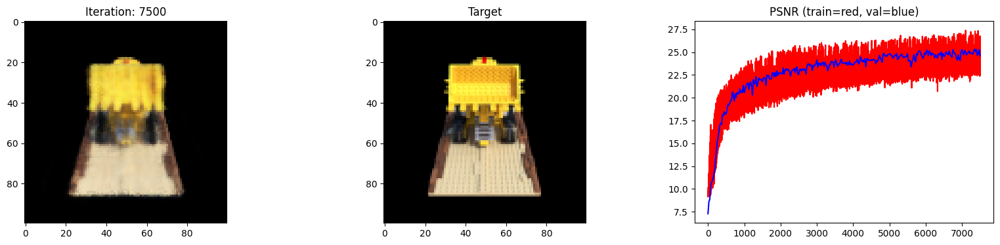

 75%|███████▌  | 7525/10000 [58:19<17:44,  2.33it/s]

Loss: 0.0029231547378003597


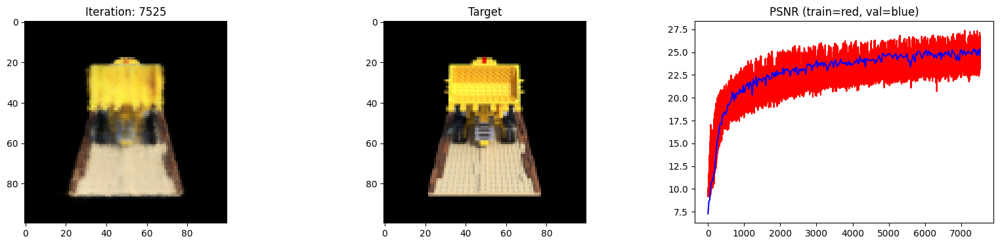

 76%|███████▌  | 7550/10000 [58:31<17:38,  2.32it/s]

Loss: 0.00350139569491148


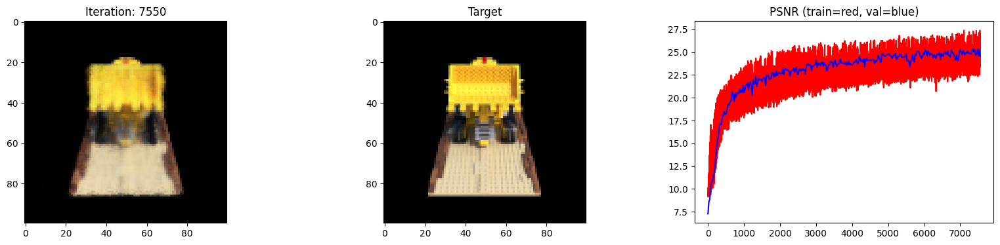

 76%|███████▌  | 7575/10000 [58:42<17:28,  2.31it/s]

Loss: 0.00306245987303555


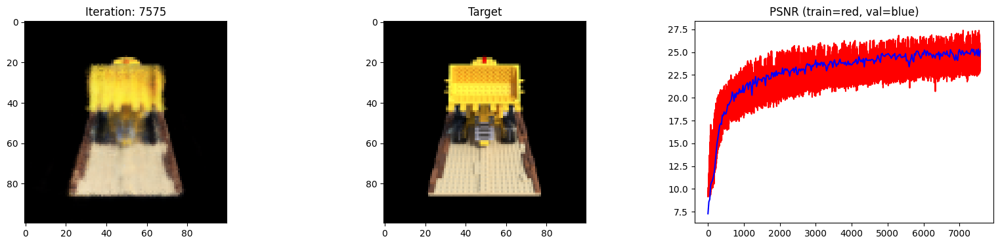

 76%|███████▌  | 7600/10000 [58:54<17:24,  2.30it/s]

Loss: 0.0030888631008565426


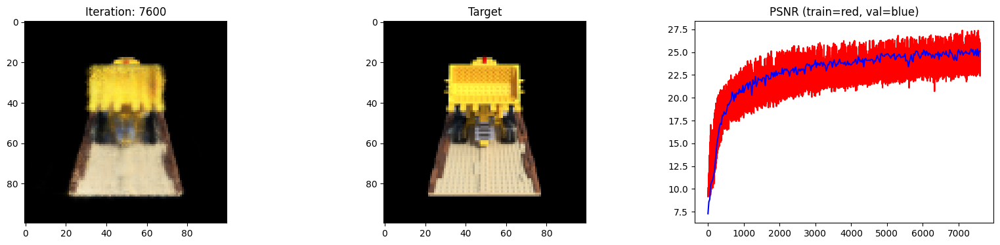

 76%|███████▋  | 7625/10000 [59:06<17:09,  2.31it/s]

Loss: 0.0028787788469344378


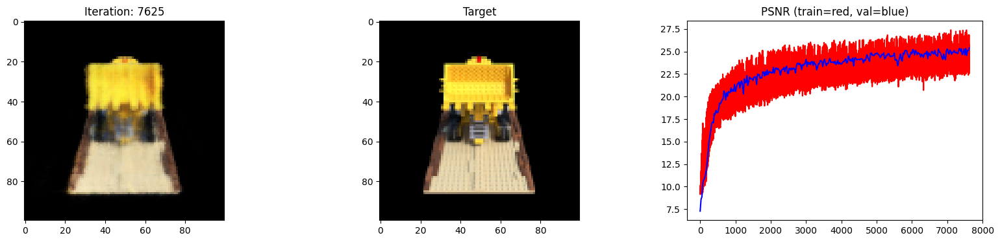

 76%|███████▋  | 7650/10000 [59:18<16:50,  2.33it/s]

Loss: 0.003187483875080943


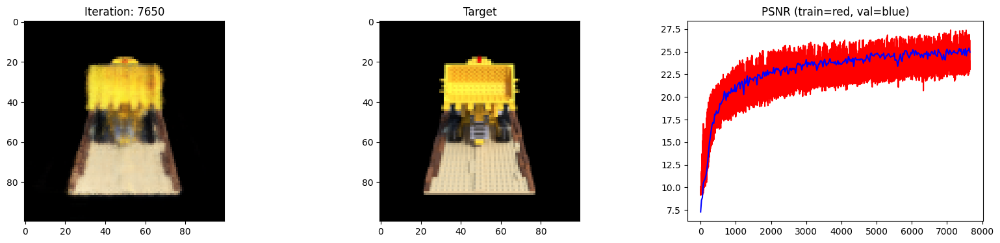

 77%|███████▋  | 7675/10000 [59:30<16:39,  2.33it/s]

Loss: 0.0028633202891796827


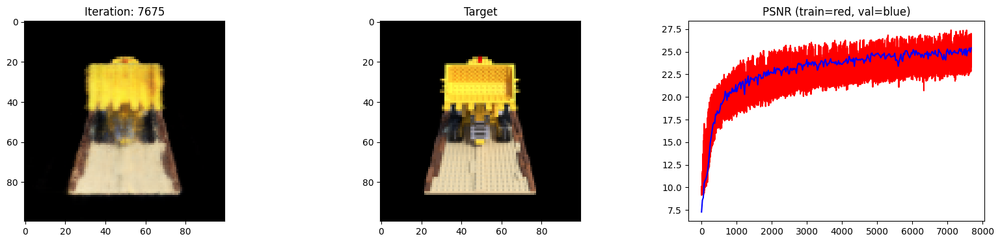

 77%|███████▋  | 7700/10000 [59:41<16:30,  2.32it/s]

Loss: 0.002911154879257083


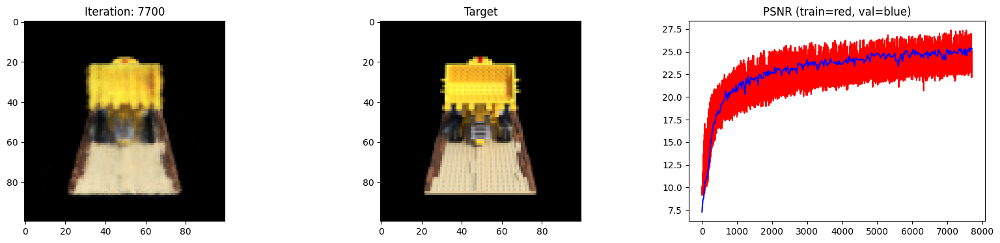

 77%|███████▋  | 7725/10000 [59:53<16:23,  2.31it/s]

Loss: 0.002943857340142131


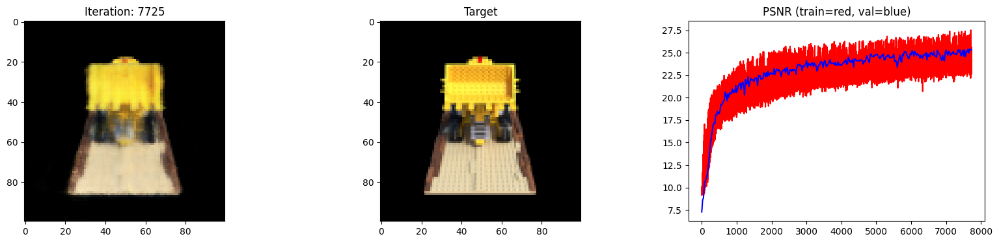

 78%|███████▊  | 7750/10000 [1:00:05<16:17,  2.30it/s]

Loss: 0.0027288920246064663


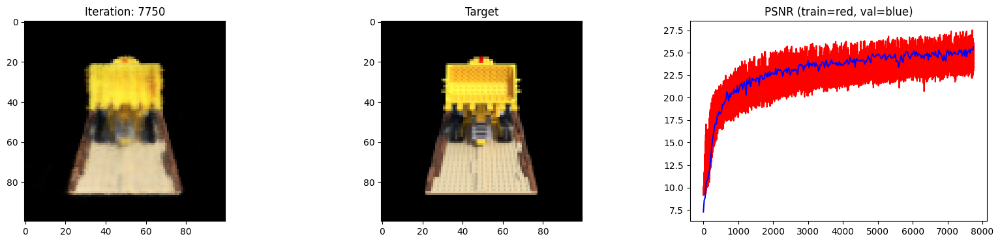

 78%|███████▊  | 7775/10000 [1:00:16<16:02,  2.31it/s]

Loss: 0.0029698896687477827


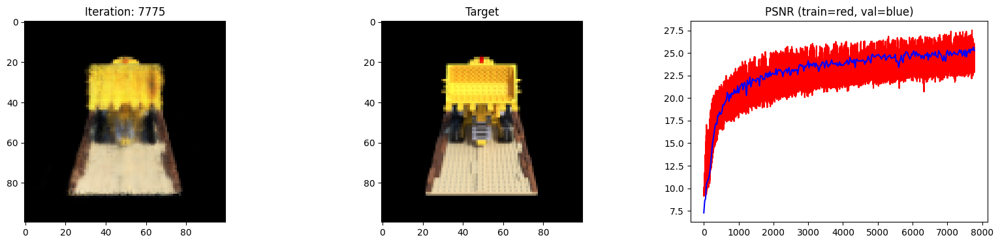

 78%|███████▊  | 7800/10000 [1:00:28<15:46,  2.32it/s]

Loss: 0.003018323564901948


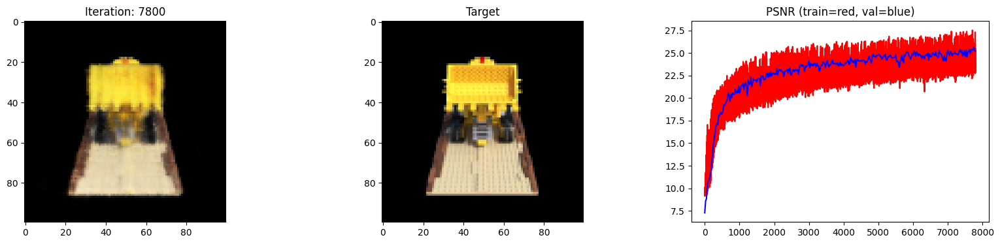

 78%|███████▊  | 7825/10000 [1:00:40<15:33,  2.33it/s]

Loss: 0.0030836777295917273


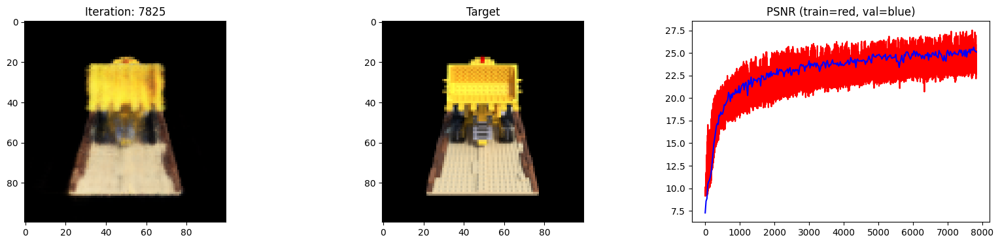

 78%|███████▊  | 7850/10000 [1:00:52<15:24,  2.33it/s]

Loss: 0.0031464570201933384


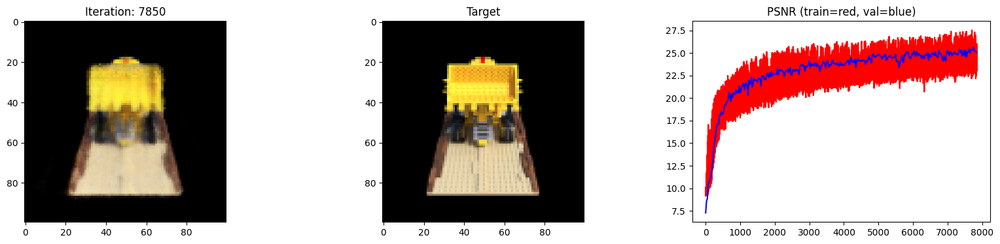

 79%|███████▉  | 7875/10000 [1:01:04<15:20,  2.31it/s]

Loss: 0.00309555372223258


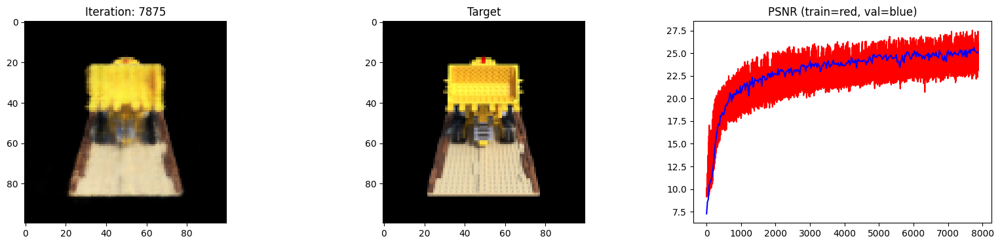

 79%|███████▉  | 7900/10000 [1:01:15<15:07,  2.31it/s]

Loss: 0.0028627722058445215


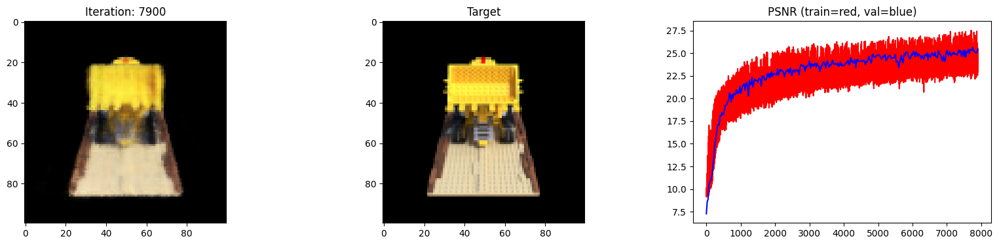

 79%|███████▉  | 7925/10000 [1:01:27<14:55,  2.32it/s]

Loss: 0.00336851691827178


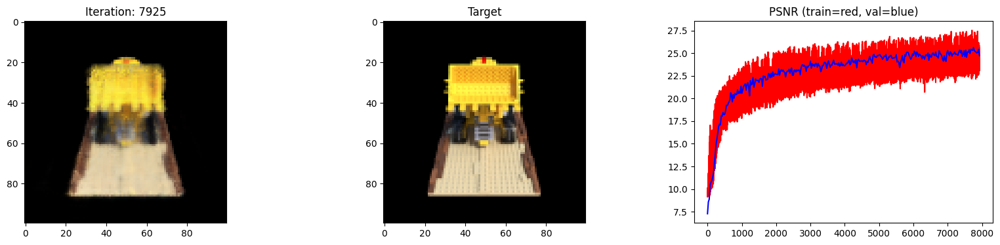

 80%|███████▉  | 7950/10000 [1:01:39<14:40,  2.33it/s]

Loss: 0.003132525132969022


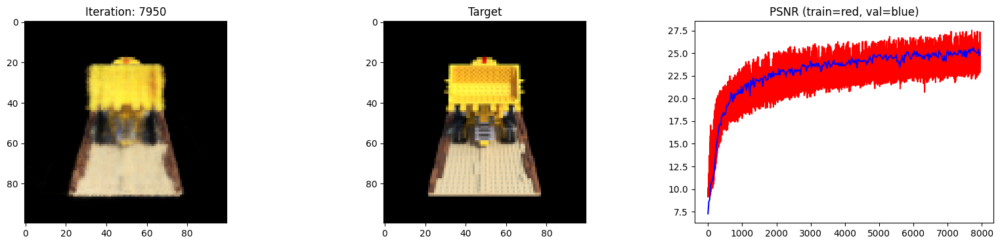

 80%|███████▉  | 7975/10000 [1:01:51<14:31,  2.32it/s]

Loss: 0.0032194529194384813


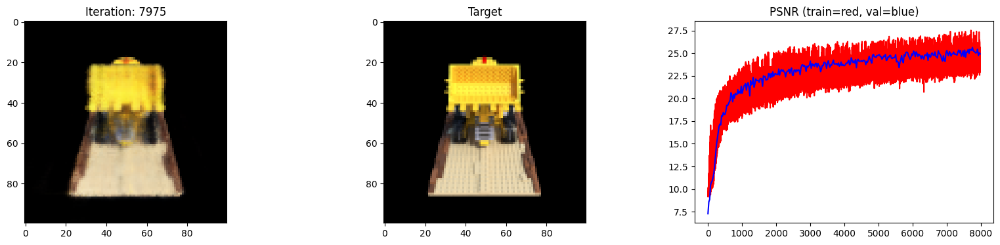

 80%|████████  | 8000/10000 [1:02:02<14:20,  2.33it/s]

Loss: 0.0035806894302368164


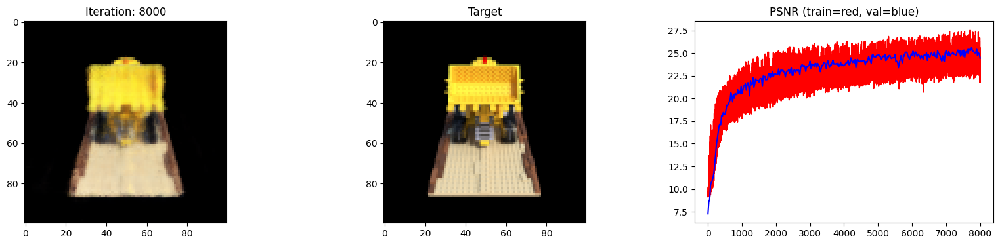

 80%|████████  | 8025/10000 [1:02:14<14:12,  2.32it/s]

Loss: 0.003324069082736969


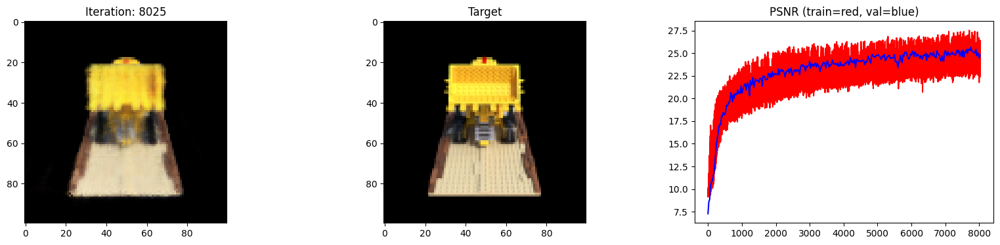

 80%|████████  | 8050/10000 [1:02:26<14:02,  2.31it/s]

Loss: 0.003145737573504448


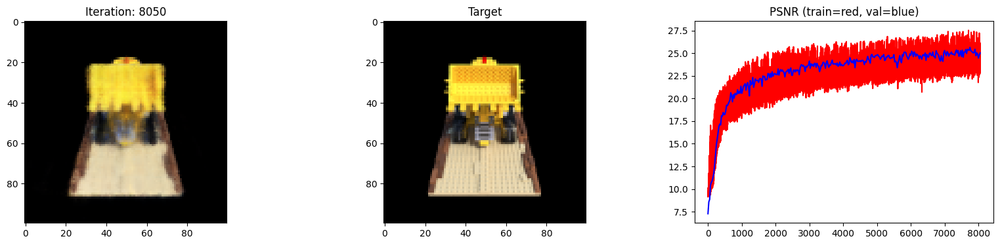

 81%|████████  | 8075/10000 [1:02:37<13:51,  2.31it/s]

Loss: 0.0032935976050794125


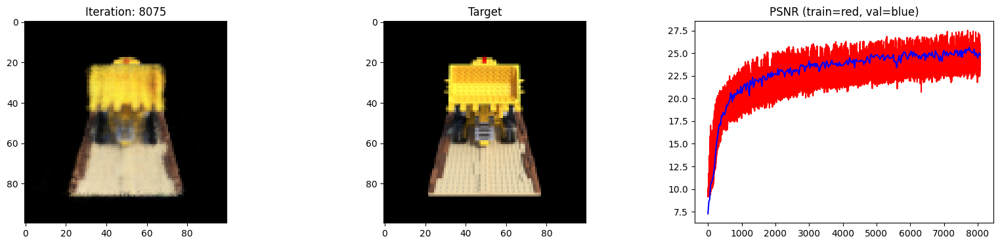

 81%|████████  | 8100/10000 [1:02:49<13:35,  2.33it/s]

Loss: 0.0037011438980698586


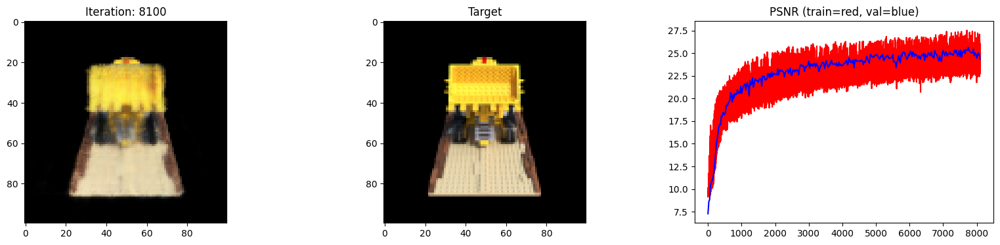

 81%|████████▏ | 8125/10000 [1:03:01<13:28,  2.32it/s]

Loss: 0.0036366323474794626


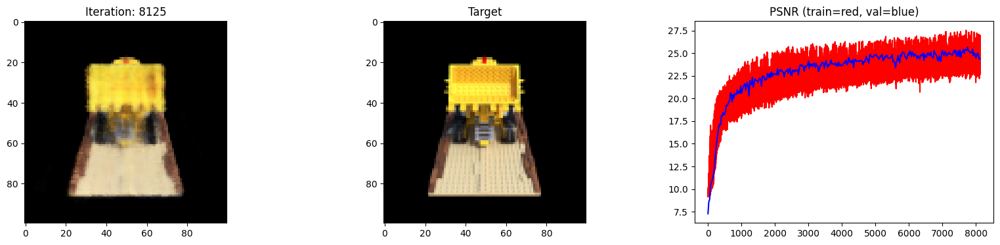

 82%|████████▏ | 8150/10000 [1:03:13<13:14,  2.33it/s]

Loss: 0.0038763917982578278


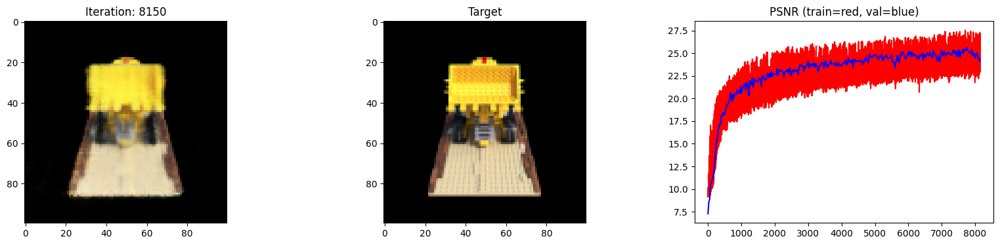

 82%|████████▏ | 8175/10000 [1:03:25<13:05,  2.32it/s]

Loss: 0.0028894527349621058


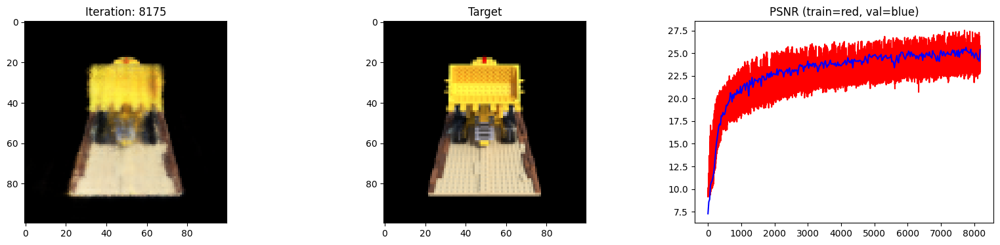

 82%|████████▏ | 8200/10000 [1:03:36<12:55,  2.32it/s]

Loss: 0.0028633109759539366


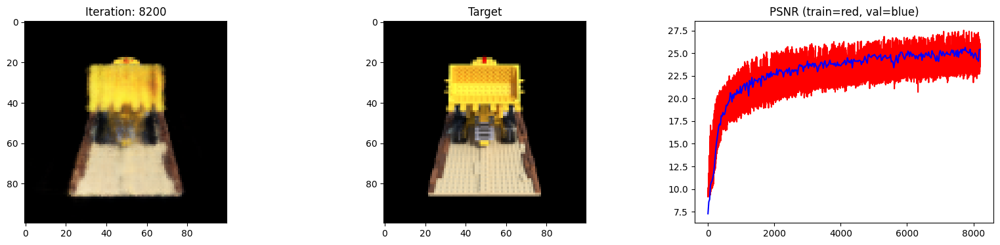

 82%|████████▏ | 8225/10000 [1:03:48<12:46,  2.32it/s]

Loss: 0.002527503529563546


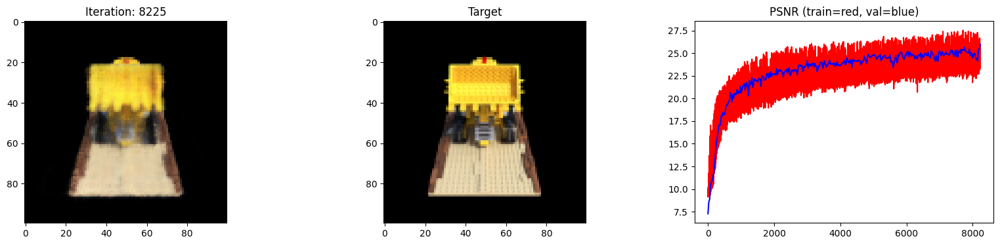

 82%|████████▎ | 8250/10000 [1:04:00<12:32,  2.33it/s]

Loss: 0.002964066108688712


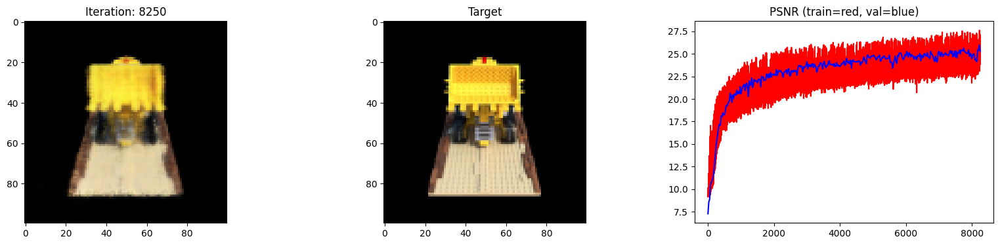

 83%|████████▎ | 8275/10000 [1:04:12<12:23,  2.32it/s]

Loss: 0.002561465837061405


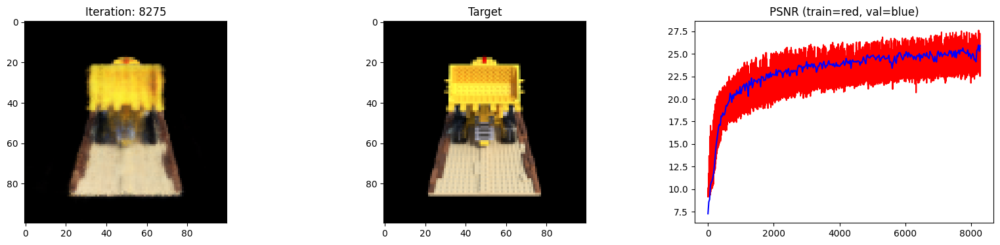

 83%|████████▎ | 8300/10000 [1:04:23<12:31,  2.26it/s]

Loss: 0.003362131305038929


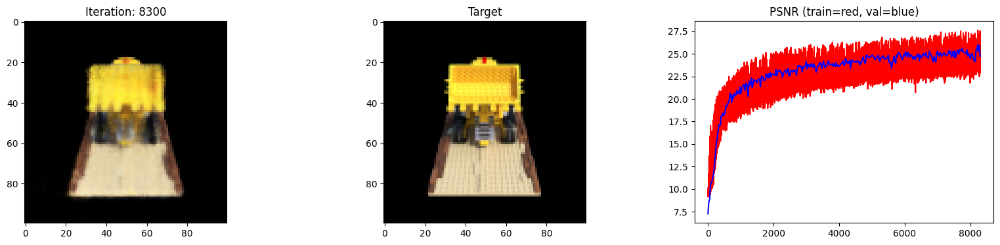

 83%|████████▎ | 8325/10000 [1:04:35<12:03,  2.32it/s]

Loss: 0.003080311929807067


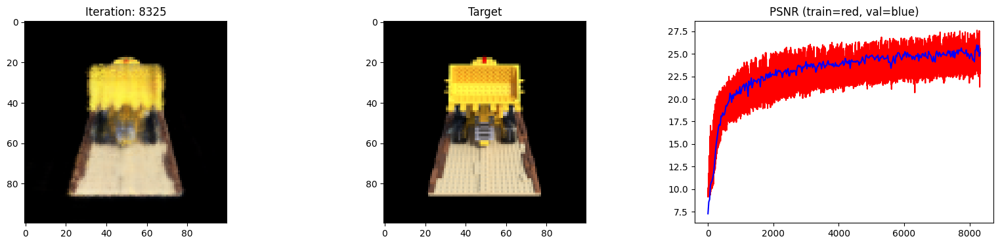

 84%|████████▎ | 8350/10000 [1:04:47<11:54,  2.31it/s]

Loss: 0.003264807164669037


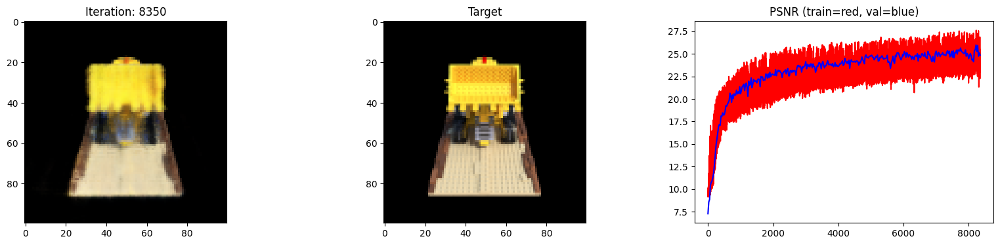

 84%|████████▍ | 8375/10000 [1:04:58<11:40,  2.32it/s]

Loss: 0.0027929276693612337


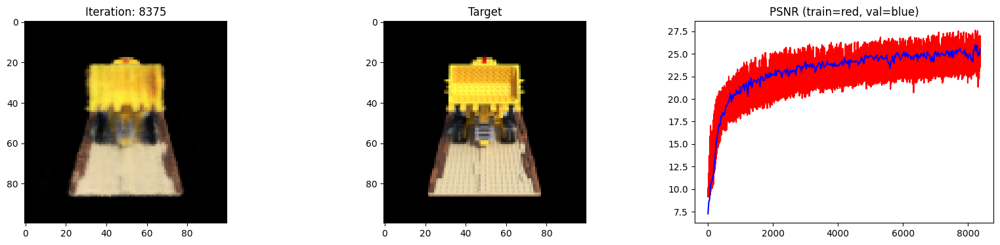

 84%|████████▍ | 8400/10000 [1:05:10<11:28,  2.32it/s]

Loss: 0.002903520595282316


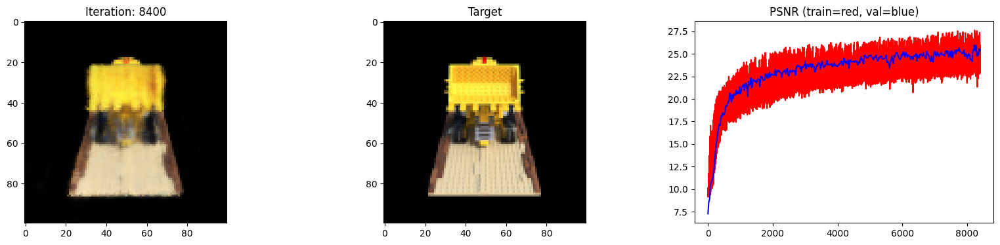

 84%|████████▍ | 8425/10000 [1:05:22<11:16,  2.33it/s]

Loss: 0.002829830627888441


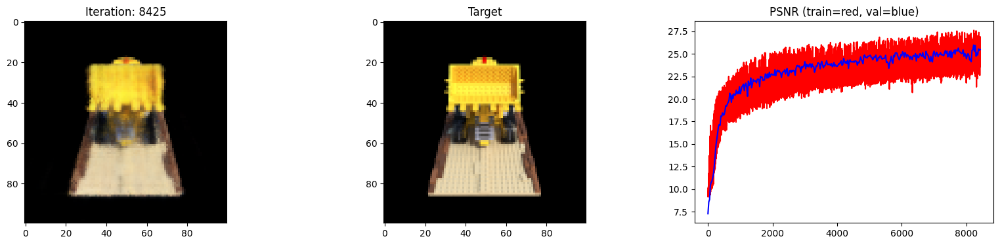

 84%|████████▍ | 8450/10000 [1:05:34<11:11,  2.31it/s]

Loss: 0.002712744753807783


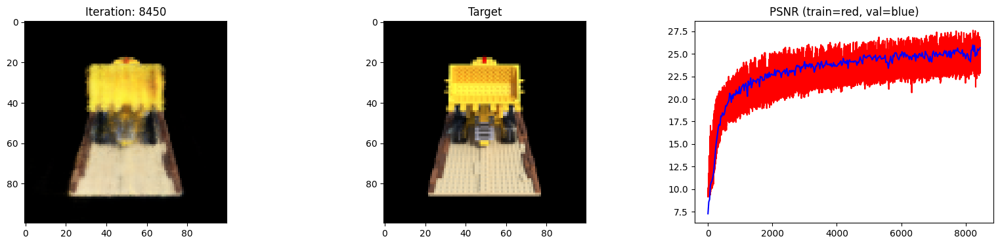

 85%|████████▍ | 8475/10000 [1:05:46<10:58,  2.31it/s]

Loss: 0.0034260631073266268


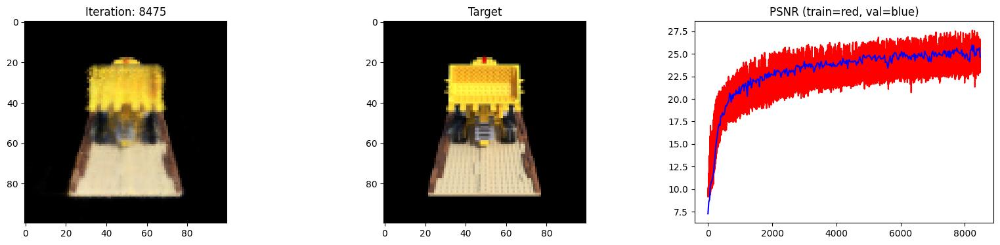

 85%|████████▌ | 8500/10000 [1:05:57<10:44,  2.33it/s]

Loss: 0.003189068054780364


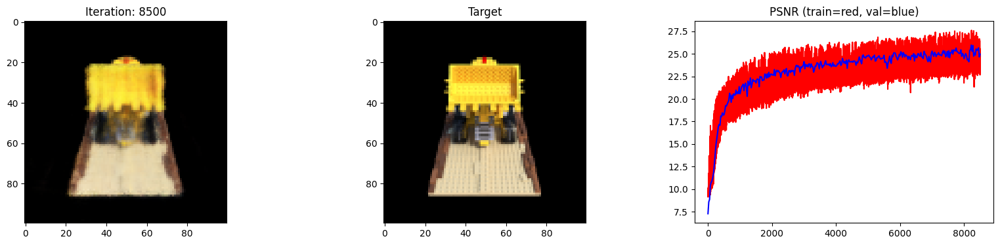

 85%|████████▌ | 8525/10000 [1:06:09<10:41,  2.30it/s]

Loss: 0.0029923091642558575


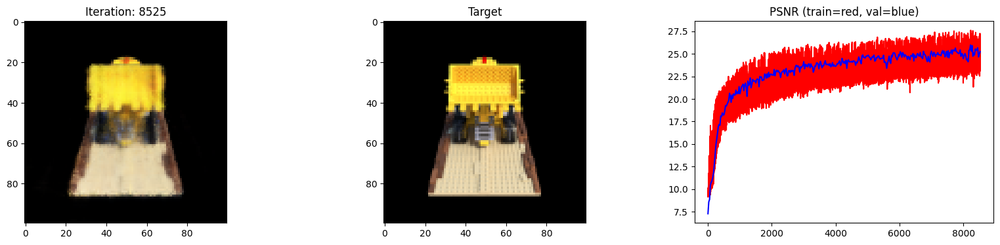

 86%|████████▌ | 8550/10000 [1:06:21<10:35,  2.28it/s]

Loss: 0.0033842872362583876


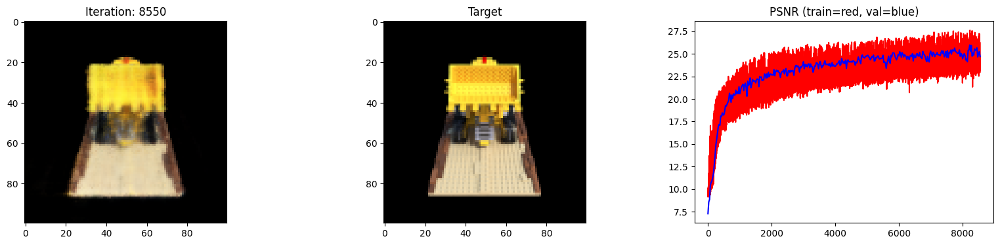

 86%|████████▌ | 8575/10000 [1:06:33<10:11,  2.33it/s]

Loss: 0.0028932022396475077


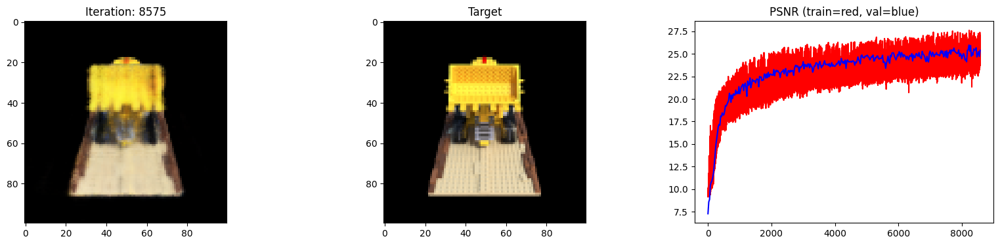

 86%|████████▌ | 8600/10000 [1:06:45<10:04,  2.32it/s]

Loss: 0.0032395310699939728


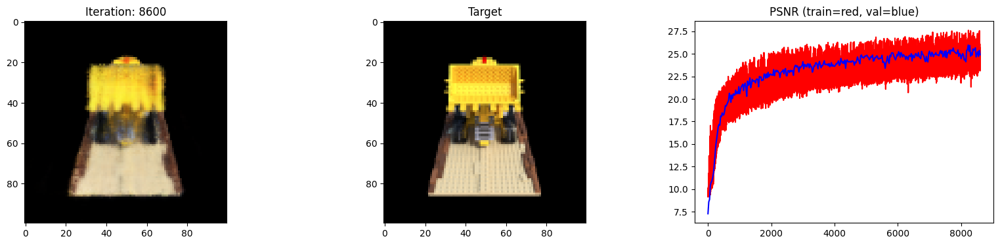

 86%|████████▋ | 8625/10000 [1:06:56<09:56,  2.30it/s]

Loss: 0.003026809310540557


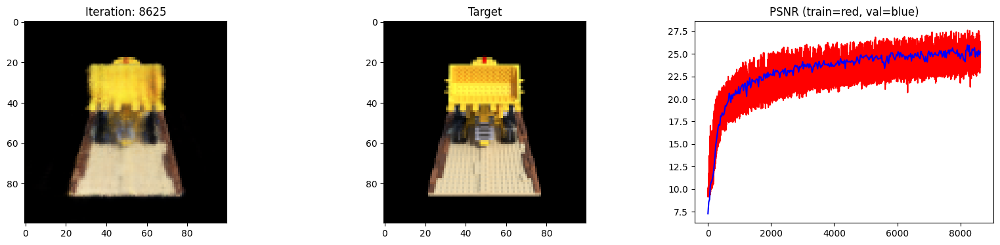

 86%|████████▋ | 8650/10000 [1:07:08<09:42,  2.32it/s]

Loss: 0.003143403446301818


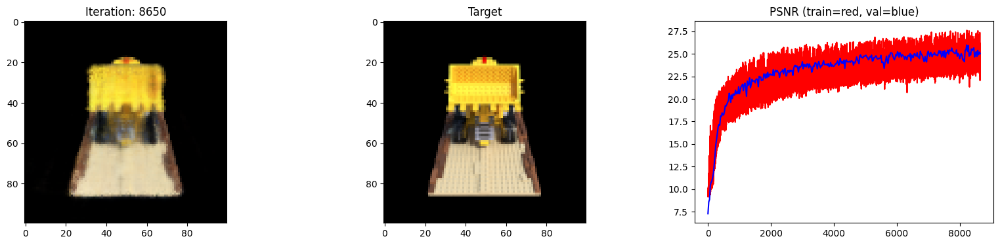

 87%|████████▋ | 8675/10000 [1:07:20<09:31,  2.32it/s]

Loss: 0.0031881723552942276


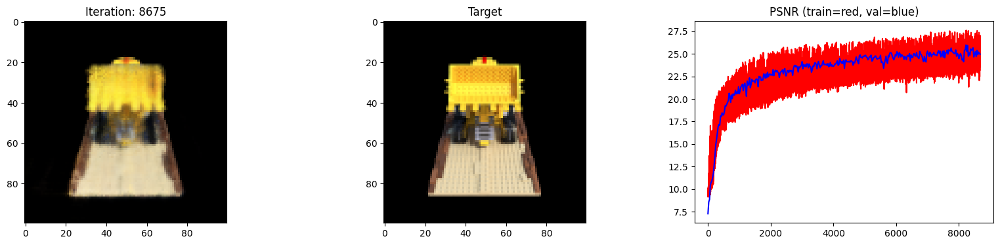

 87%|████████▋ | 8700/10000 [1:07:32<09:27,  2.29it/s]

Loss: 0.0027722404338419437


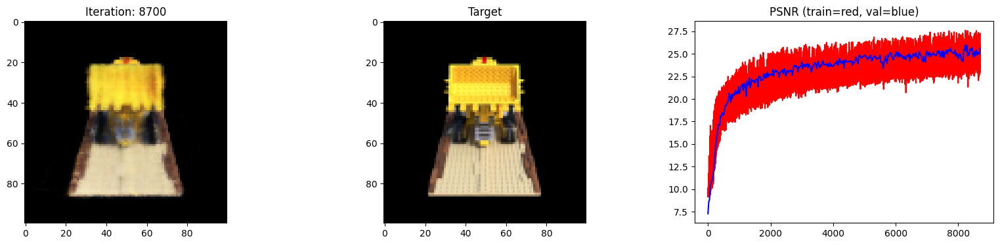

 87%|████████▋ | 8725/10000 [1:07:44<09:08,  2.33it/s]

Loss: 0.0027789012528955936


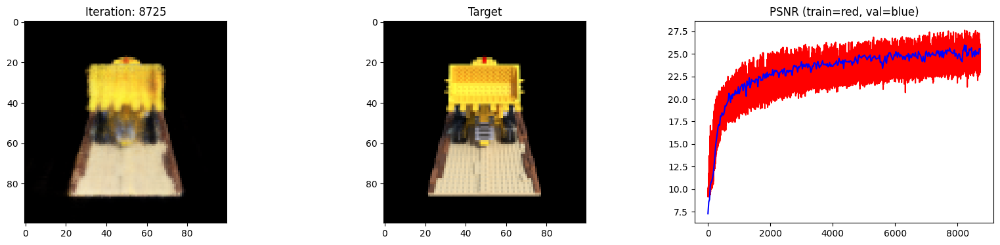

 88%|████████▊ | 8750/10000 [1:07:56<08:58,  2.32it/s]

Loss: 0.0028460968751460314


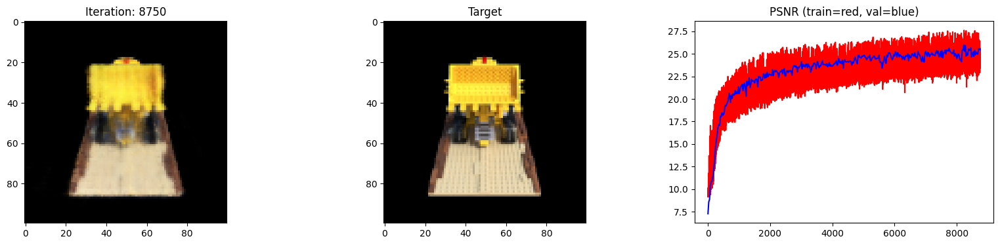

 88%|████████▊ | 8775/10000 [1:08:07<08:47,  2.32it/s]

Loss: 0.0034968520049005747


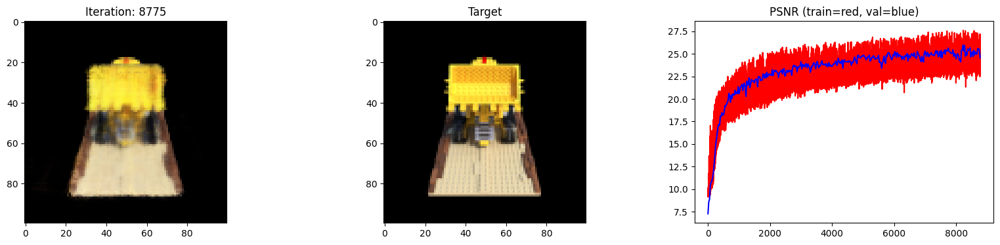

 88%|████████▊ | 8800/10000 [1:08:19<08:36,  2.32it/s]

Loss: 0.0028203176334500313


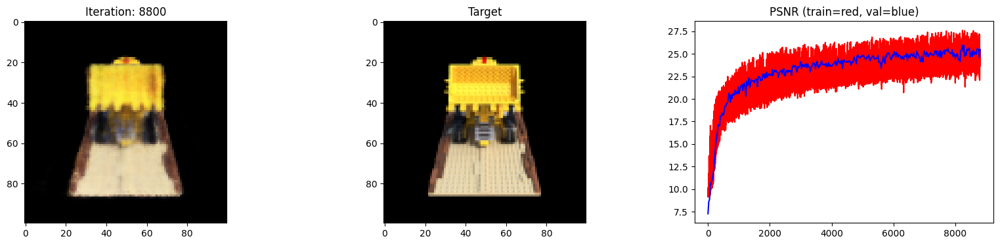

 88%|████████▊ | 8825/10000 [1:08:31<08:28,  2.31it/s]

Loss: 0.0029797200113534927


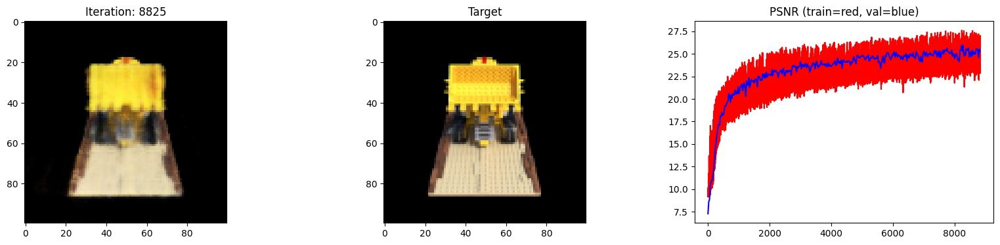

 88%|████████▊ | 8850/10000 [1:08:43<08:18,  2.31it/s]

Loss: 0.0031689561437815428


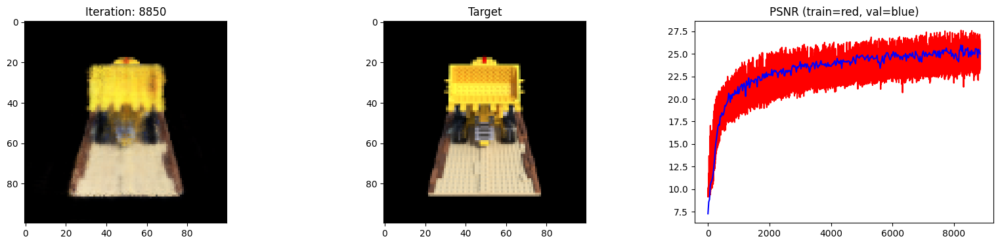

 89%|████████▉ | 8875/10000 [1:08:55<08:05,  2.32it/s]

Loss: 0.003358201589435339


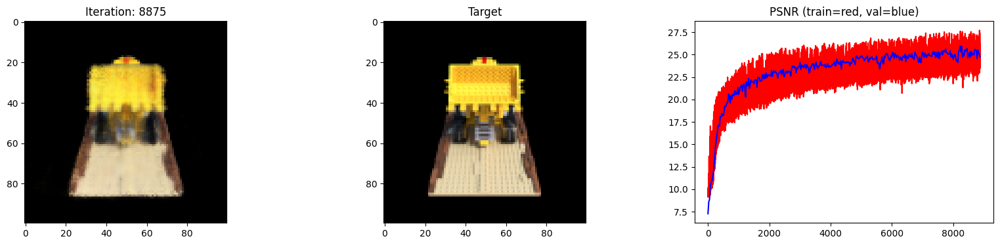

 89%|████████▉ | 8900/10000 [1:09:07<07:54,  2.32it/s]

Loss: 0.0033323015086352825


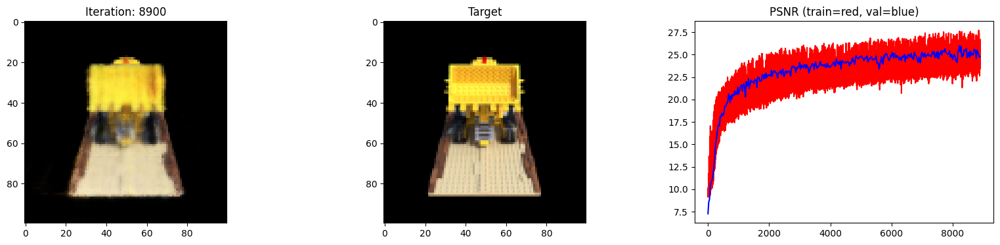

 89%|████████▉ | 8925/10000 [1:09:18<07:42,  2.32it/s]

Loss: 0.003018392017111182


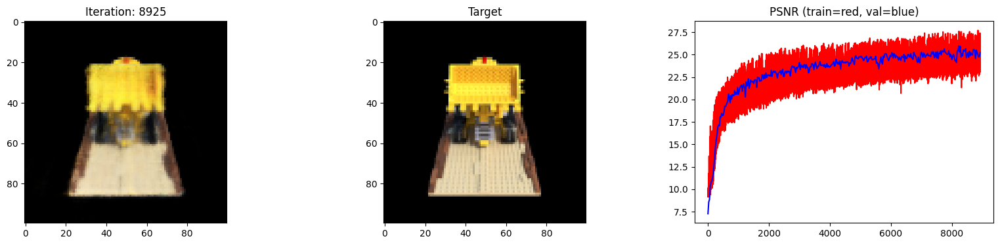

 90%|████████▉ | 8950/10000 [1:09:30<07:31,  2.32it/s]

Loss: 0.0027633218560367823


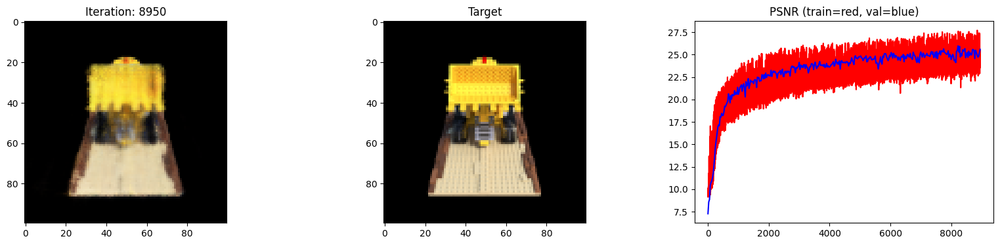

 90%|████████▉ | 8975/10000 [1:09:42<07:21,  2.32it/s]

Loss: 0.003057576948776841


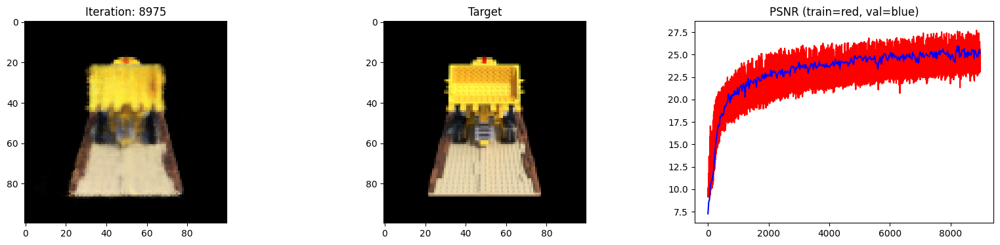

 90%|█████████ | 9000/10000 [1:09:54<07:16,  2.29it/s]

Loss: 0.0027372436597943306


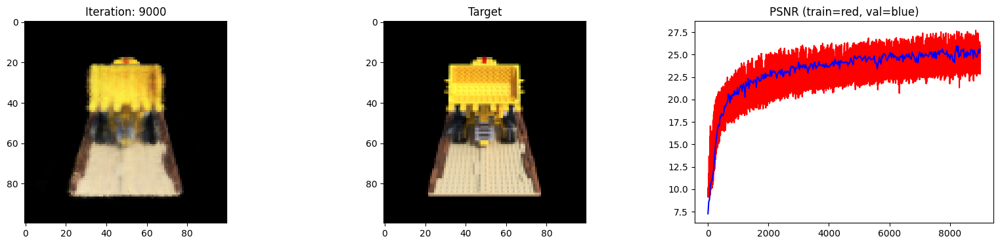

 90%|█████████ | 9025/10000 [1:10:05<07:01,  2.31it/s]

Loss: 0.00305955414660275


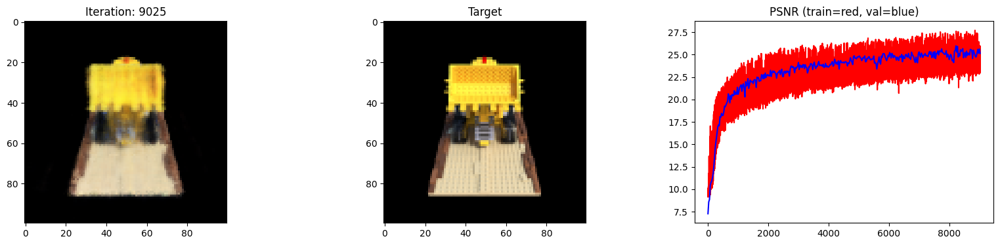

 90%|█████████ | 9050/10000 [1:10:18<06:51,  2.31it/s]

Loss: 0.0030126001220196486


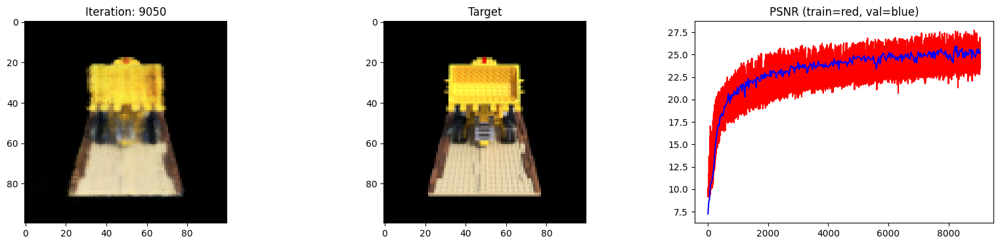

 91%|█████████ | 9075/10000 [1:10:29<06:37,  2.32it/s]

Loss: 0.002726455219089985


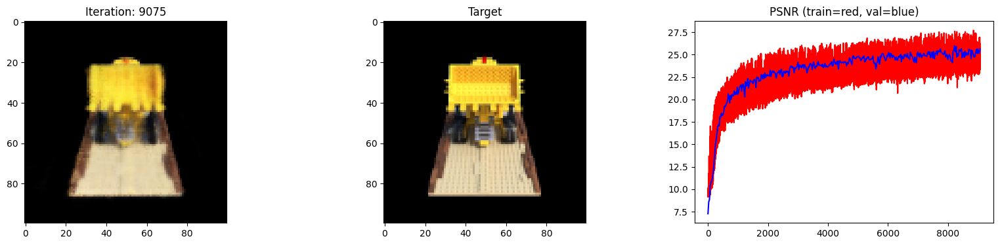

 91%|█████████ | 9100/10000 [1:10:41<06:28,  2.32it/s]

Loss: 0.0030527578201144934


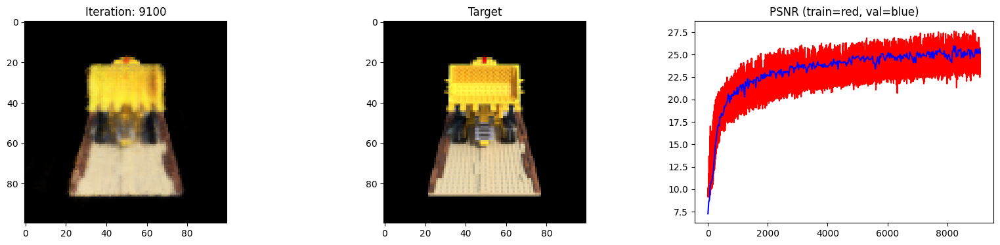

 91%|█████████▏| 9125/10000 [1:10:53<06:17,  2.32it/s]

Loss: 0.002945234766229987


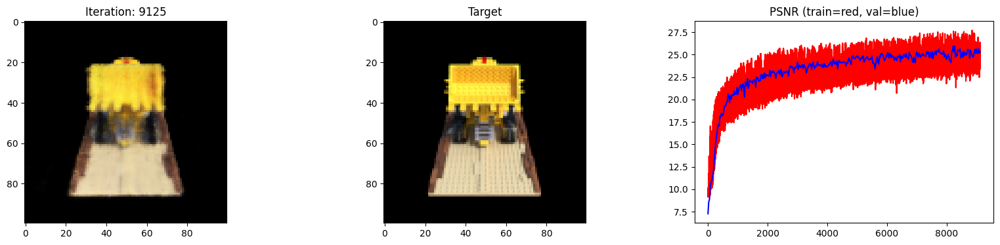

 92%|█████████▏| 9150/10000 [1:11:05<06:07,  2.31it/s]

Loss: 0.003489494090899825


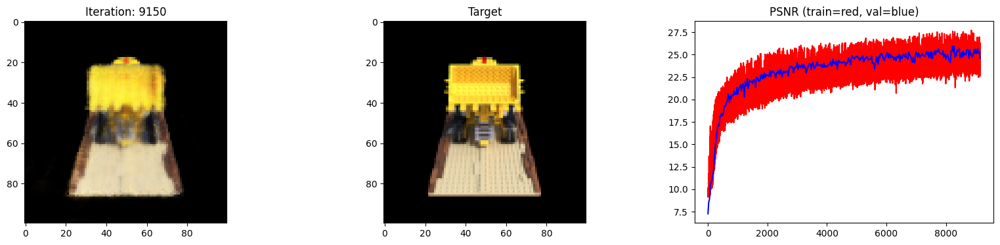

 92%|█████████▏| 9175/10000 [1:11:17<05:55,  2.32it/s]

Loss: 0.0033008072059601545


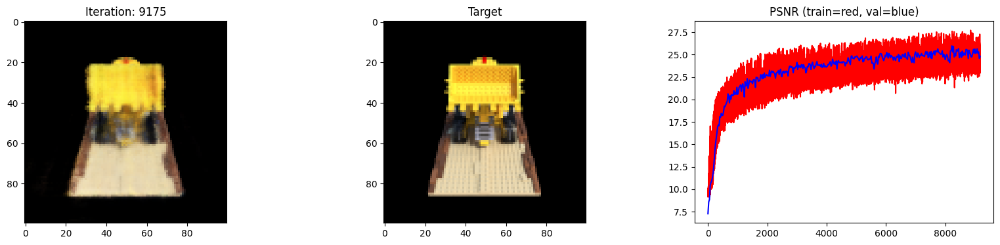

 92%|█████████▏| 9200/10000 [1:11:28<05:43,  2.33it/s]

Loss: 0.002954404568299651


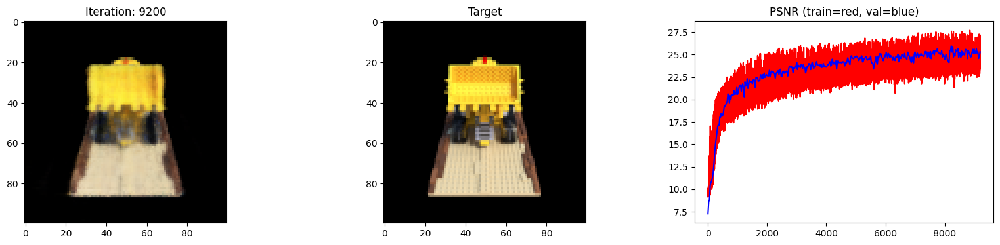

 92%|█████████▏| 9225/10000 [1:11:40<05:34,  2.32it/s]

Loss: 0.0026025548577308655


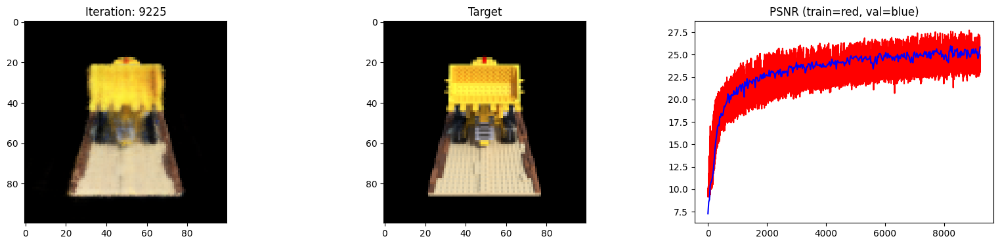

 92%|█████████▎| 9250/10000 [1:11:52<05:23,  2.32it/s]

Loss: 0.0030046359170228243


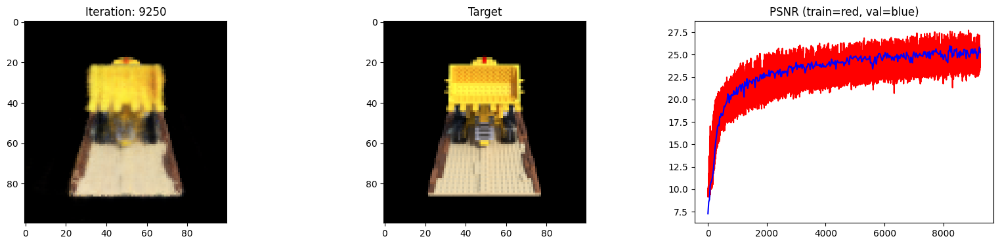

 93%|█████████▎| 9275/10000 [1:12:04<05:12,  2.32it/s]

Loss: 0.0027350077871233225


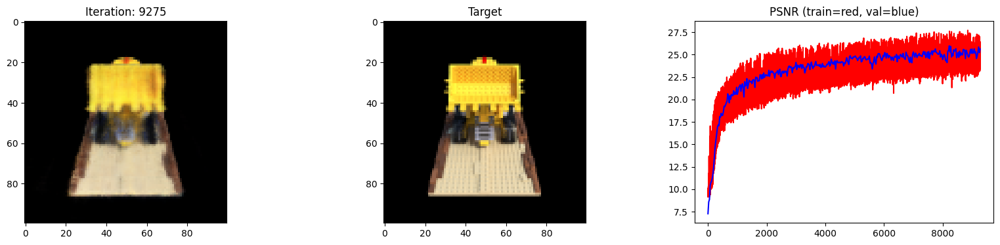

 93%|█████████▎| 9300/10000 [1:12:16<05:02,  2.31it/s]

Loss: 0.0031822032760828733


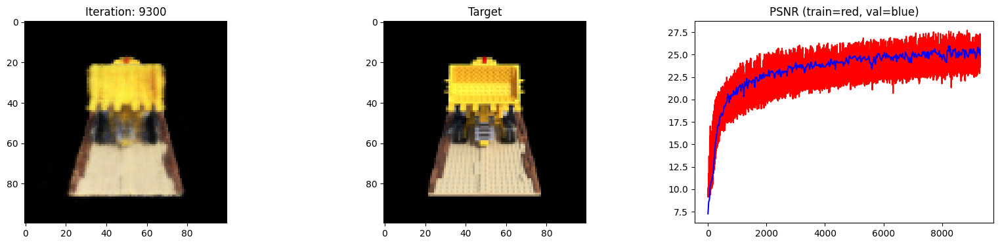

 93%|█████████▎| 9325/10000 [1:12:27<04:51,  2.31it/s]

Loss: 0.0030939325224608183


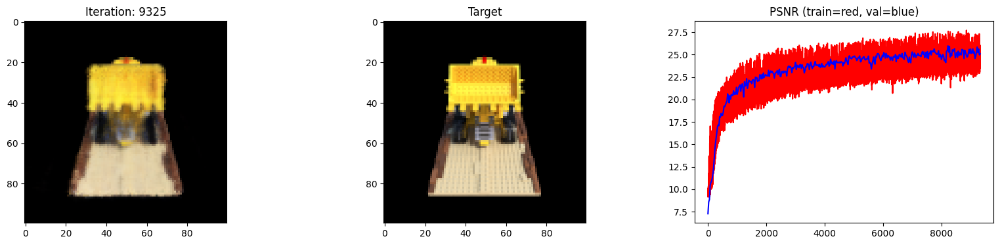

 94%|█████████▎| 9350/10000 [1:12:39<04:40,  2.32it/s]

Loss: 0.003036833368241787


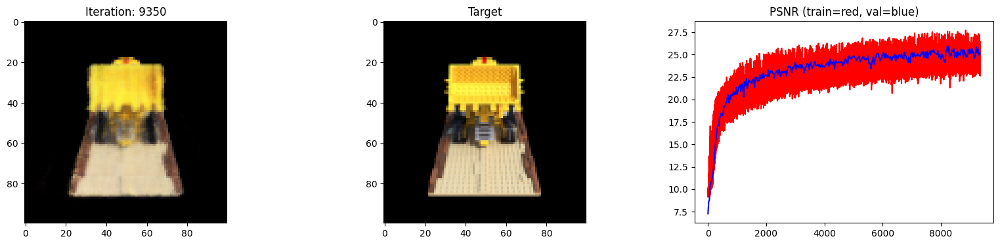

 94%|█████████▍| 9375/10000 [1:12:51<04:28,  2.33it/s]

Loss: 0.0038036121986806393


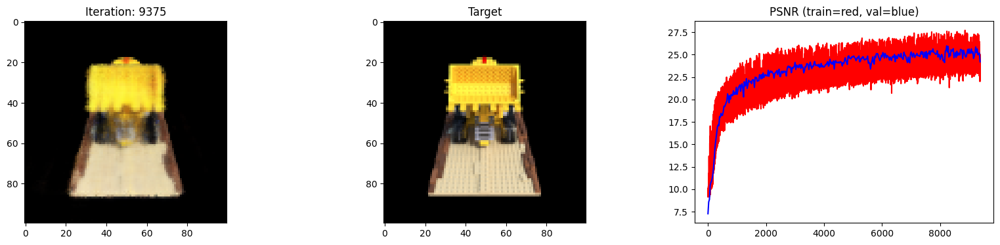

 94%|█████████▍| 9400/10000 [1:13:03<04:17,  2.33it/s]

Loss: 0.0030107179190963507


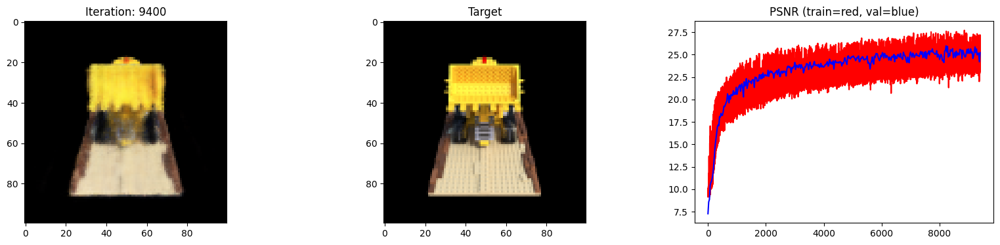

 94%|█████████▍| 9425/10000 [1:13:15<04:07,  2.32it/s]

Loss: 0.002720099641010165


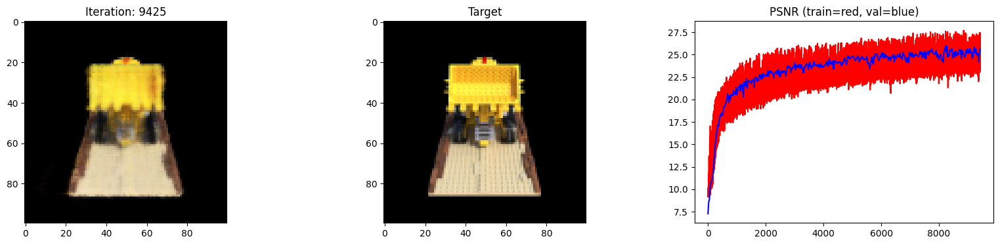

 94%|█████████▍| 9450/10000 [1:13:27<03:57,  2.32it/s]

Loss: 0.0027514875400811434


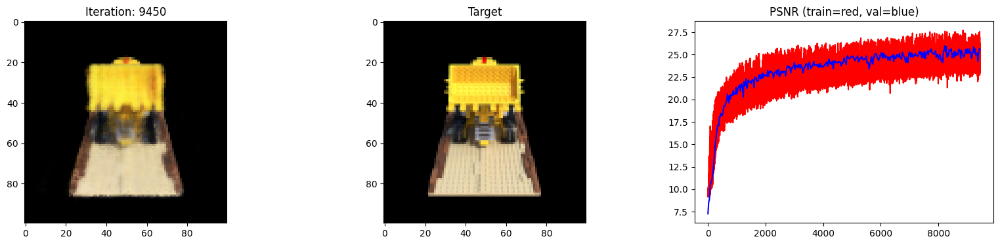

 95%|█████████▍| 9475/10000 [1:13:38<03:47,  2.31it/s]

Loss: 0.0027103163301944733


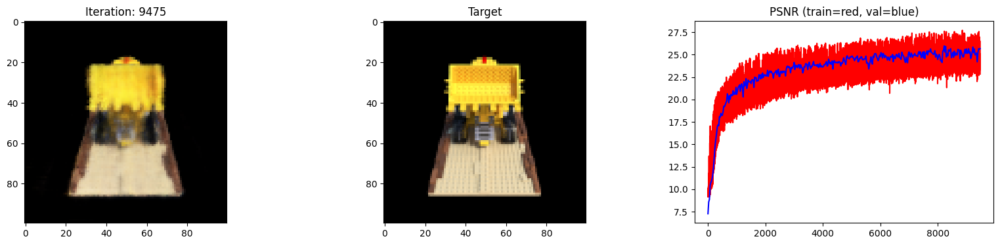

 95%|█████████▌| 9500/10000 [1:13:50<03:35,  2.32it/s]

Loss: 0.0030180884059518576


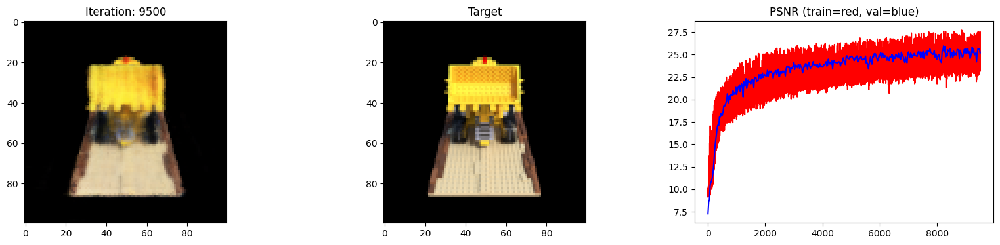

 95%|█████████▌| 9525/10000 [1:14:02<03:24,  2.32it/s]

Loss: 0.0030172590631991625


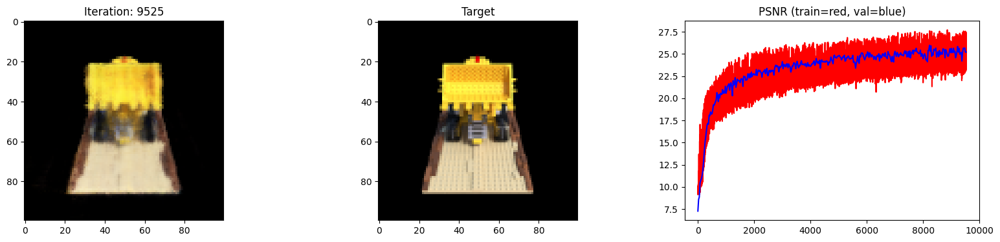

 96%|█████████▌| 9550/10000 [1:14:14<03:13,  2.32it/s]

Loss: 0.002891596406698227


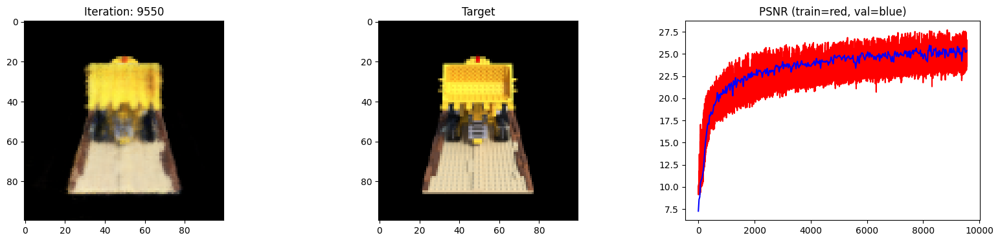

 96%|█████████▌| 9575/10000 [1:14:26<03:03,  2.32it/s]

Loss: 0.002620667451992631


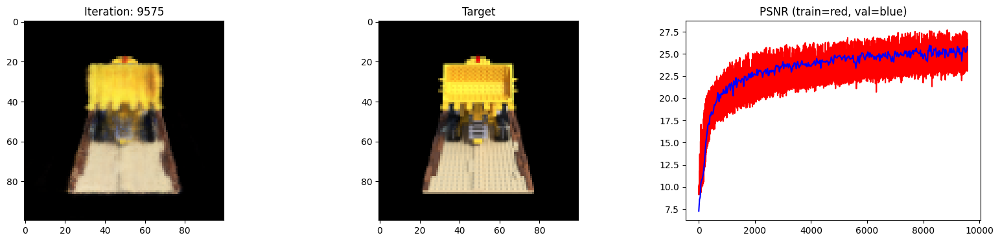

 96%|█████████▌| 9600/10000 [1:14:38<02:54,  2.29it/s]

Loss: 0.0035040497314184904


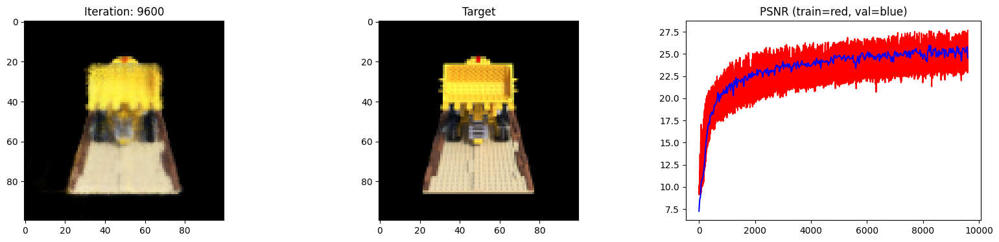

 96%|█████████▋| 9625/10000 [1:14:49<02:42,  2.31it/s]

Loss: 0.0029345215298235416


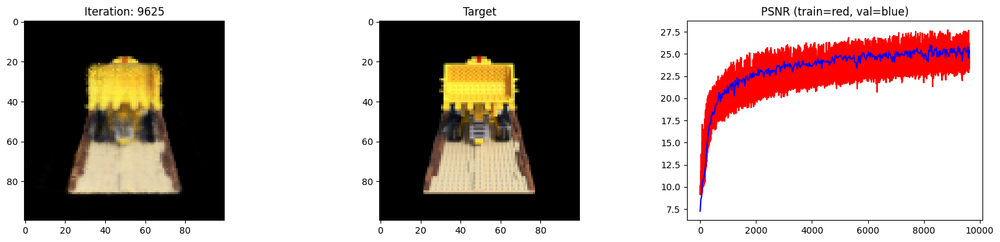

 96%|█████████▋| 9650/10000 [1:15:01<02:30,  2.32it/s]

Loss: 0.0031221567187458277


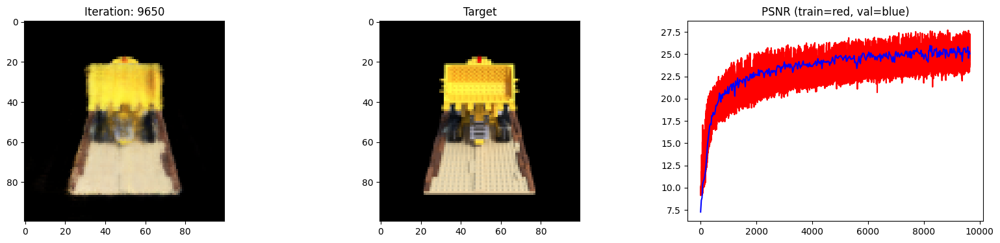

 97%|█████████▋| 9675/10000 [1:15:13<02:20,  2.32it/s]

Loss: 0.003486303146928549


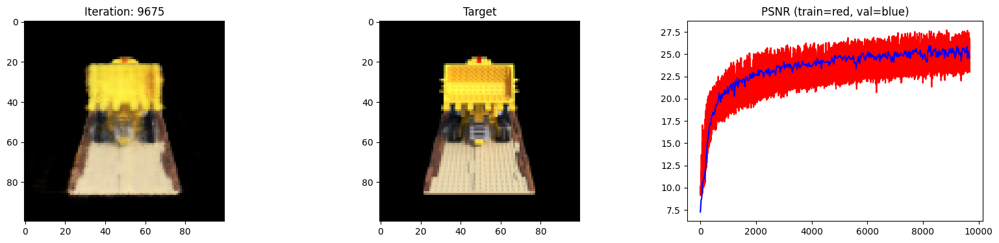

 97%|█████████▋| 9700/10000 [1:15:25<02:09,  2.32it/s]

Loss: 0.0030276102479547262


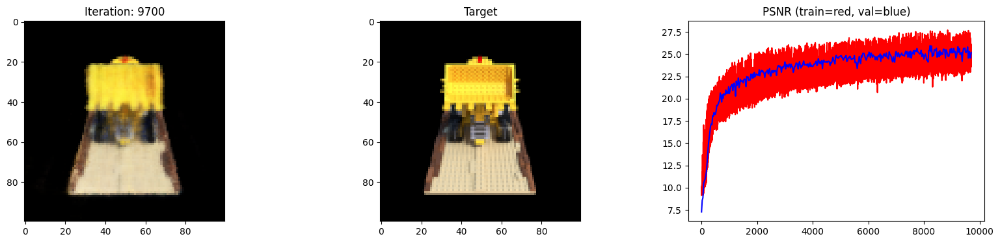

 97%|█████████▋| 9725/10000 [1:15:37<01:58,  2.32it/s]

Loss: 0.0030959814321249723


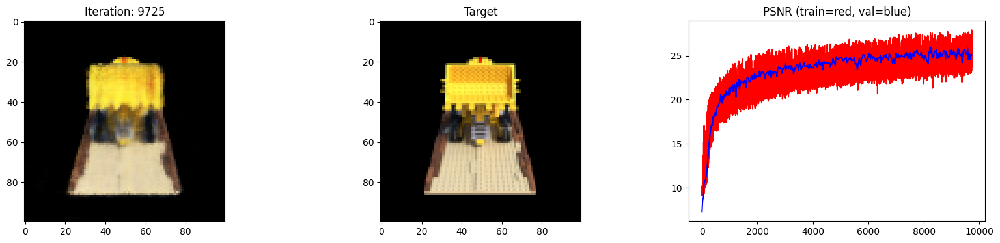

 98%|█████████▊| 9750/10000 [1:15:49<01:48,  2.31it/s]

Loss: 0.002745677251368761


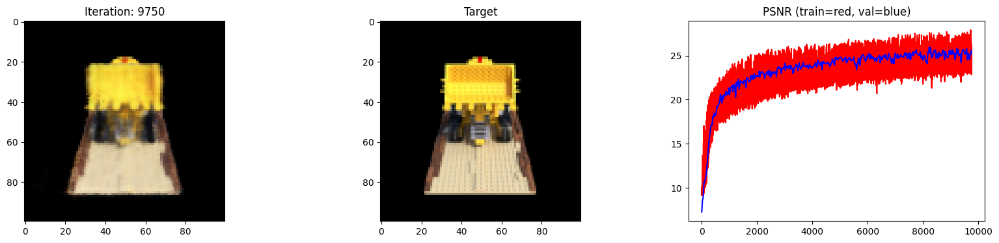

 98%|█████████▊| 9775/10000 [1:16:00<01:37,  2.30it/s]

Loss: 0.0029474778566509485


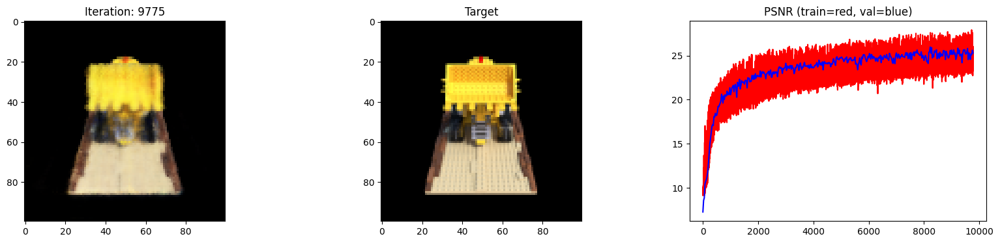

 98%|█████████▊| 9800/10000 [1:16:12<01:26,  2.31it/s]

Loss: 0.0027152106631547213


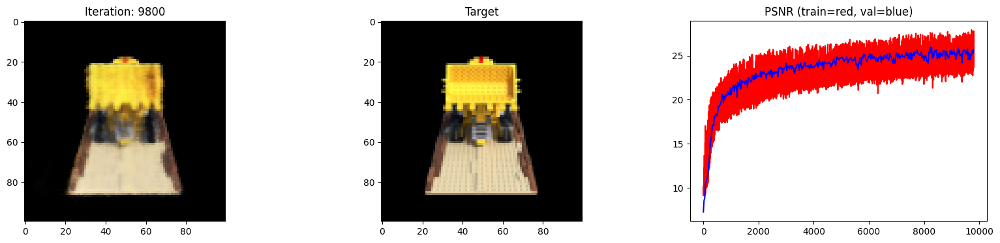

 98%|█████████▊| 9825/10000 [1:16:24<01:15,  2.32it/s]

Loss: 0.0025877337902784348


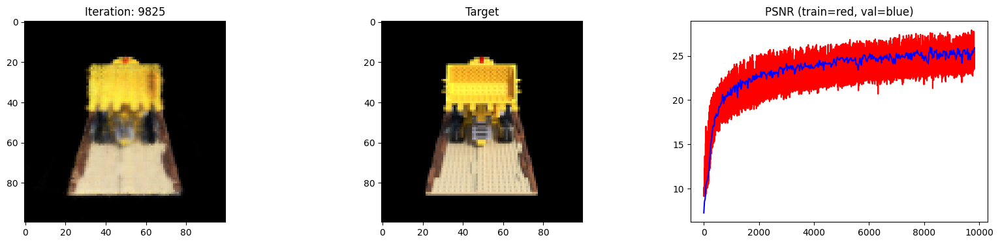

 98%|█████████▊| 9850/10000 [1:16:36<01:04,  2.32it/s]

Loss: 0.0030306470580399036


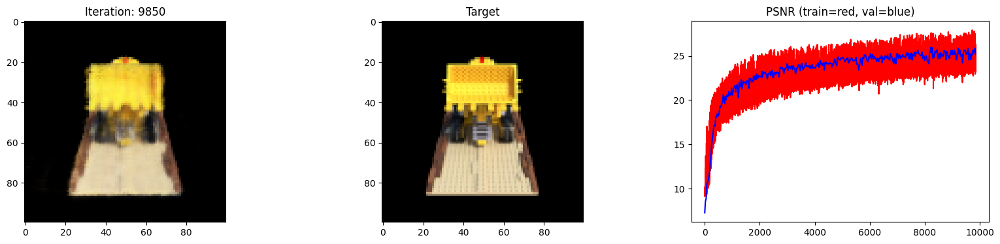

 99%|█████████▉| 9875/10000 [1:16:48<00:54,  2.31it/s]

Loss: 0.0028121713548898697


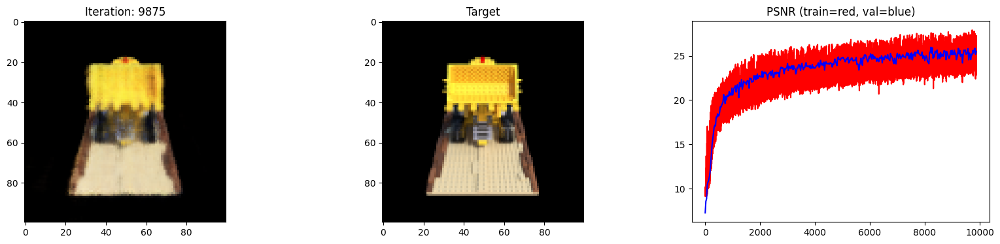

 99%|█████████▉| 9900/10000 [1:16:59<00:43,  2.32it/s]

Loss: 0.003064428223297


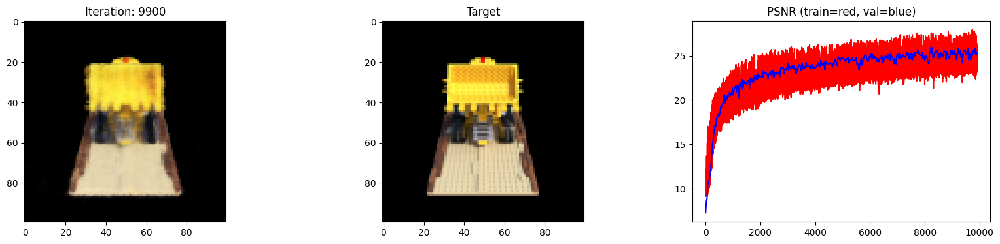

 99%|█████████▉| 9925/10000 [1:17:11<00:32,  2.31it/s]

Loss: 0.0027823736891150475


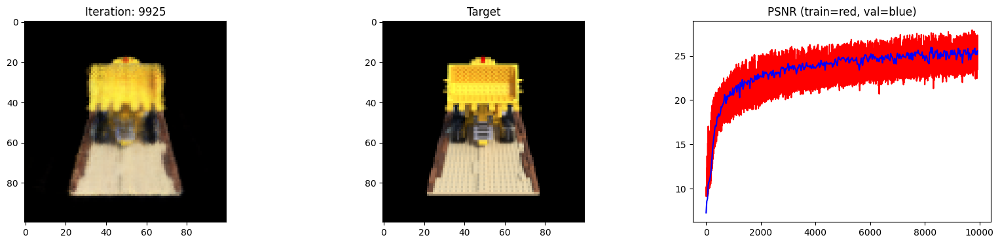

100%|█████████▉| 9950/10000 [1:17:23<00:21,  2.32it/s]

Loss: 0.00273688230663538


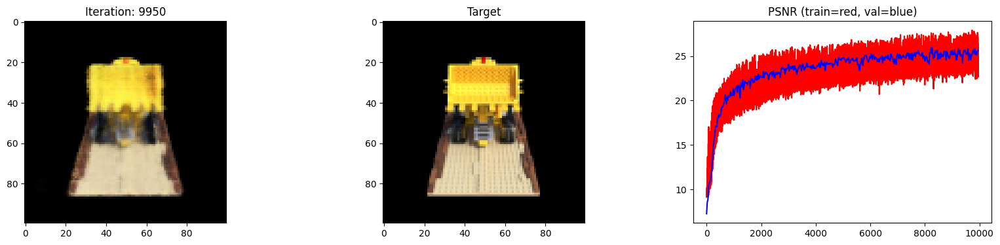

100%|█████████▉| 9975/10000 [1:17:35<00:10,  2.32it/s]

Loss: 0.0026267163921147585


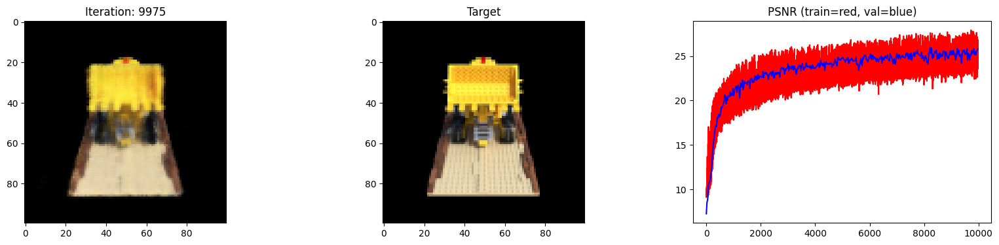

100%|██████████| 10000/10000 [1:17:47<00:00,  2.14it/s]

Training successful!

Done!


In [23]:
# Training session
for _ in range(n_restarts):
  model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper = init_models()
  success, train_psnrs, val_psnrs = train()
  if success and val_psnrs[-1] >= warmup_min_fitness:
    print('Training successful!')
    break

print('')
print(f'Done!')

In [27]:
torch.save(model.state_dict(), 'nerf.pt')
torch.save(fine_model.state_dict(), 'nerf-fine.pt')